In [1]:
import matplotlib.pyplot as plt
import numpy as np
import scipy
import os
import pandas as pd
import pickle

In [2]:
def get_scardec_stf(scardec_name, wanted_type = 'fctopt'):
    time = []
    momentrate = []

    event = os.listdir(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}')
    starts = [n for n, l in enumerate(event) if l.startswith(wanted_type)]
    with open(f'/home/earthquakes1/homes/Rebecca/phd/stf/data/scardec/{scardec_name}/{event[starts[0]]}') as f:
        lines = f.read().splitlines()

    lines = lines[2:]
    for line in lines:
        split = line.split(' ')
        split = [s for s in split if s not in ['', ' ', '\n']]
        time.append(float(split[0]))
        momentrate.append(float(split[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [3]:
def get_ye_stf(ye_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/Ye_et_al_2016/'
    momentrate = []
    time = []

    with open(data_path + str(ye_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))
    momentrate = np.array(momentrate)
    time = np.array(time)
    return momentrate, time

In [4]:
def get_usgs_stf(usgs_name):
    data_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/USGS/'
    momentrate = []
    time = []

    with open(data_path + str(usgs_name), 'r') as f:
        data = f.readlines()
        for line in data:
            line = line.strip()
            line = line.rstrip()
            if line[0] not in ['0','1','2','3','4','5','6','7','8','9']:
                continue
            line = line.split()
            time.append(float(line[0]))
            momentrate.append(float(line[1]))

    momentrate = np.array(momentrate)
    time = np.array(time)

    momentrate = momentrate / 10**7 # convert to Nm from dyne cm
    return momentrate, time

In [5]:
def get_sigloch_stf(sigloch_name):
    data_path = '/home/siglochnas1/shared/AmplitudeProjects/pdata_processed/psdata_events/'
    momentrate = []
    time = []

    file_path = data_path + str(sigloch_name) + '/outfiles/ampinv.stf.xy'

    with open(file_path, 'r') as file:
        content = file.read()
        content = content.split('\n')
        greater_than_count = content.count('>')
        if greater_than_count > 0:
            time = [[]]
            momentrate = [[]]
            for i in range(greater_than_count-1):
                time.append([])
                momentrate.append([])


        stf_count = 0
        for c in content:
            if c not in ['<', '>', '']:
                split = c.split()
                time[stf_count].append(float(split[0]))
                momentrate[stf_count].append(float(split[1]))
            else:
                stf_count += 1
    return momentrate, time

In [6]:
def load_isc(isc_name):
    isc_save_path = '/home/earthquakes1/homes/Rebecca/phd/stf/data/isc/'
    with open(f'{isc_save_path}{isc_name}/{isc_name}.txt', 'rb') as f:
        stf_list = pickle.load(f)
    with open(f'{isc_save_path}{isc_name}/{isc_name}_norm_info.txt', 'rb') as f:
        norm_dict = pickle.load(f)

    time = np.arange(0, 25.6, 0.1)
    momentrate = np.array(stf_list)*norm_dict['mo_norm']*10**8,
    return momentrate, time

In [7]:
combined = pd.read_csv('/home/earthquakes1/homes/Rebecca/phd/stf/data/combined_scardec_ye_usgs_sigloch_isc_mag.csv')

In [8]:
combined.columns = ['event', 'scardec', 'ye', 'isc', 'sigloch', 'usgs', 'mag']

In [9]:
def plot_stf(ax, time, momentrate, detected_end_time, linecolor = 'k', linestyle = '--', label_str = '', plot_bar = True):
    ax.plot(time, momentrate, color=linecolor, label = label_str + ' STF' )
    if plot_bar is True:
        ax.axhline(max(momentrate)/10, color='#ffa600')
        ax.fill_between(time, 0, 10*max(momentrate)/100, facecolor='#ffa600', alpha=0.1)

    ax.fill_between(time, momentrate, 0, where=momentrate>0, facecolor=linecolor, alpha=0.05)

    # ax.axvline(detected_end_time, color=linecolor, linestyle=linestyle, label = label_str + ' (3) end')

    ax.set_ylim(0, 1.1*max(momentrate))
    ax.set_xlim(0, max(time))

    ax.legend()

    return ax


In [10]:
def find_end_stf(momentrate, time):
    not_zero = np.where(momentrate > 0)[0]
    #print(max(momentrate))
    start = min(not_zero)
    end = max(not_zero)

    detected_end = end
    detected_end_time = time[end]

    time = time[:end]
    momentrate = momentrate[:end]

    less_than_10 = np.where(momentrate <= 10*max(momentrate)/100)[0]
    #print(less_than_10)
    print(start)
    total_moment = scipy.integrate.simpson(momentrate[start:end],
                                        dx = time[start+1]-time[start])
    #print(less_than_10)
    for i in less_than_10:
        if i <= start:
            continue
        if i == 0:
            continue
        moment = scipy.integrate.simpson(momentrate[start:i],
                                        dx = time[start+1]-time[start])
        #print(i, moment/total_moment)
        if moment >= 0.5 * total_moment:
            #print('inif')
            #print(f'first time where < 10% of total momentrate and 50% of moment released: {time[i]} s')
            detected_end_time = time[i]
            detected_end = i
            #print(f'proportion of moment released: {(moment/total_moment)*100:.2f}%')
            break
    return detected_end_time, detected_end, time[start], start
    #return time[end], end

In [11]:
def find_99_end_stf(momentrate, time):
    not_zero = np.where(momentrate > 0)[0]
    #print(max(momentrate))
    start = min(not_zero)
    end = max(not_zero)

    detected_end = end
    detected_end_time = time[end]

    time = time[:end]
    momentrate = momentrate[:end]

    less_than_10 = np.where(momentrate <= 10*max(momentrate)/100)[0]
    print(less_than_10)
    print(start)
    total_moment = scipy.integrate.simpson(momentrate[start:end],
                                        dx = time[start+1]-time[start])
    #print(less_than_10)
    for i in less_than_10:
        if i <= start:
            continue
        if i == 0:
            continue
        moment = scipy.integrate.simpson(momentrate[start:i],
                                        dx = time[start+1]-time[start])
        #print(i, moment/total_moment)
        if moment >= 0.99 * total_moment:
            #print('inif')
            #print(f'first time where < 10% of total momentrate and 50% of moment released: {time[i]} s')
            detected_end_time = time[i]
            detected_end = i
            #print(f'proportion of moment released: {(moment/total_moment)*100:.2f}%')
            break

    return detected_end_time, detected_end, time[start], start
    #return time[end], end

In [12]:
def find_zero_end_stf(momentrate, time):
    not_zero = np.where(momentrate > 0)[0]
    #print(max(momentrate))
    start = min(not_zero)
    end = max(not_zero)

    detected_end = end
    detected_end_time = time[end]

    return detected_end_time, detected_end, time[start], start
    #return time[end], end

event                                       20170818_0259
scardec    FCTs_20170818_025925_NORTH_OF_ASCENSION_ISLAND
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 6.591
Name: 0, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 303 304 305 306 307 308 309 310 311 312 313 314 315 3

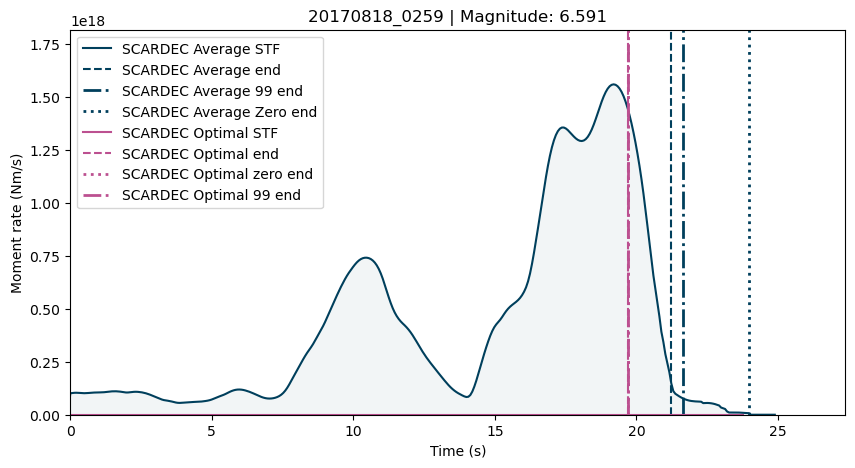

event                                         20110126_1542
scardec    FCTs_20110126_154229_NORTHERN_SUMATRA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                     0706.2011.026.a
usgs                                                      0
mag                                                   6.114
Name: 1, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43 179 180 181 182 183 184 185 186 187 188
 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224
 225 226 227 228 229 230 231 232 233 234 235 236]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  

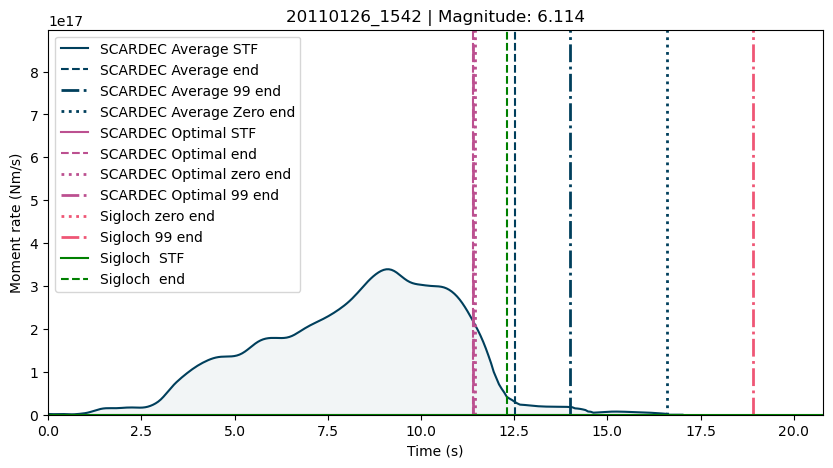

event                                          19981010_1629
scardec    FCTs_19981010_162908_MINAHASSA_PENINSULA__SULA...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.927
Name: 2, dtype: object
13
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116
 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134
 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170
 171 172 173 174 175 176 177 178]
13
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
12.0937

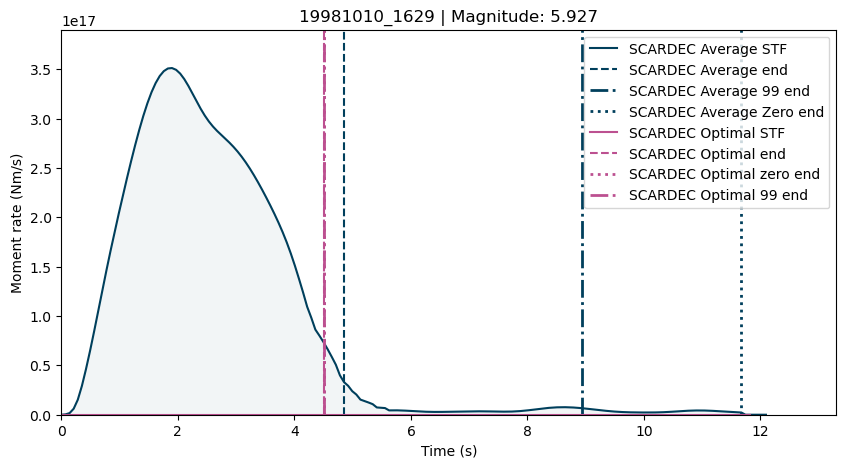

event                    19920730_0824
scardec    FCTs_19920730_082446_XIZANG
ye                                   0
isc                                  0
sigloch                              0
usgs                                 0
mag                              6.017
Name: 3, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39 101 102 103 104 105]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 35 36 37 38
 39]
17
8.296875


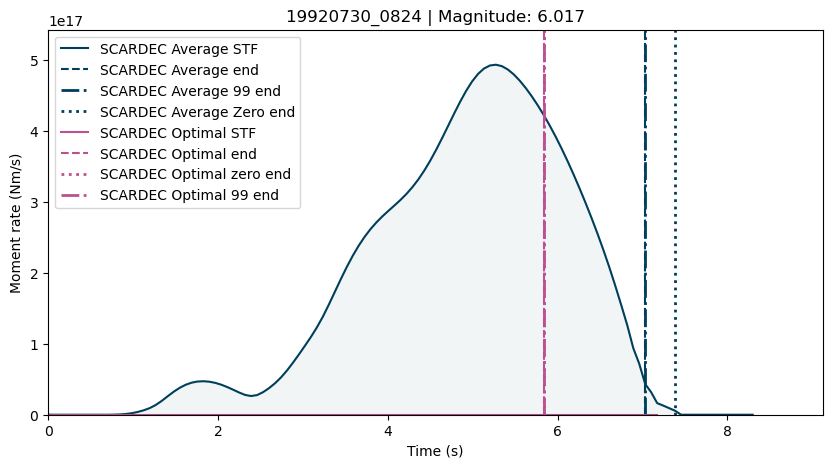

event                                     19960327_2052
scardec    FCTs_19960327_205206_NEAR_COAST_OF_NICARAGUA
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.157
Name: 4, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 296 297 298 299 300 301]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 151 152 153 154 155 156 157 158 159]
17
25.3125


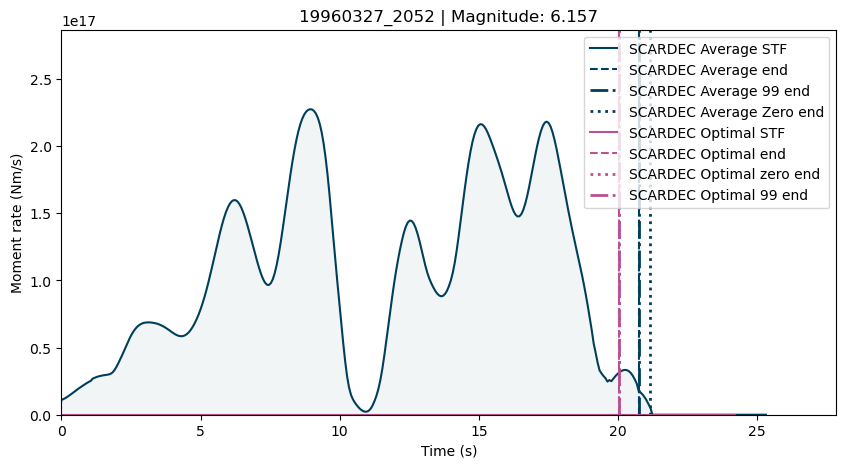

event                                      20011012_1502
scardec    FCTs_20011012_150216_SOUTH_OF_MARIANA_ISLANDS
ye                                                     0
isc                                                    0
sigloch                                  0210.2001.285.a
usgs                                                   0
mag                                               6.9675
Name: 5, dtype: object
11
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194
 195 196 197 198]
11
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 123 124]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  33  34  35  36 

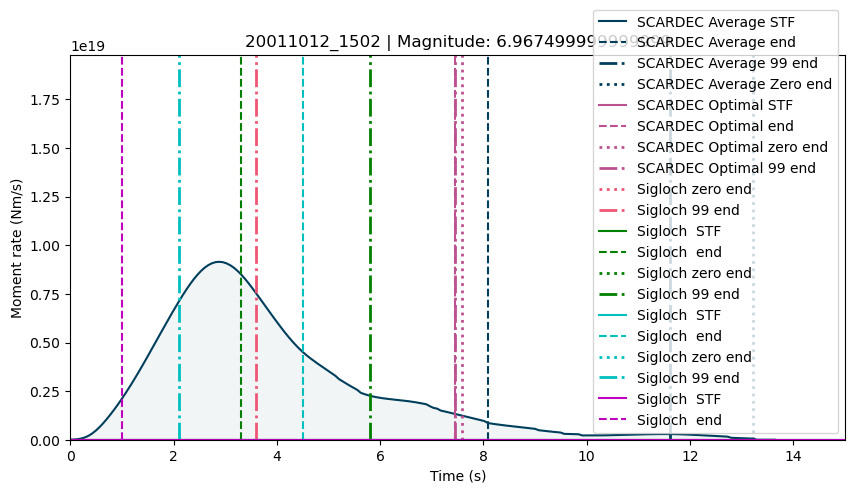

event                                         19960212_0908
scardec    FCTs_19960212_090807_SOUTH_OF_SUMBAWA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.193
Name: 6, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 216 217 218 219 220]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126]


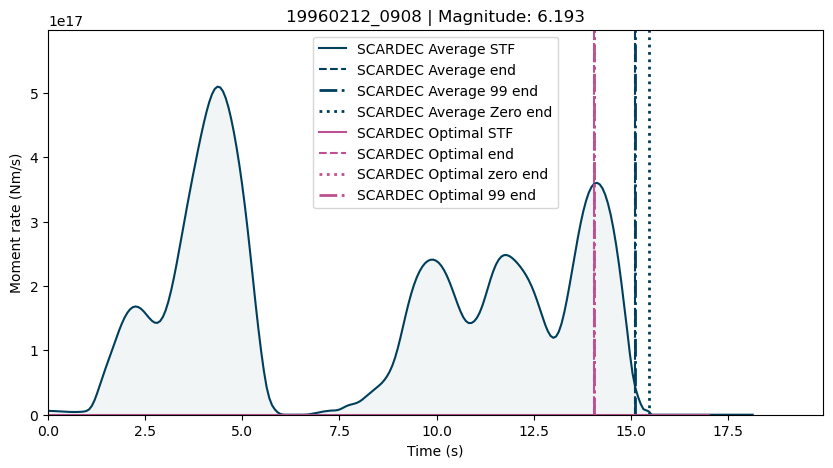

event                                          20120320_1802
scardec    FCTs_20120320_180247_NEAR_COAST_OF_GUERRERO__M...
ye                               201203201802_Mexico.mrf.txt
isc                                                        0
sigloch                                      0058.2012.080.a
usgs                                     20120320_180247.txt
mag                                                    7.387
Name: 7, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 180 181 182 183 184 185 186 187 188
 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24 188 189]
17
1
[ 0 31 32 33 34 35 36 37 38]
1
1
[  0   1   2   3   4   5   6   7  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81

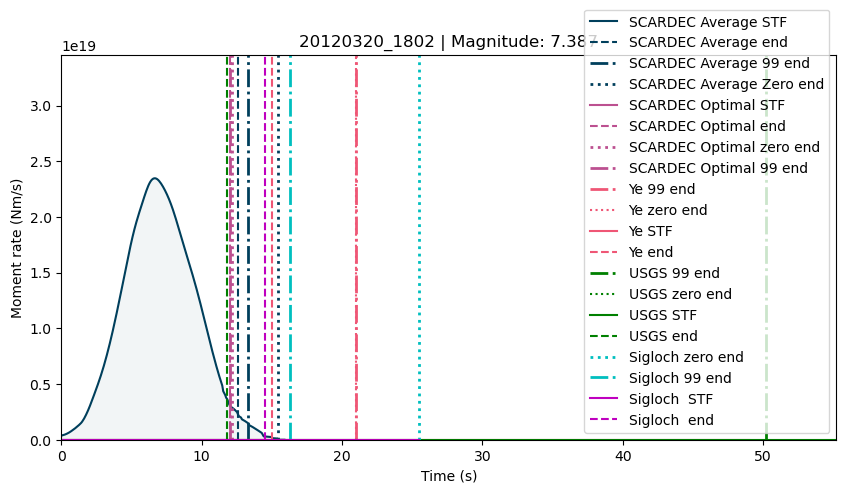

event                             20070402_1202
scardec    FCTs_20070402_120223_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                         0193.2007.092.b
usgs                                          0
mag                                      6.2195
Name: 8, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 79 80 81 82
 83 84 85 86 87 88 89 90 91 92 93 94 95]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 81 82 83 84
 85 86]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  28  29
  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47
  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 

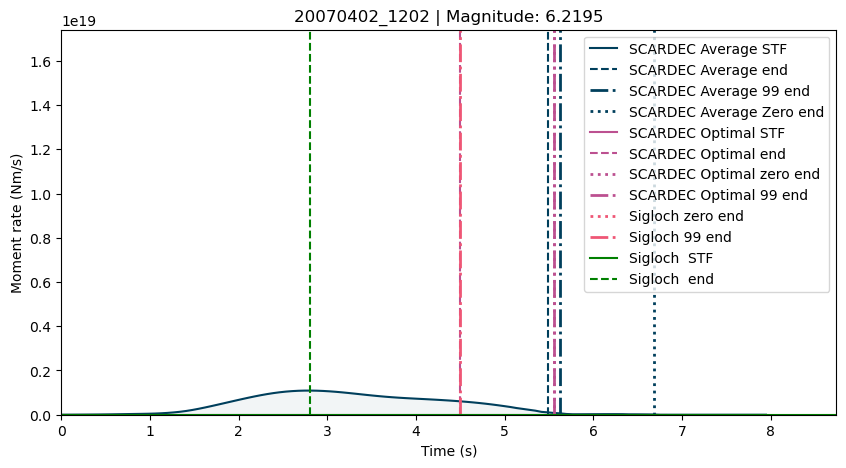

event                             20070427_1349
scardec    FCTs_20070427_134928_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                         5.8
Name: 9, dtype: object
14
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47 102 103 104 105 106 107
 108 109 110 111]
14
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 31 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]
17
7.59375


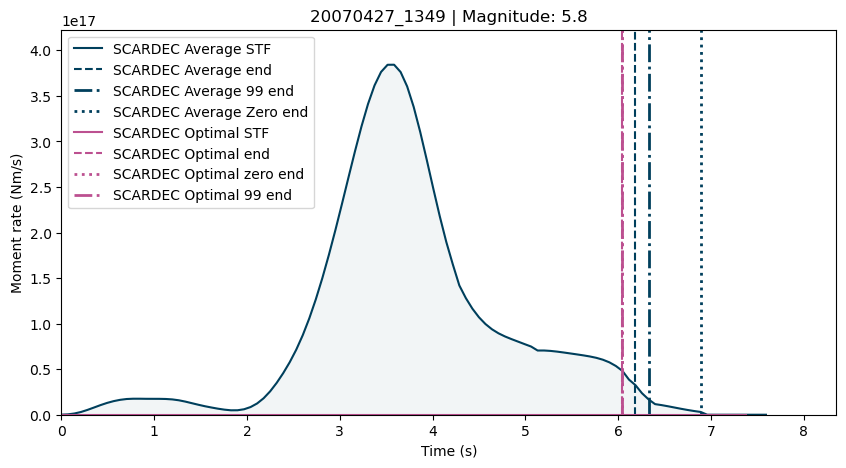

event                           20140904_0533
scardec    FCTs_20140904_053350_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                       0173.2014.247.a
usgs                                        0
mag                                    5.9965
Name: 10, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128 129 130]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  4

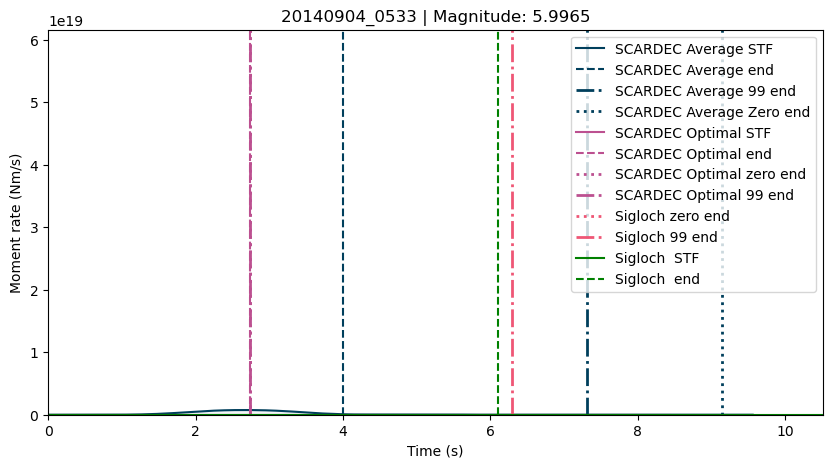

event                                 20040715_0427
scardec    FCTs_20040715_042714_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                             0181.2004.197.a
usgs                                              0
mag                                          7.0725
Name: 11, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  25  26
  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  

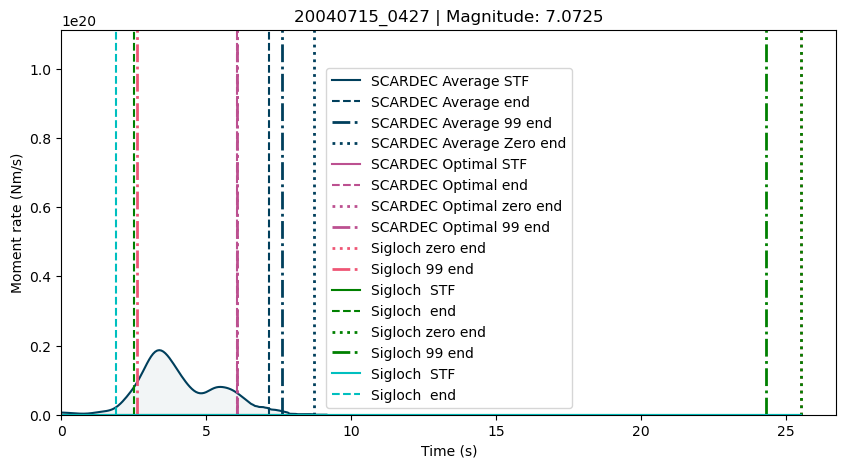

event                                          20080415_2259
scardec    FCTs_20080415_225951_ANDREANOF_ISLANDS__ALEUTI...
ye                                                         0
isc                                                        0
sigloch                                      0007.2008.106.a
usgs                                                       0
mag                                                   6.3925
Name: 12, dtype: object
1
[  0  26  27  28  29  30  31 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59 

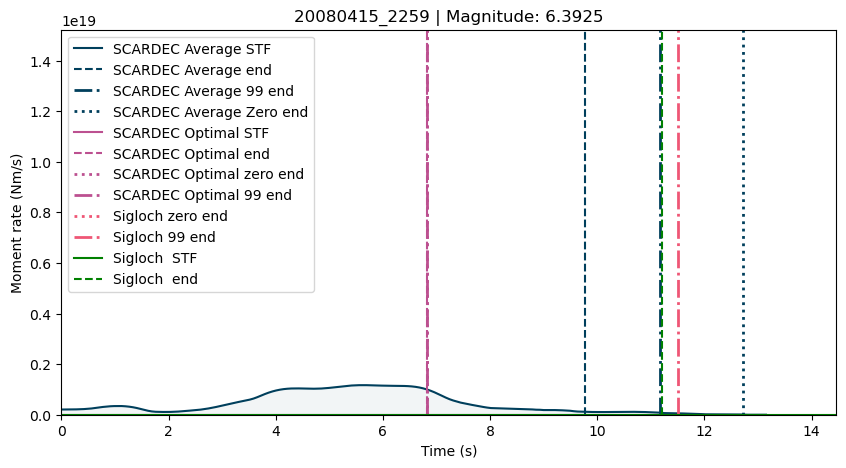

event                             20050505_1912
scardec    FCTs_20050505_191221_SOUTH_OF_PANAMA
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       6.455
Name: 13, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  57  58  59  60  93  94  95  96  97  98  99 100 101 102 103 104
 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122
 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313
 314 315 316 317 318 319 320 321 322 323 324 325 326 3

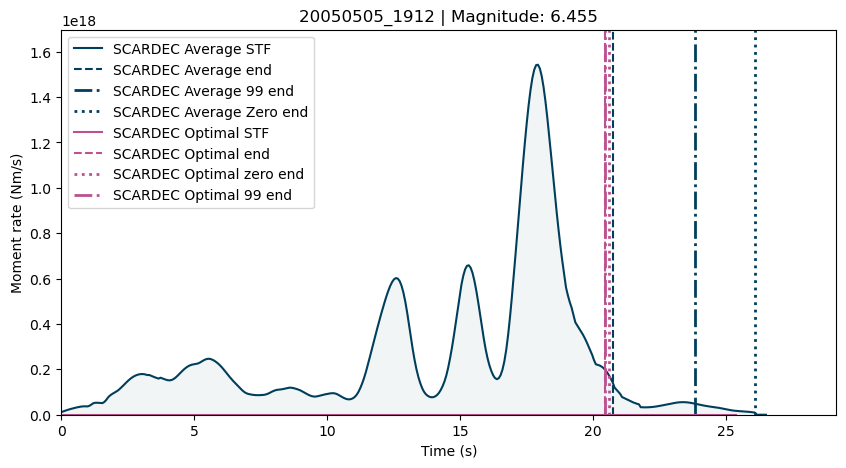

event                       19940713_1145
scardec    FCTs_19940713_114523_BANDA_SEA
ye                                      0
isc                                     0
sigloch                                 0
usgs                                    0
mag                                 6.474
Name: 14, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 57 58 59 60
 61]
17
8.0859375


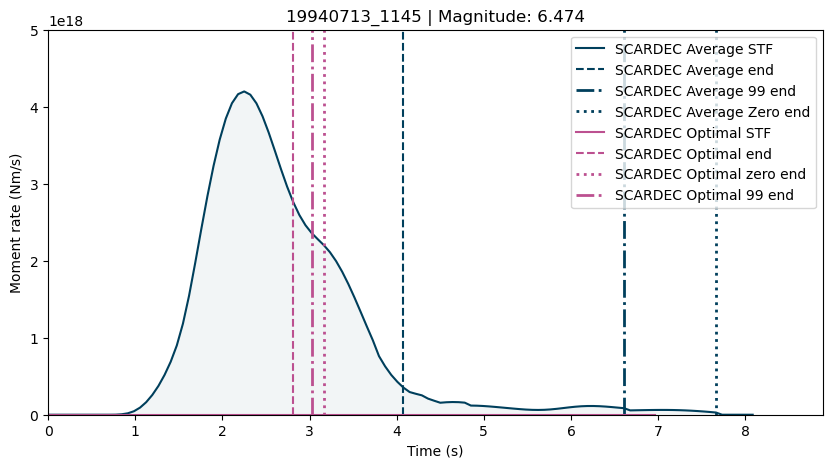

event                                       20111006_1112
scardec    FCTs_20111006_111230_SALTA_PROVINCE__ARGENTINA
ye                                                      0
isc                                                     0
sigloch                                   0129.2011.279.a
usgs                                                    0
mag                                                5.9175
Name: 15, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75
 76 77]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  50  51  52  53  54  55  56  57  58  59  60  61  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105

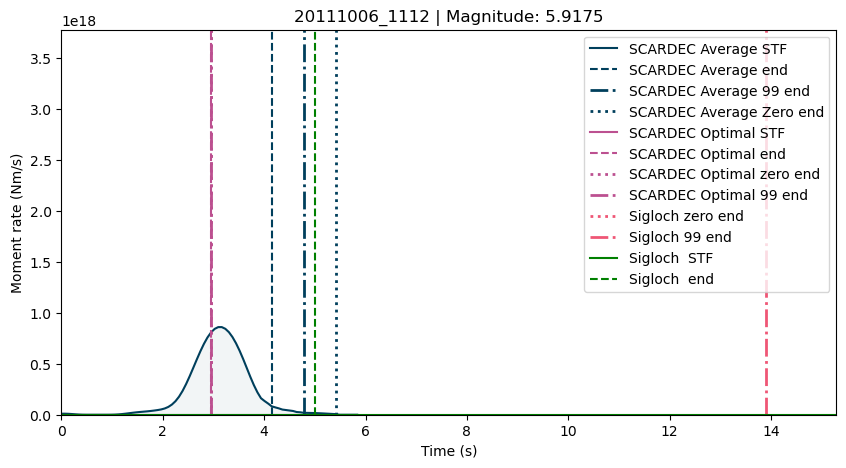

event                                          20030907_1319
scardec    FCTs_20030907_131920_SOUTHEAST_OF_LOYALTY_ISLANDS
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.414
Name: 16, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  20  21  22  23  24 122 123 124
 125 126 127 128 129 130 131 143 144 145 146 147 148 149 150 151 152 219
 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237
 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255
 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273
 274 275 276 277 278 279 280 281 282 283 284]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
20.390625


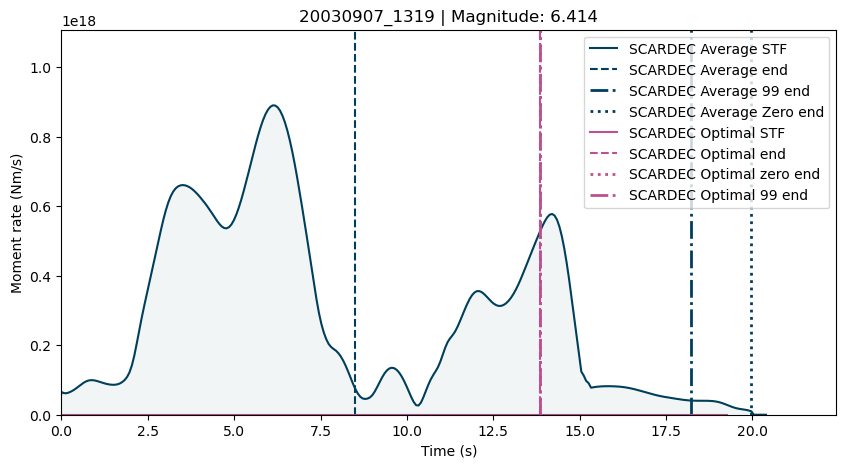

event                             19940713_0235
scardec    FCTs_19940713_023556_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       7.054
Name: 17, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33 247 248
 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310]
1
22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27]
22
22.21875


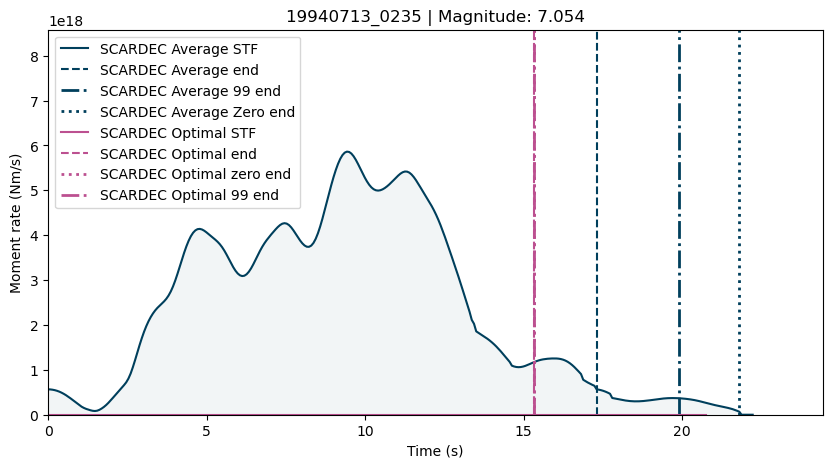

event                                          19980521_2231
scardec    FCTs_19980521_223122_PRINCE_EDWARD_ISLANDS_REGION
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.279
Name: 18, dtype: object
12
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32 180 181 182
 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198]
12
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
14.34375


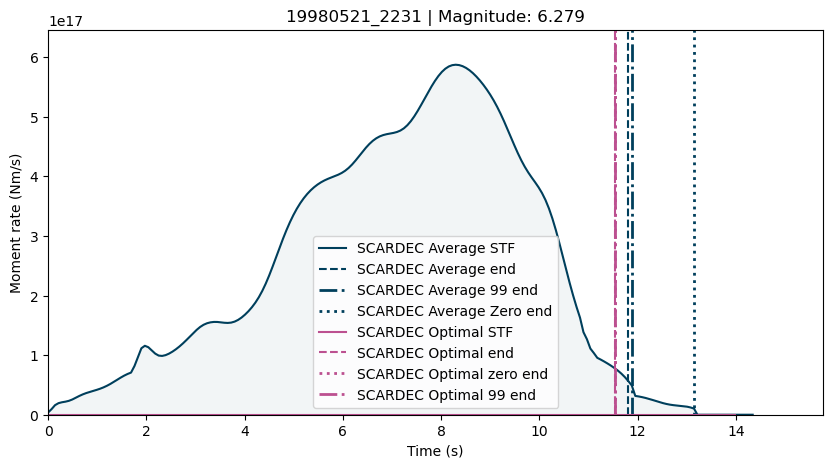

event                       20030825_0628
scardec    FCTs_20030825_062835_GUATEMALA
ye                                      0
isc                                     0
sigloch                   0070.2003.237.a
usgs                                    0
mag                                5.9525
Name: 19, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176 177]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  

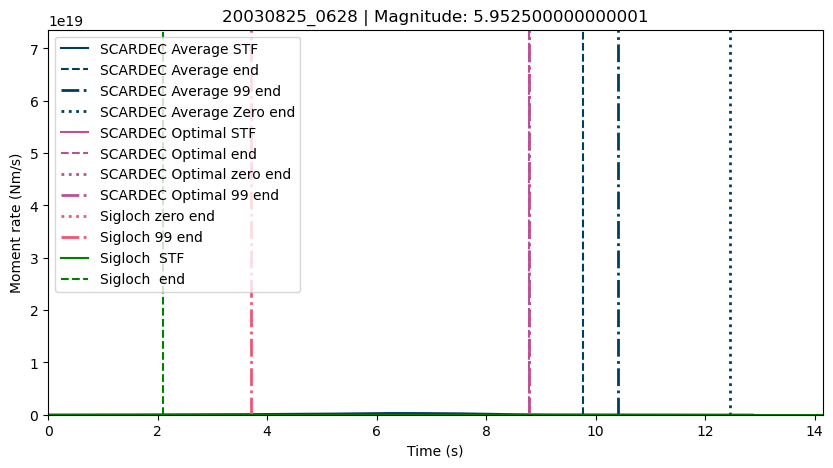

event                                  20060729_1953
scardec    FCTs_20060729_195343_NORTH_ATLANTIC_OCEAN
ye                                                 0
isc                                                0
sigloch                                            0
usgs                                               0
mag                                            5.525
Name: 20, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 46 47]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
3.7265625


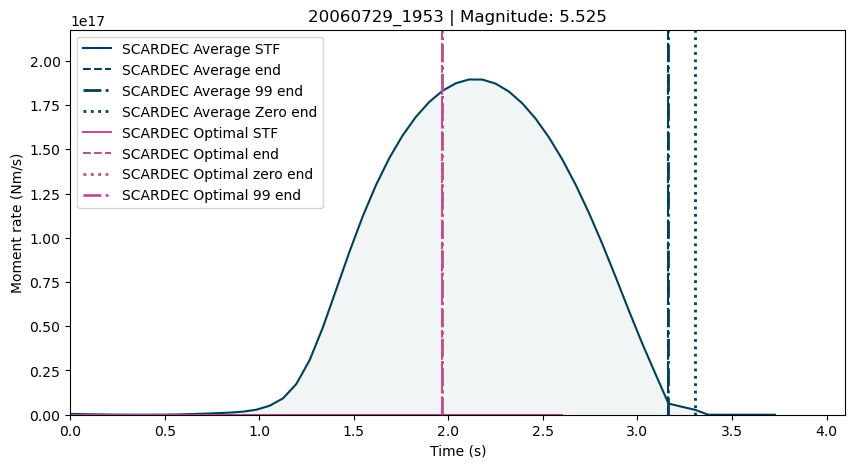

event                             20160407_0332
scardec    FCTs_20160407_033253_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       6.691
Name: 21, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 160]
17
13.640625


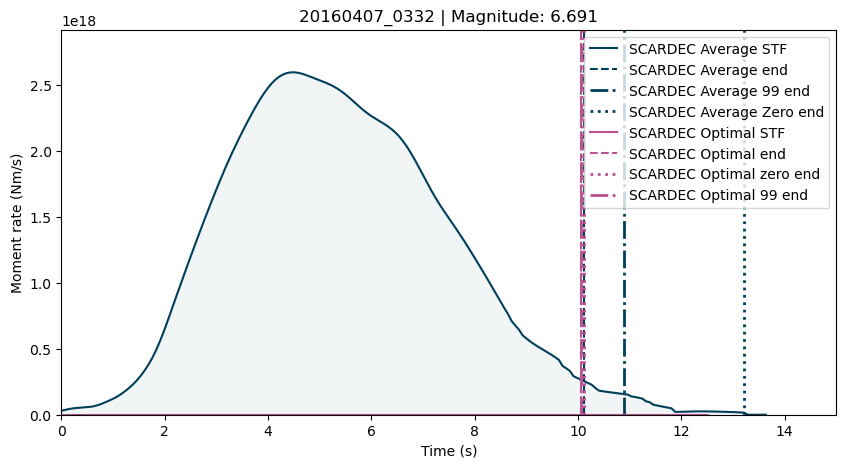

event                           19990508_1944
scardec    FCTs_19990508_194435_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     5.836
Name: 22, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 37 38 39 40 41
 42 43 44 45 46 47 48 49 50]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
3.9375


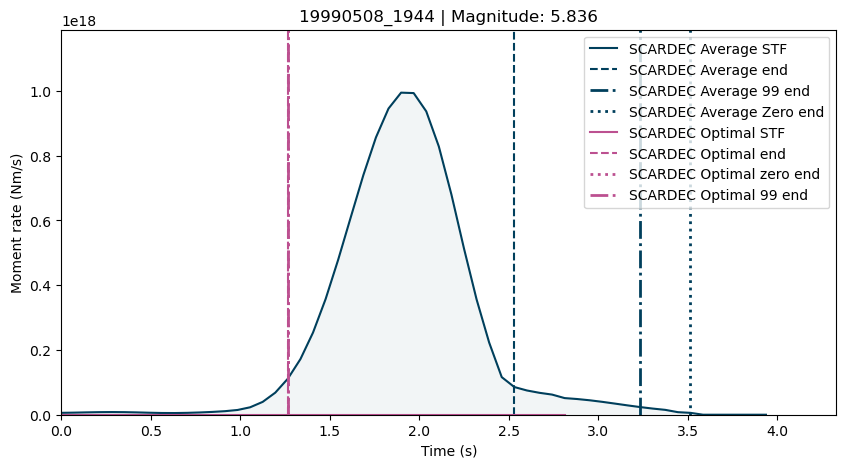

event                                        20181013_1110
scardec    FCTs_20181013_111022_NORTHWEST_OF_KURIL_ISLANDS
ye                                                       0
isc                                                      0
sigloch                                                  0
usgs                                                     0
mag                                                  6.672
Name: 23, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 91]
17
11.33996585


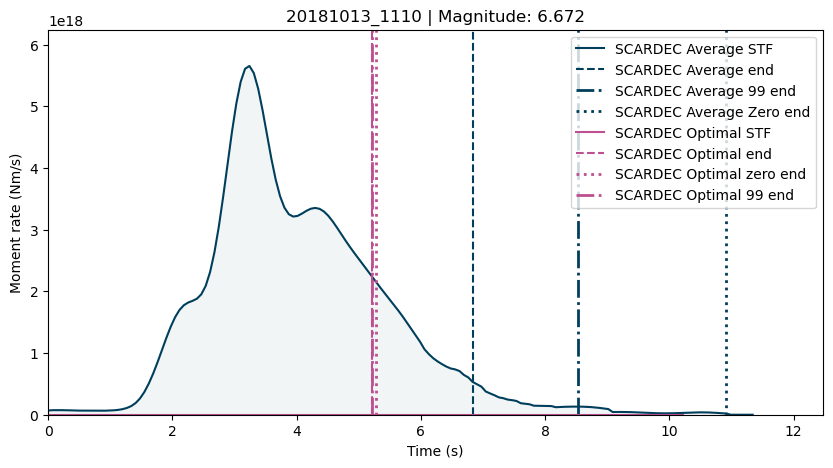

event                                         20150918_1559
scardec    FCTs_20150918_155942_NORTHERN_MID-ATLANTIC_RIDGE
ye                                                        0
isc                                                       0
sigloch                                     0049.2009.217.a
usgs                                                      0
mag                                                6.010667
Name: 24, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 105 106 107 108 109 110 111 112 113 114 115 116]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  

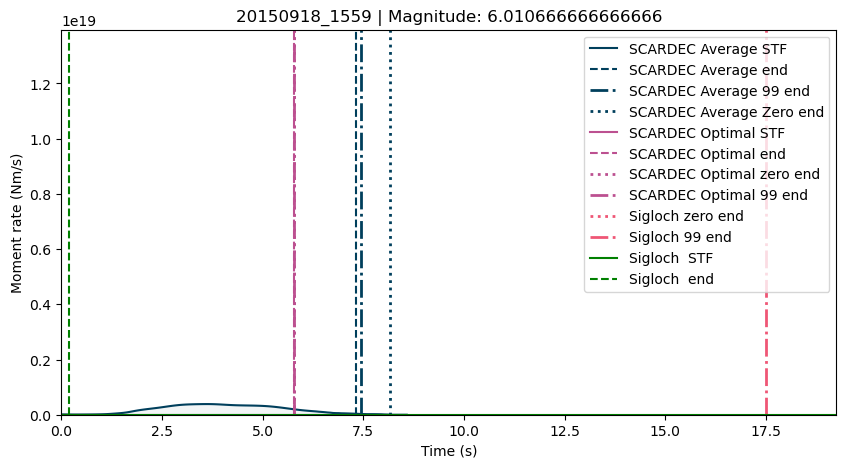

event                           20050726_1411
scardec    FCTs_20050726_141136_SOUTHERN_PERU
ye                                          0
isc                                         0
sigloch                       0117.2005.207.a
usgs                                        0
mag                                     5.891
Name: 25, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  21  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 

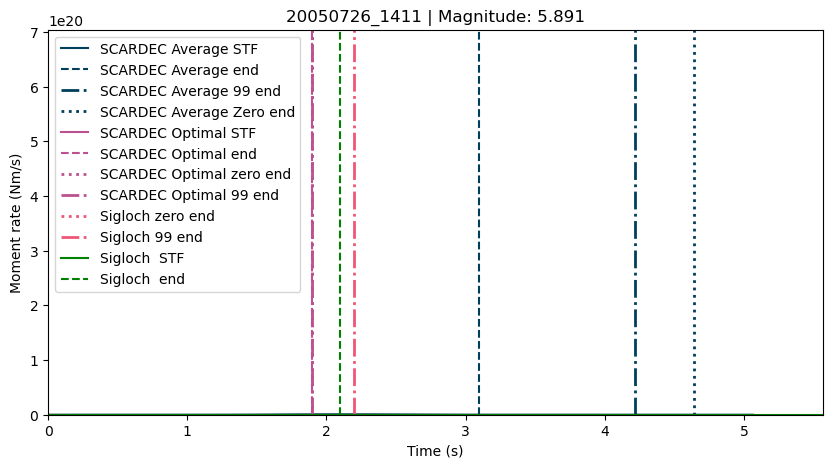

event                                          20110915_0800
scardec    FCTs_20110915_080009_NEAR_EAST_COAST_OF_HONSHU...
ye                                                         0
isc                                                        0
sigloch                                      0228.2011.258.a
usgs                                                       0
mag                                                   6.1785
Name: 26, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183
 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201
 202 203 204 205 206 207 208 209 210 211 212 213 214 215]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 185]
17
0
[  0   1   2   3   4   5   

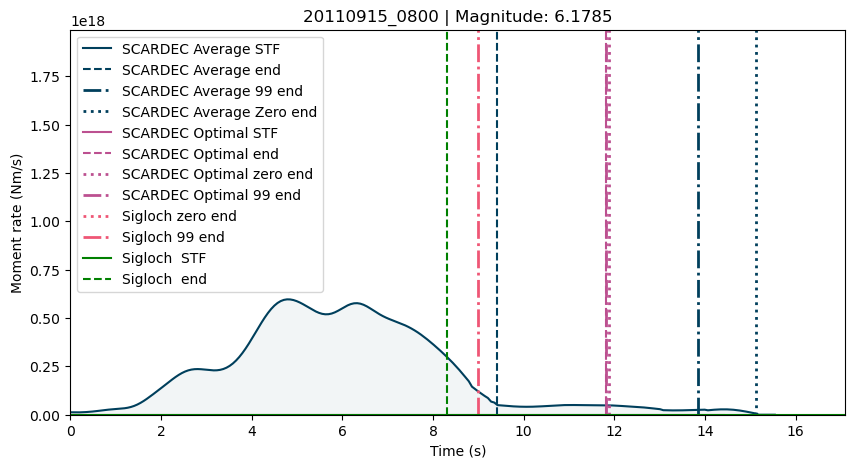

event                                          20171031_0042
scardec    FCTs_20171031_004208_SOUTHEAST_OF_LOYALTY_ISLANDS
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.463
Name: 27, dtype: object
1
[  0   1   2   3   4   5   6   7   8 151 152 153 154 155 156 157 158 159
 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177
 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195
 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213
 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231
 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249
 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267
 268 269 270 271 272 273 274 357 358

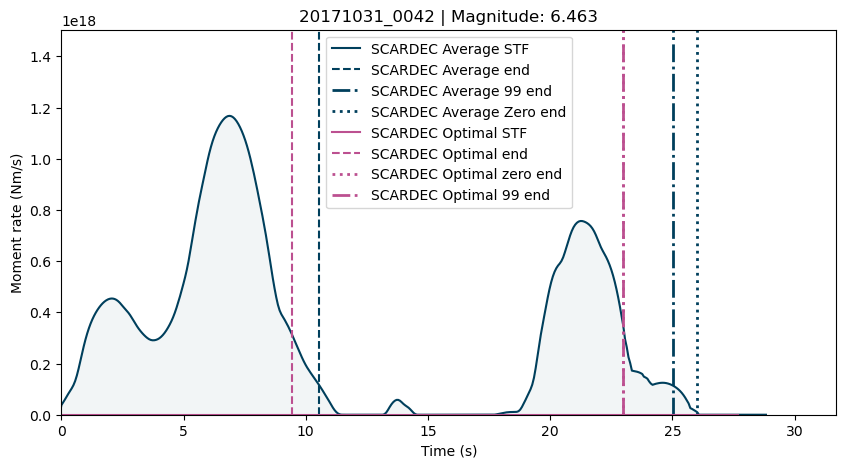

event                           20171104_0900
scardec    FCTs_20171104_090019_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.587
Name: 28, dtype: object
1
[  0  12  13  14  15 141 142 143 144 145 146 147 148 149 183 184 185 186
 187 188 189 190 191 192 193 194 195]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96 130 131 132]
17
14.1328125


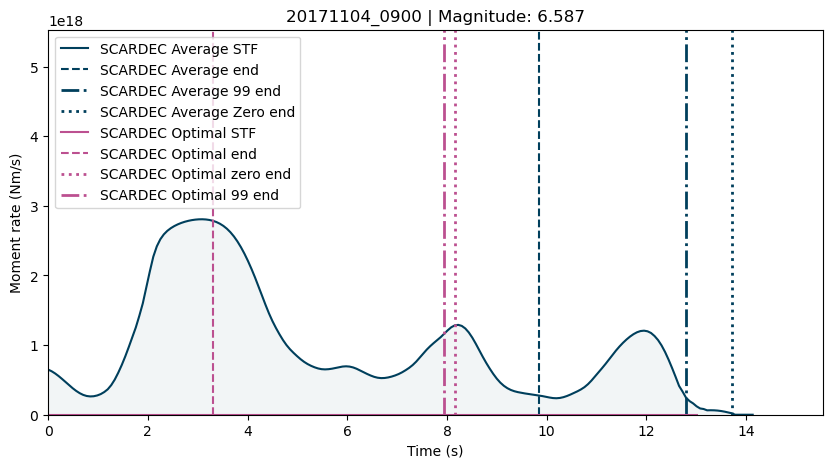

event                                          20221025_0013
scardec    FCTs_20221025_001301_SOUTH_SANDWICH_ISLANDS_RE...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.282
Name: 29, dtype: object
3
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 58 59 60]
3
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
4.507812504


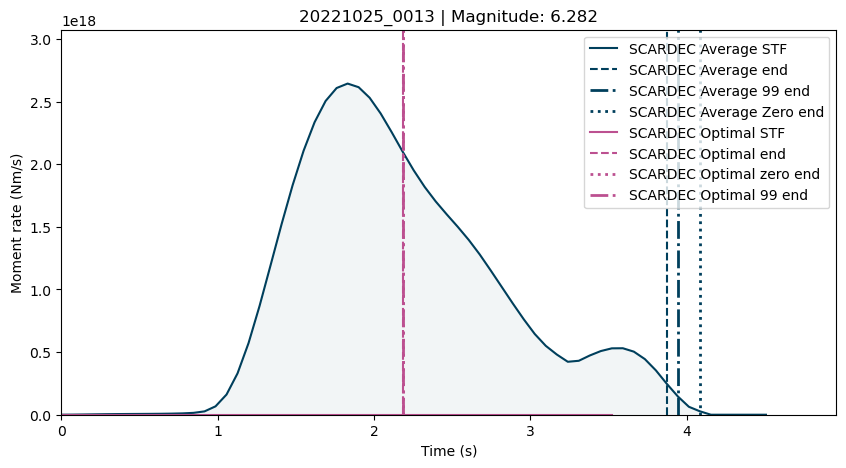

event                                          20180814_0329
scardec    FCTs_20180814_032952_SOUTH_SANDWICH_ISLANDS_RE...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.995
Name: 30, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
7.53649902


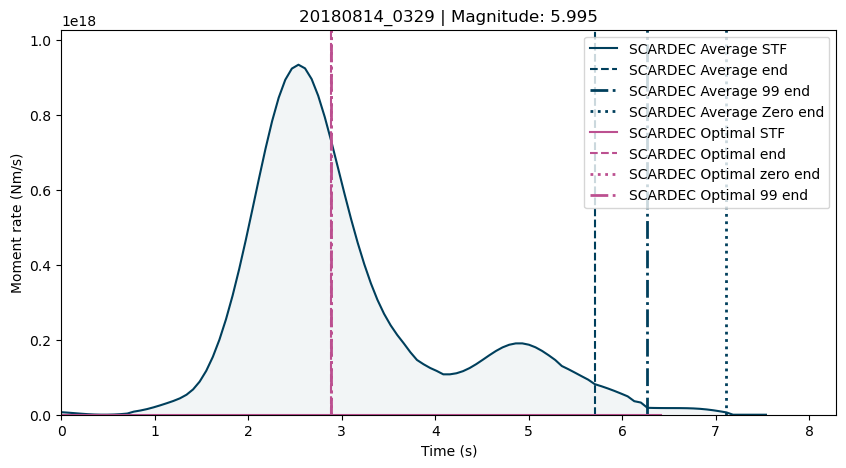

event                                    20211126_0413
scardec    FCTs_20211126_041321_VANUATU_ISLANDS_REGION
ye                                                   0
isc                                                  0
sigloch                                              0
usgs                                                 0
mag                                              5.858
Name: 31, dtype: object
14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 42 43 44 45]
14
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
2.676513671


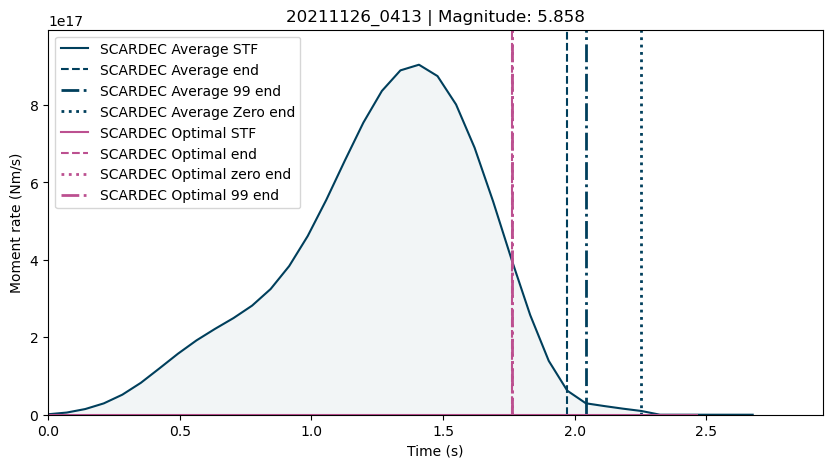

event                                    20130202_1417
scardec    FCTs_20130202_141735_HOKKAIDO__JAPAN_REGION
ye                                                   0
isc                                                  0
sigloch                                0224.2013.033.a
usgs                                                 0
mag                                              6.919
Name: 32, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 165 166 167 168 169 170 171 172 173 174 175]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 14

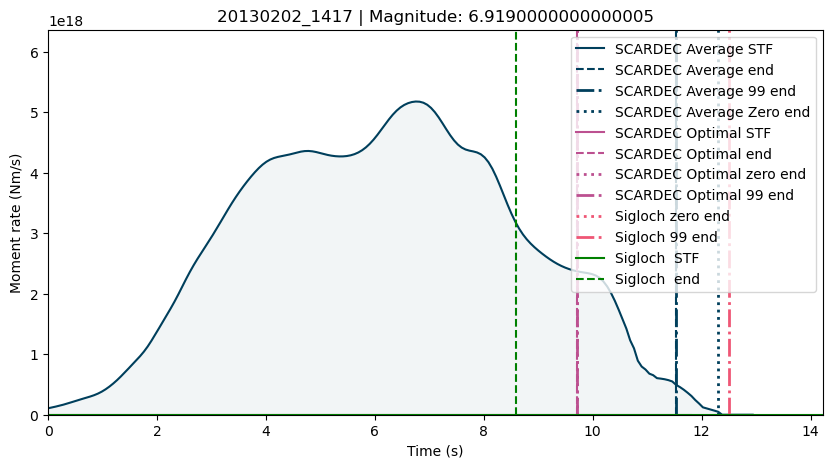

event                       20030309_1036
scardec    FCTs_20030309_103623_BANDA_SEA
ye                                      0
isc                                     0
sigloch                   0280.2003.068.a
usgs                                    0
mag                                5.8925
Name: 33, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 46 47 48
 49 50 51]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  16  17  18  19  20  21  22
  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40
  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58
  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 1

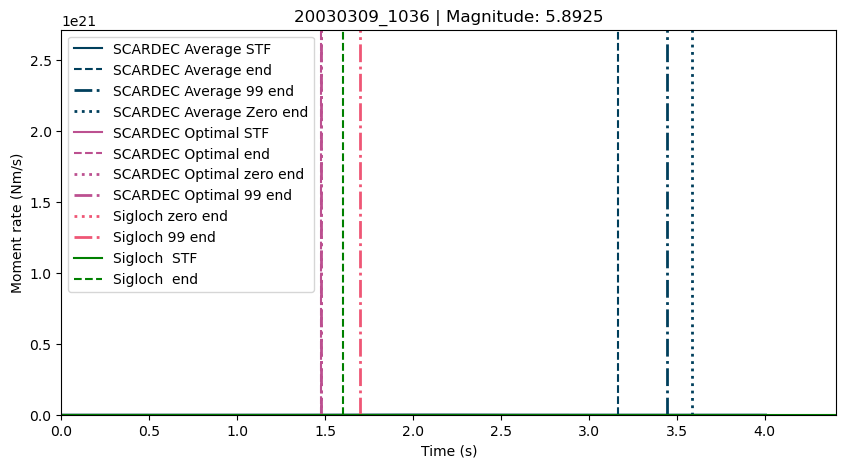

event                                       19990119_0335
scardec    FCTs_19990119_033533_NEW_IRELAND_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 7.017
Name: 34, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40 334 335 336 337 338 339 340 341 342 343 344]
17
28.96875


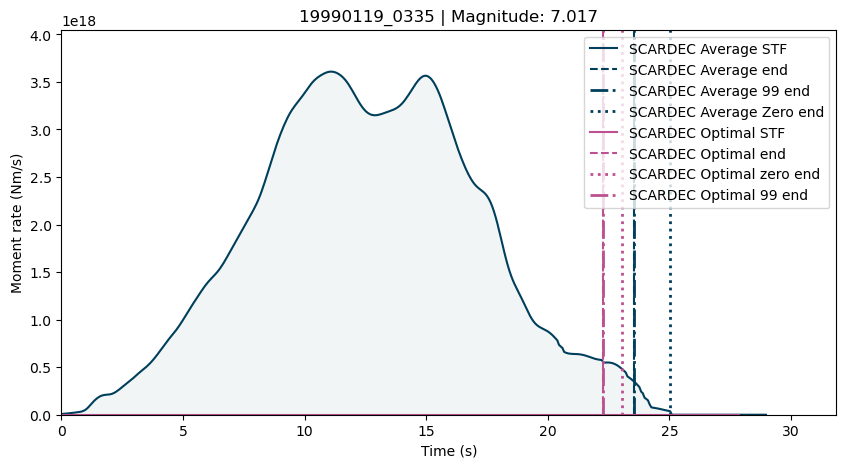

event                                20011202_0247
scardec    FCTs_20011202_024756_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                            0184.2001.336.a
usgs                                             0
mag                                         6.0035
Name: 35, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 71 72 73 74 75 76 77 78 79]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 76]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  21  22
  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40
  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58
  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  

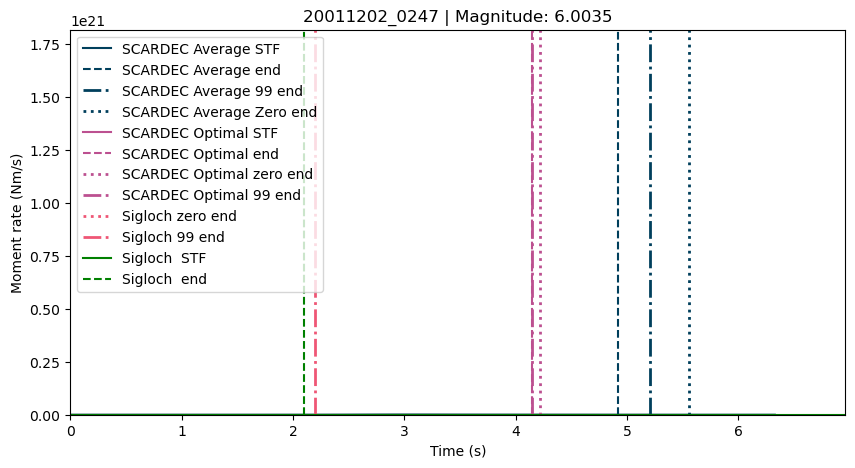

event                                19970512_1345
scardec    FCTs_19970512_134526_PANAY__PHILIPPINES
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          6.006
Name: 36, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 128
 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148 149 150]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 54 55
 56 57 58 59]
17
12.5859375


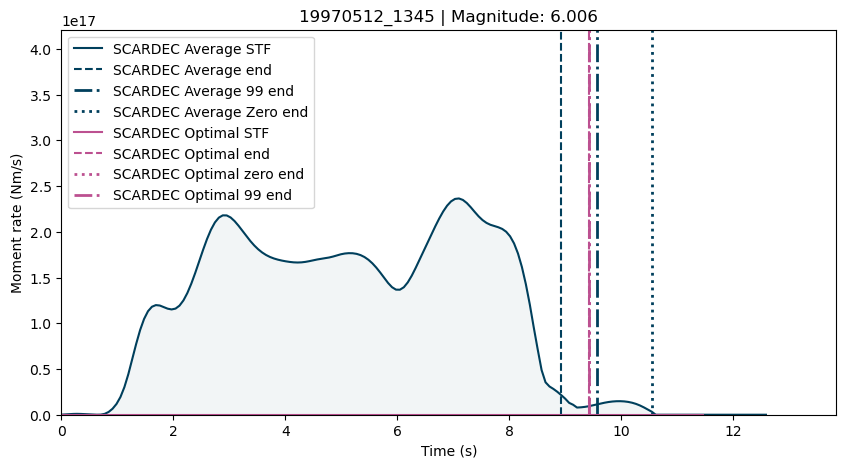

event                           20000126_1326
scardec    FCTs_20000126_132650_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.343
Name: 37, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128
 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35]
17
13.5


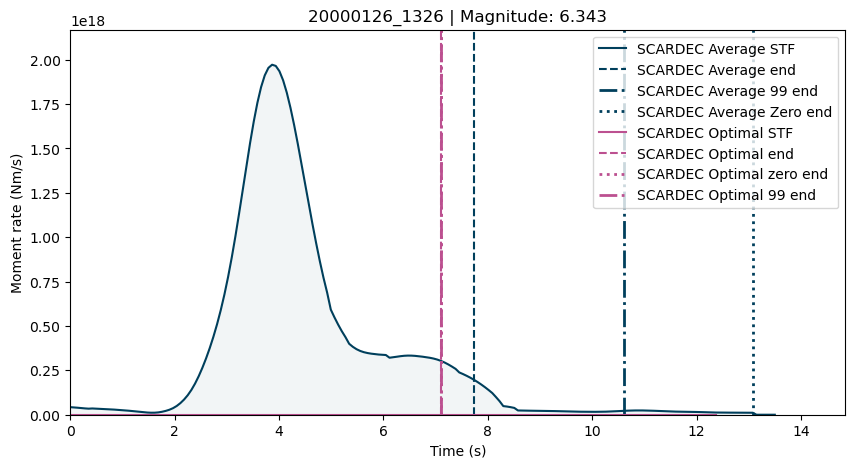

event                                     20120925_2345
scardec    FCTs_20120925_234524_BAJA_CALIFORNIA__MEXICO
ye                                                    0
isc                                                   0
sigloch                                 0048.2012.269.a
usgs                                                  0
mag                                              6.2535
Name: 38, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 83 84 85 86]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  88  89  90  91  92  93  94  95  96  97  98  99 100
 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 13

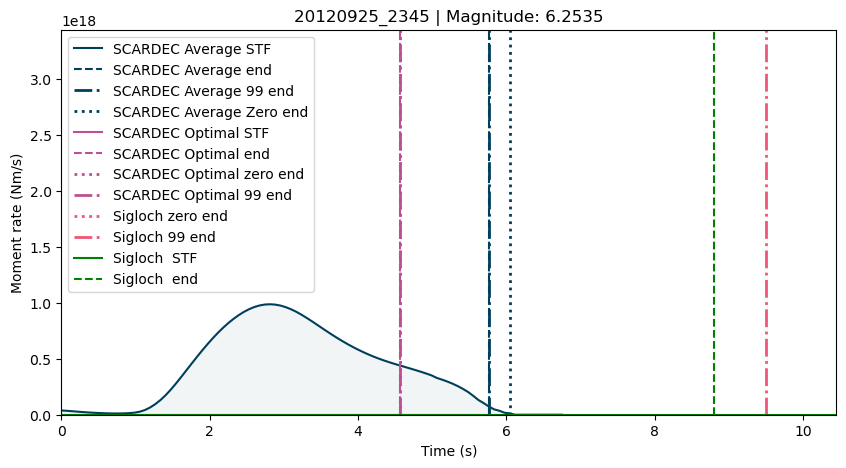

event                                         20190120_0132
scardec    FCTs_20190120_013252_NEAR_COAST_OF_CENTRAL_CHILE
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.751
Name: 39, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297 298]
1
17
[  0   1   2   3   4   5   6   7   8 

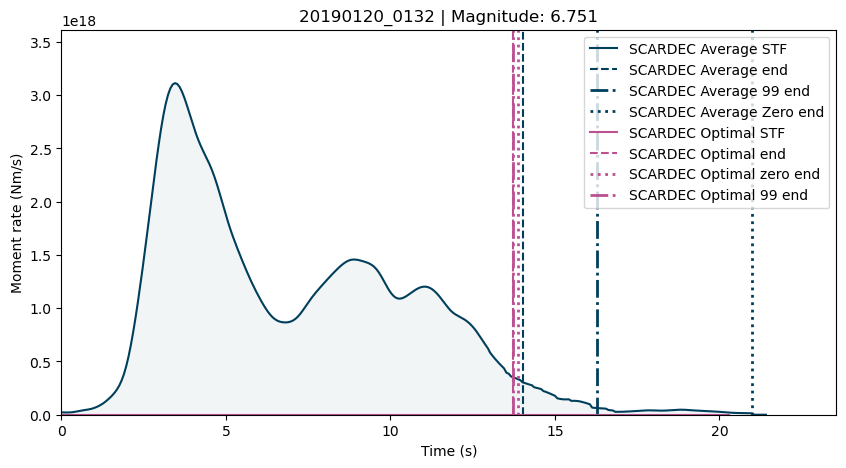

event                           20061226_1226
scardec    FCTs_20061226_122621_TAIWAN_REGION
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     7.113
Name: 40, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320
 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523]
1
17
[

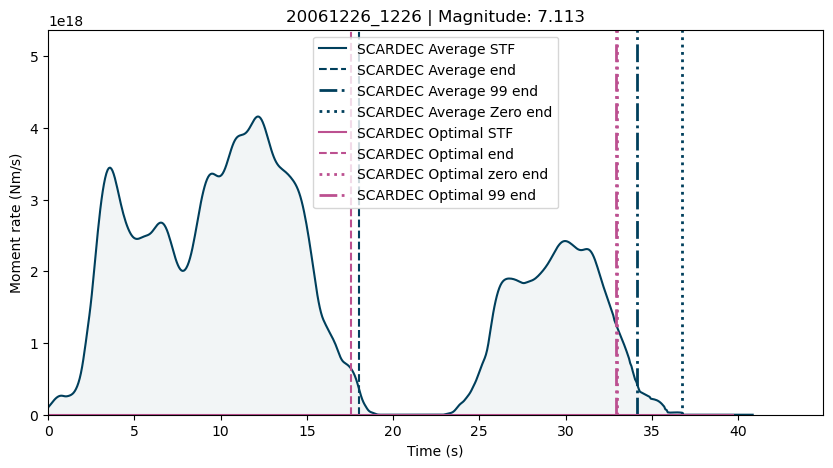

event                            20100630_0722
scardec    FCTs_20100630_072227_OAXACA__MEXICO
ye                                           0
isc                                          0
sigloch                        0060.2010.181.a
usgs                                         0
mag                                     6.2475
Name: 41, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134 135 136 137 138 139 140 141 142 143 144 145]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 122]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102

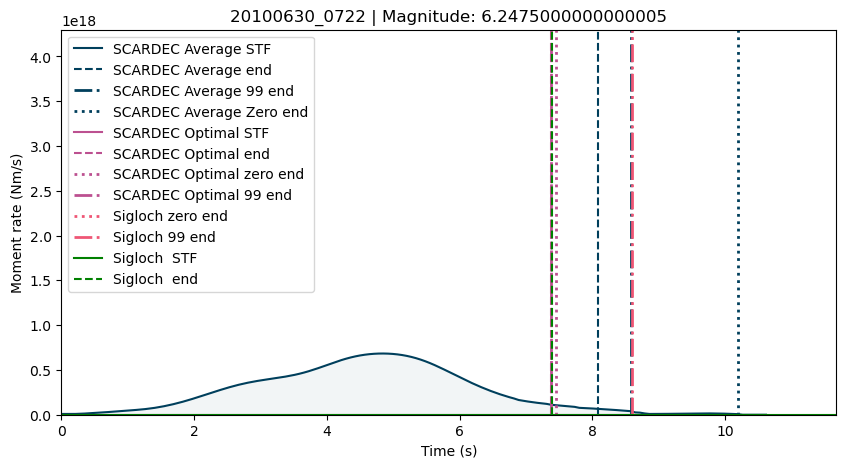

event                                   20170428_2023
scardec    FCTs_20170428_202317_MINDANAO__PHILIPPINES
ye                                                  0
isc                                                 0
sigloch                                             0
usgs                                                0
mag                                             6.817
Name: 42, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 115 116 117
 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189
 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 111]
17
15.1875


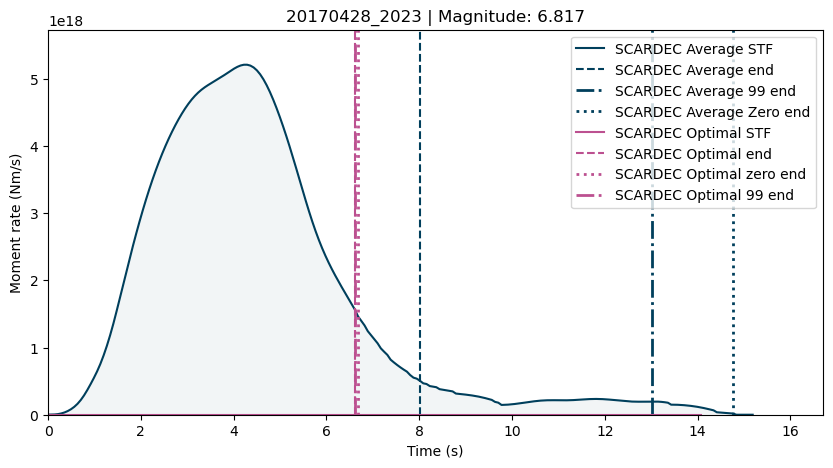

event                          20151104_0344
scardec    FCTs_20151104_034415_TIMOR_REGION
ye                                         0
isc                                        0
sigloch                      0289.2015.308.a
usgs                                       0
mag                                   6.5235
Name: 43, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 236 237
 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255
 256 257 258 259 260 261 262 263 264 265 266 315 316 317 318 319 320 321
 322 323 324 325 326 327 328 329]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 238 239 240 241 242 243 244 245 246 247
 248 249 250 251 252 253 254 255 256

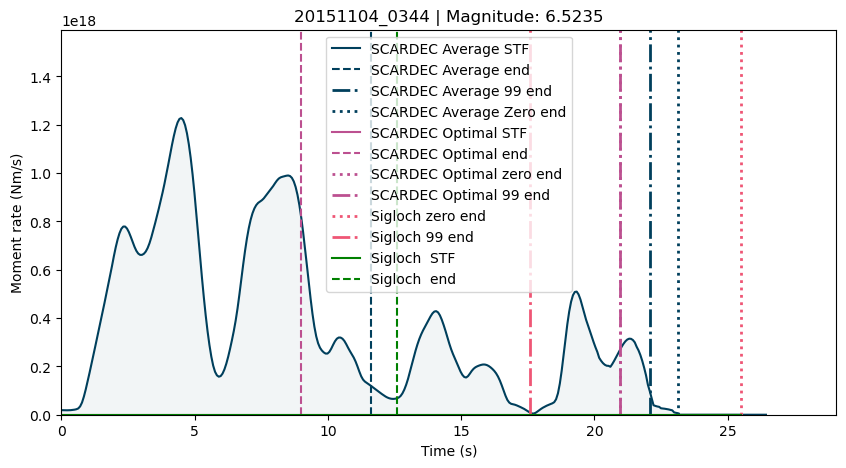

event                    20200614_1424
scardec    FCTs_20200614_142429_TURKEY
ye                                   0
isc                                  0
sigloch                              0
usgs                                 0
mag                                5.8
Name: 44, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 67 68 69
 70 71 72 73 74 75 76 77]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
5.84606933


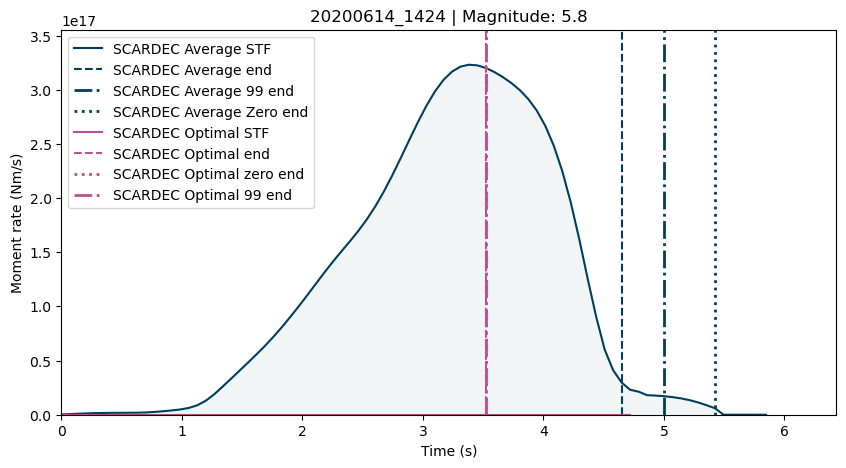

event                                          20200623_1529
scardec    FCTs_20200623_152904_NEAR_COAST_OF_OAXACA__MEXICO
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                     20200623_152904.txt
mag                                                    7.415
Name: 45, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12 195 196 197 198 199
 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217
 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235
 236 237 238]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 222 223 224 225 226 227 228]
17
1
[  0   1   2   3  56  57  58  59  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87
  88  89  90  91  92  93  94  95  96  9

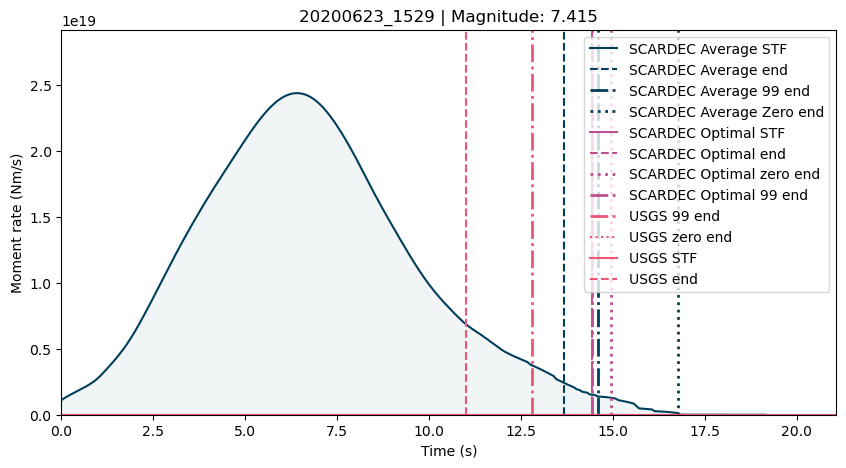

event                                19920804_2108
scardec    FCTs_19920804_210841_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          6.447
Name: 46, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 151 152 153]
17
12.796875


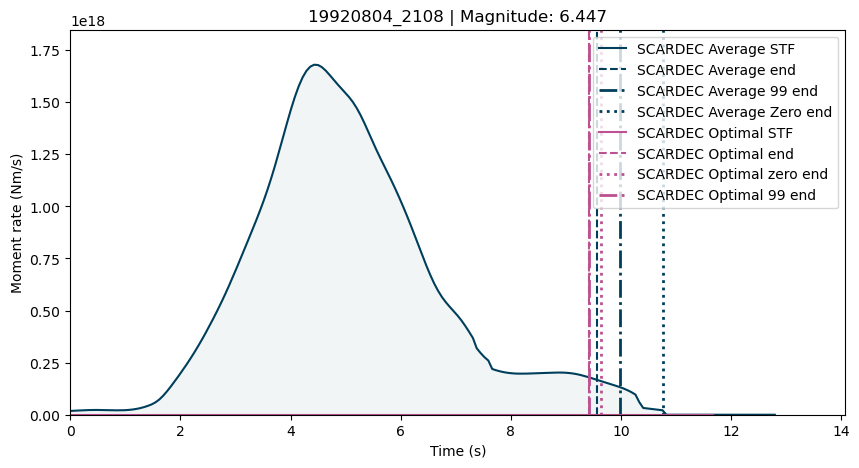

event                             20080106_0514
scardec    FCTs_20080106_051420_SOUTHERN_GREECE
ye                                            0
isc                                           0
sigloch                         0368.2008.006.a
usgs                                          0
mag                                      5.9745
Name: 47, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58 59 60 61
 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85
 86]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58]
17
0
[  0   1   2   3   4   5   6   7   8   9  16  17  18  19  20  21  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 10

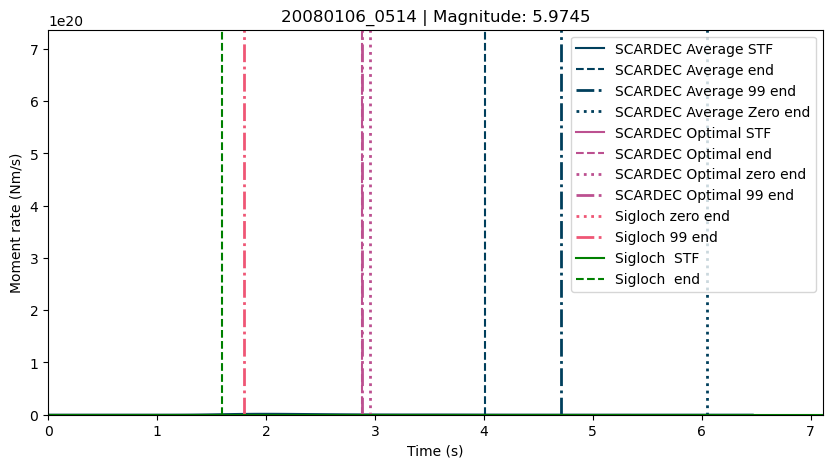

event                                 20050123_2010
scardec    FCTs_20050123_201012_SULAWESI__INDONESIA
ye                                                0
isc                                               0
sigloch                             0268.2005.023.a
usgs                                              0
mag                                           6.177
Name: 48, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  68  69
  70  71  72  73  74  75  76  

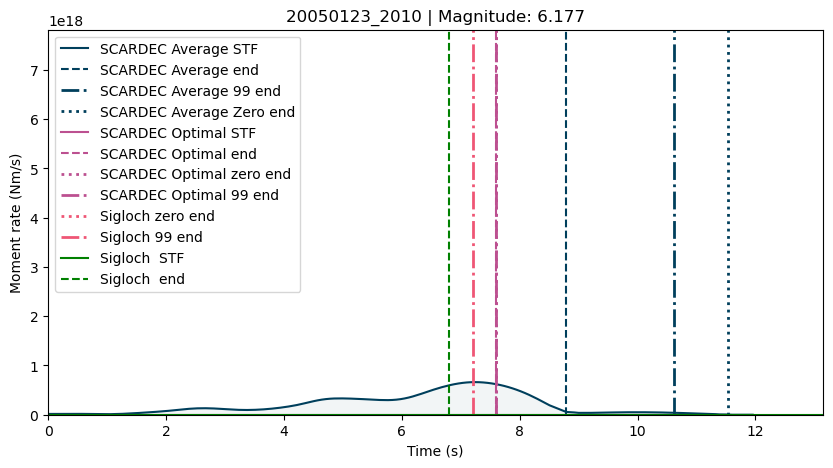

event                                          20020508_1945
scardec    FCTs_20020508_194518_NEAR_EAST_COAST_OF_KAMCHATKA
ye                                                         0
isc                                                        0
sigloch                                      0218.2002.128.a
usgs                                                       0
mag                                                   5.8585
Name: 49, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189
 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 2

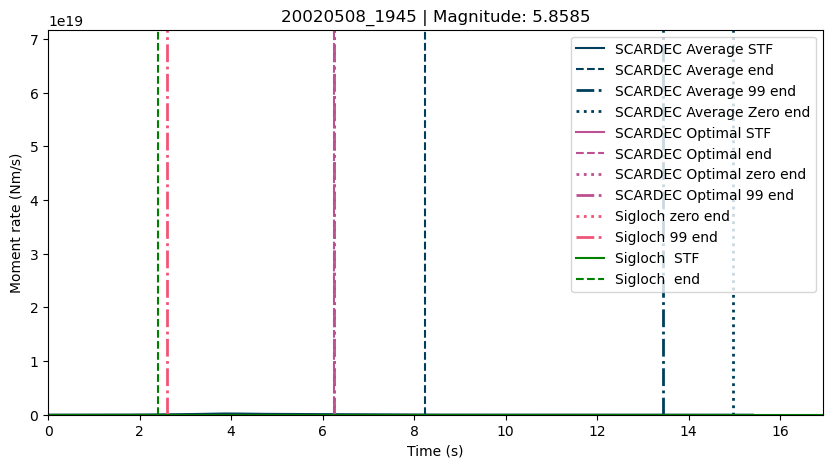

event                           20181029_0654
scardec    FCTs_20181029_065421_DRAKE_PASSAGE
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.354
Name: 50, dtype: object
14
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
 108 109 110 111 112 113 114 115 116 117]
14
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 103]
17
7.747802730999999


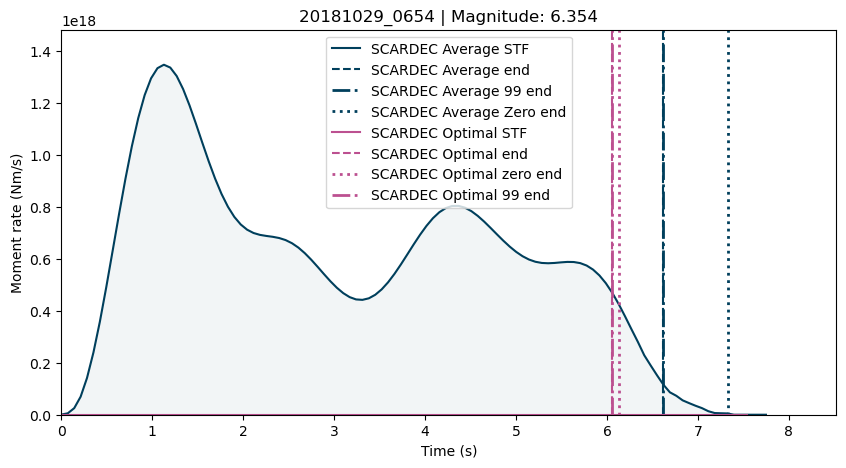

event                                 20060102_2213
scardec    FCTs_20060102_221340_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                                           0
usgs                                              0
mag                                           7.071
Name: 51, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193
 194 195 196 197 198 199]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36]
17
14.4140625


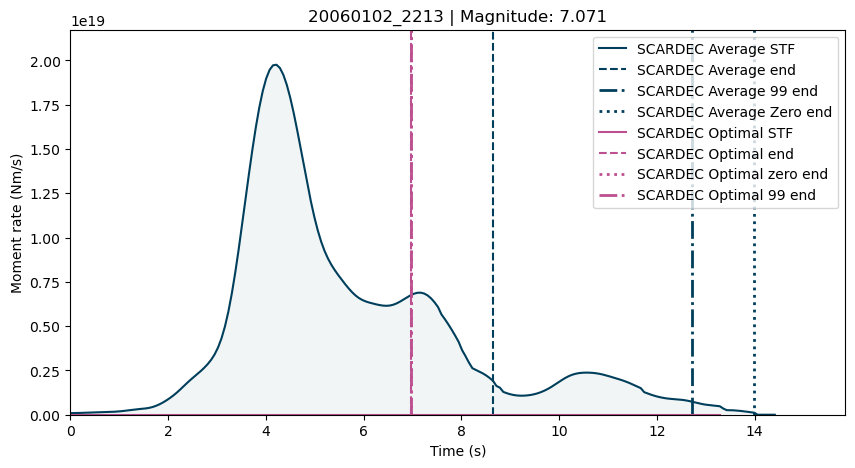

event                                          19990507_1413
scardec    FCTs_19990507_141352_KODIAK_ISLAND_REGION__ALASKA
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.302
Name: 52, dtype: object
5
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 186 187 188
 189 190 191 192 193 194 195]
5
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27 28 29 30 31 32 33 34 35 36]
17
15.8203125


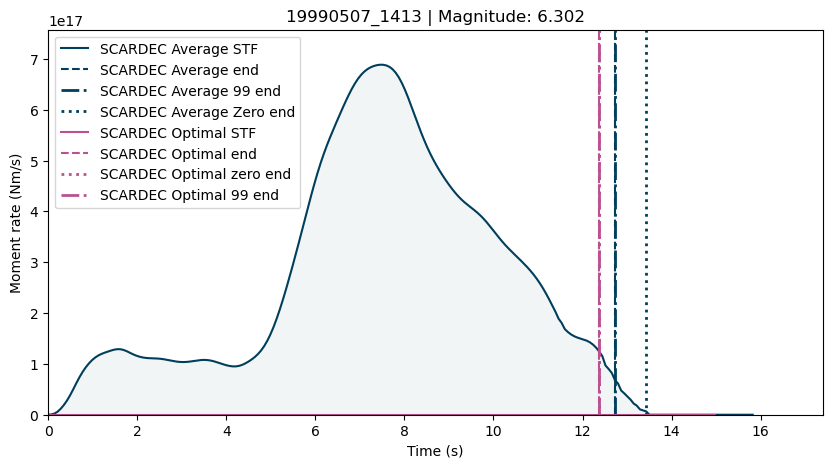

event                                          20080929_1519
scardec    FCTs_20080929_151931_KERMADEC_ISLANDS__NEW_ZEA...
ye                             200809291519_Kermadec.mrf.txt
isc                                                        0
sigloch                                      0178.2008.273.a
usgs                                                       0
mag                                                    7.024
Name: 53, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40 277 278 279 280 281 282 283 284 285 286 287 288 289
 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306 307
 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323 324 325
 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370

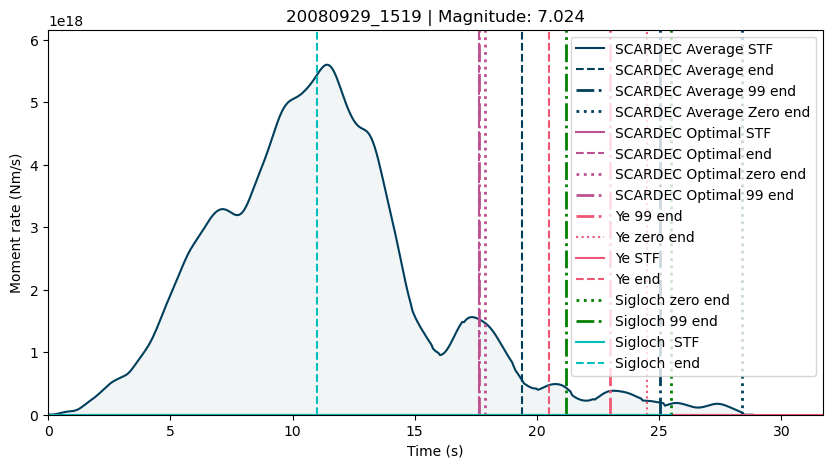

event                            20161225_1422
scardec    FCTs_20161225_142227_SOUTHERN_CHILE
ye                 201612251422_SChile.mrf.txt
isc                                          0
sigloch                                      0
usgs                       20161225_142227.txt
mag                                      7.559
Name: 54, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 296 297 298 299 300 301 302 303 304 305
 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323
 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427]
1
1

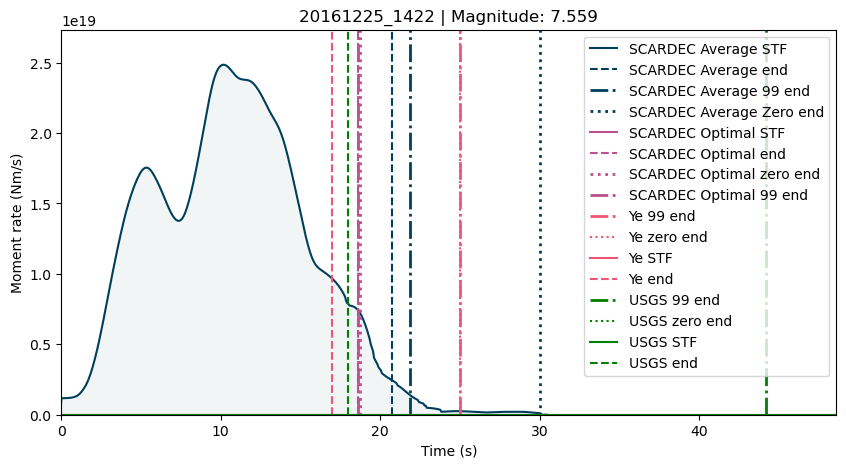

event                              19940609_0033
scardec    FCTs_19940609_003316_NORTHERN_BOLIVIA
ye                                             0
isc                                            0
sigloch                                        0
usgs                                           0
mag                                        8.237
Name: 55, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 58

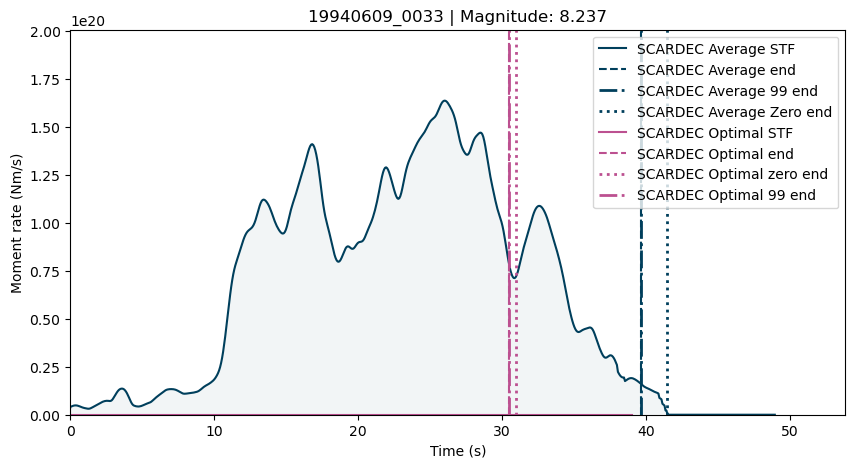

event                                         19940111_0051
scardec    FCTs_19940111_005156_MYANMAR-CHINA_BORDER_REGION
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.003
Name: 56, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  71  83  84
  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102
 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120
 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
10.0546875


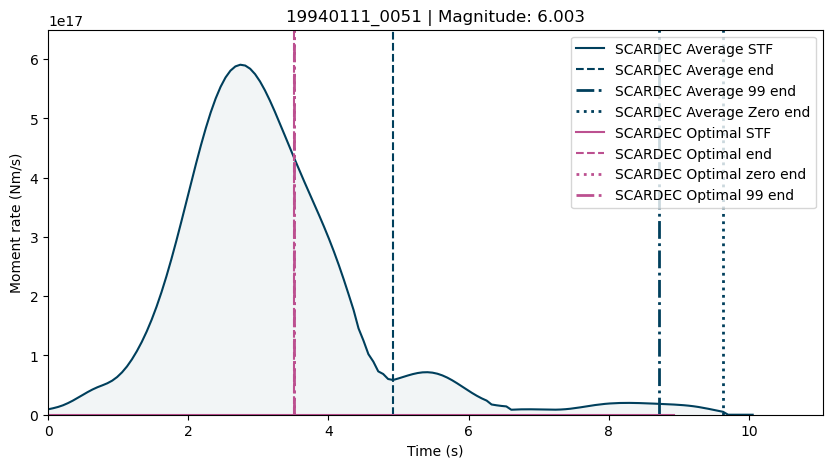

event                                 20190822_1927
scardec    FCTs_20190822_192711_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                                           0
usgs                                              0
mag                                           6.061
Name: 57, dtype: object
16
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 199 200 201 202 203 204 205 206 207 208 209 210
 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228
 229 230 231]
16
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89 

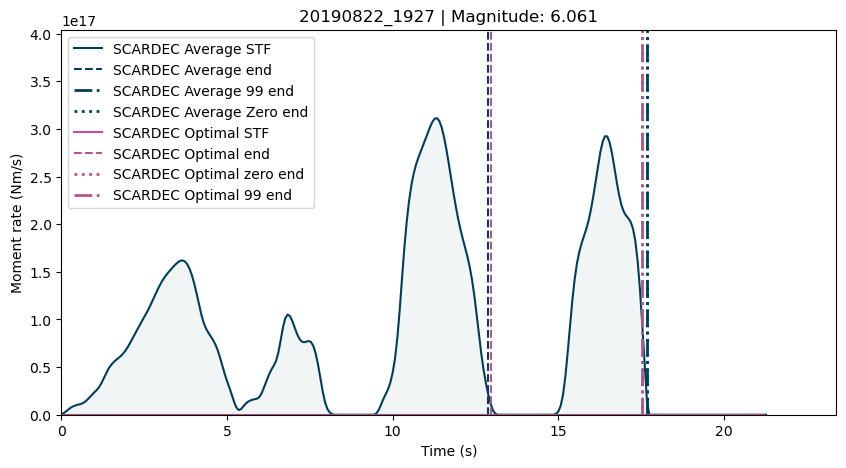

event                                     20220320_1810
scardec    FCTs_20220320_181043_KERMADEC_ISLANDS_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.071
Name: 58, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 151 152 153 154 155 156 157 158]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 104 105 106]
17
11.55126955


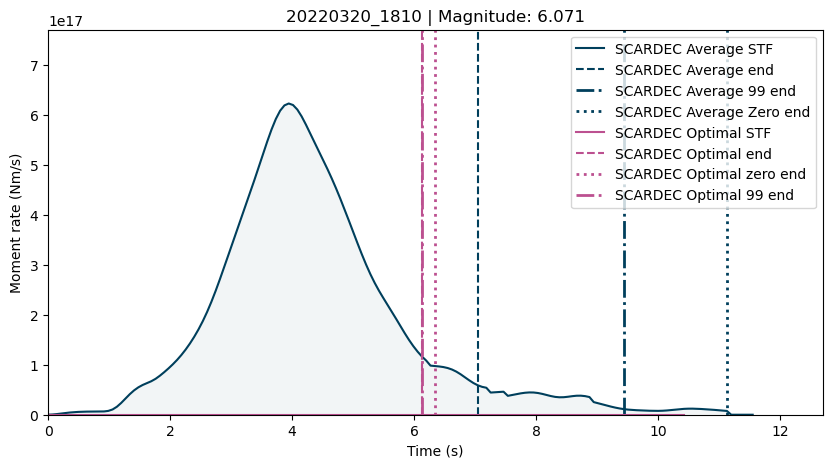

event                                          20001205_2211
scardec    FCTs_20001205_221134_FOX_ISLANDS__ALEUTIAN_ISL...
ye                                                         0
isc                                                        0
sigloch                                      0009.2000.340.a
usgs                                                       0
mag                                                   5.9405
Name: 59, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103
 104 105 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134
 173 174 175 176 177 178 179 180 181 182 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  29  30  31  32
  33  34  35  36  37  38  39  40  41  42

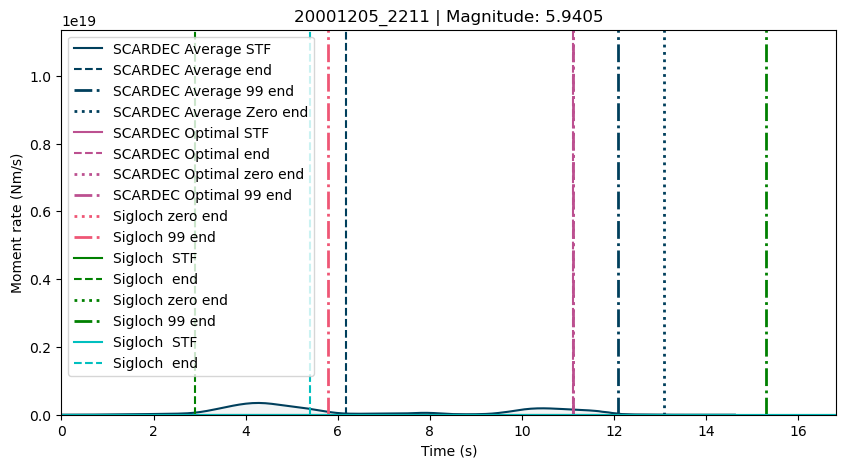

event                    19951001_1557
scardec    FCTs_19951001_155716_TURKEY
ye                                   0
isc                                  0
sigloch                0366.1995.274.a
usgs                                 0
mag                              6.343
Name: 60, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32 216]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  20  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  96

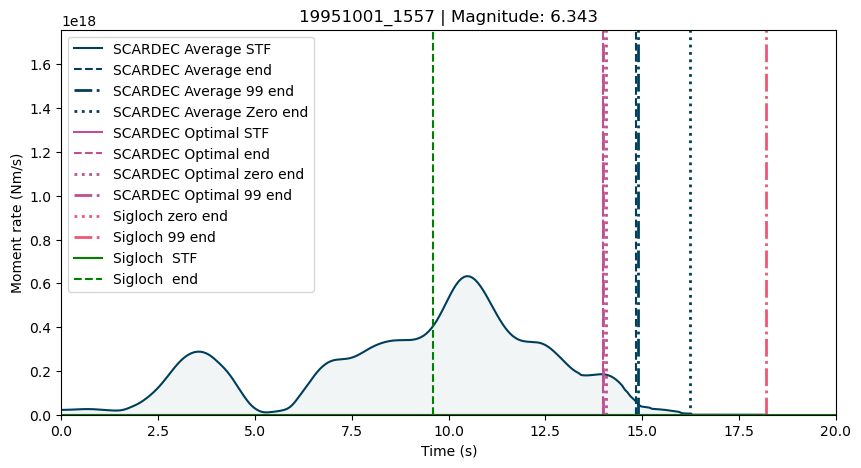

event                                   19951019_0032
scardec    FCTs_19951019_003206_RYUKYU_ISLANDS__JAPAN
ye                                                  0
isc                                                 0
sigloch                                             0
usgs                                                0
mag                                             6.402
Name: 61, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12 163 164 165 166 167
 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185
 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221
 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239
 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257
 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275
 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293
 294 295 296

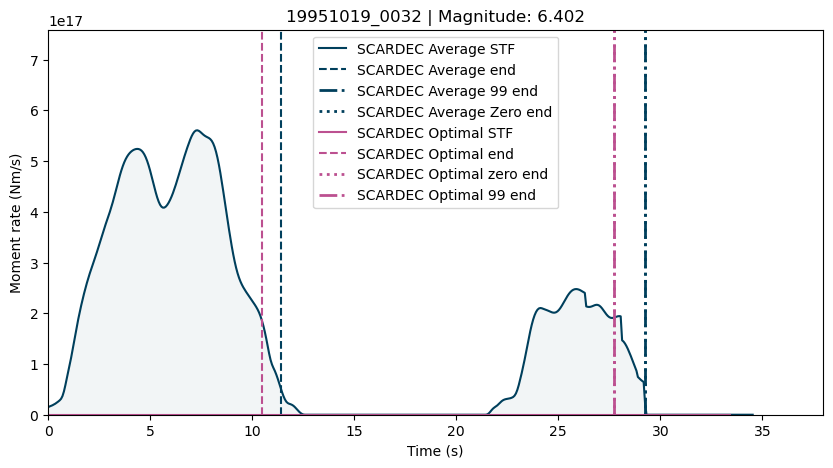

event                                   20020101_1129
scardec    FCTs_20020101_112922_MINDANAO__PHILIPPINES
ye                                                  0
isc                                                 0
sigloch                               0259.2002.001.a
usgs                                                0
mag                                             6.285
Name: 62, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81
  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99
 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119 120 121 122 123]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 67 68]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58 

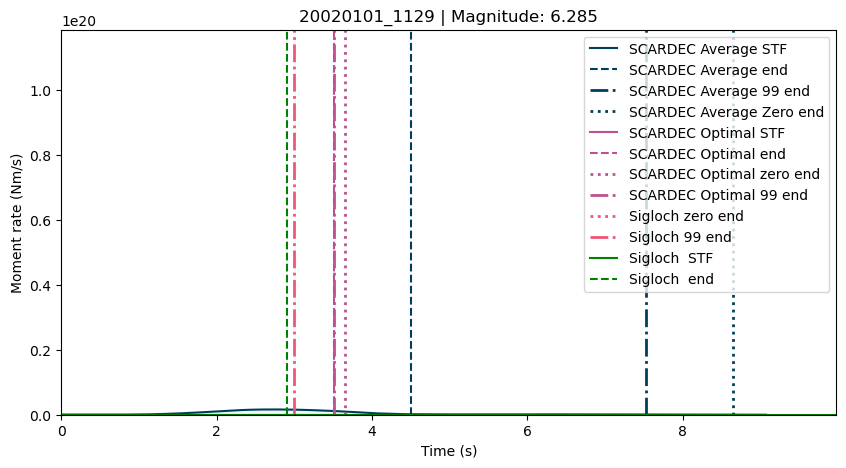

event                                          20190615_2255
scardec    FCTs_20190615_225504_KERMADEC_ISLANDS__NEW_ZEA...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                     20190615_225504.txt
mag                                                    7.292
Name: 63, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 231 232 233]
17
1
[  0   1   2   3   4   5  73  74  75  76  77  78  79  80  81  82  83  84
  85  86  87  88  89  9

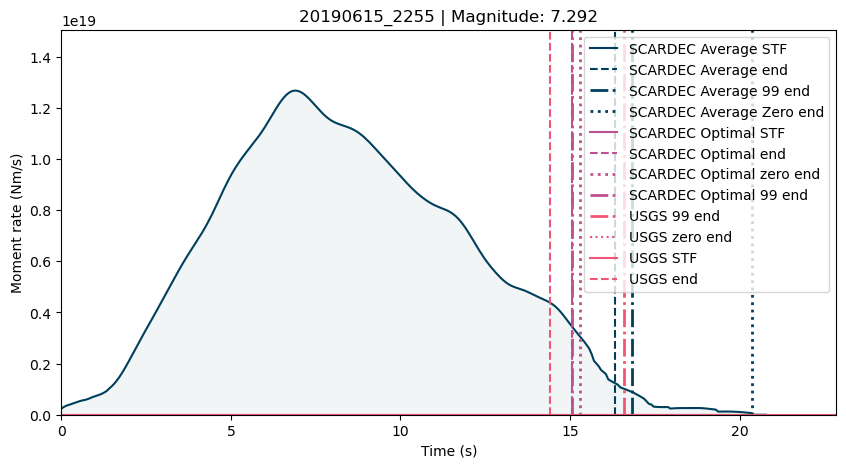

event                                         20211110_1545
scardec    FCTs_20211110_154513_SOUTHEAST_OF_RYUKYU_ISLANDS
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                    6.56
Name: 64, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15 166 167
 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185
 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221
 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239
 240 241 242 243 244 245 246 247 248 249 250]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 144 145 146 147 148]
17
18.03124995


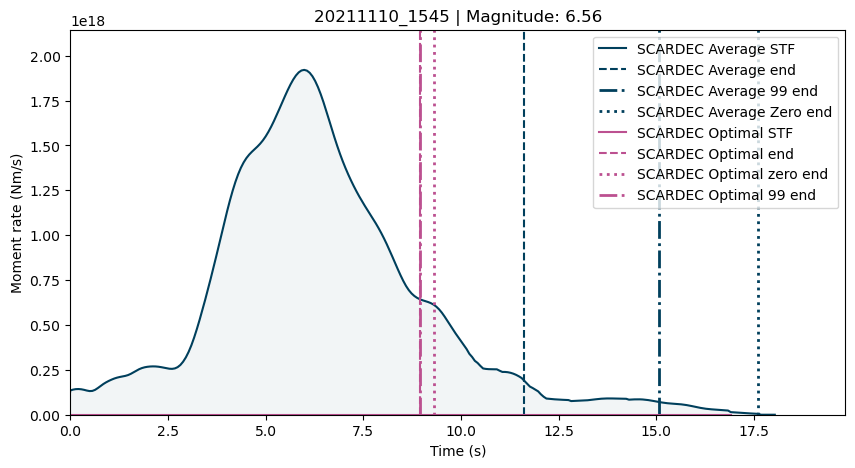

event                                          20121214_1036
scardec    FCTs_20121214_103601_OFF_W._COAST_OF_BAJA_CALI...
ye                                                         0
isc                                                        0
sigloch                                      0047.2012.349.a
usgs                                                       0
mag                                                    6.302
Name: 65, dtype: object
13
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 108 109 110 111 112 113 114 115 116 117 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142
 143 144 145 146]
13
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 106 107]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98 

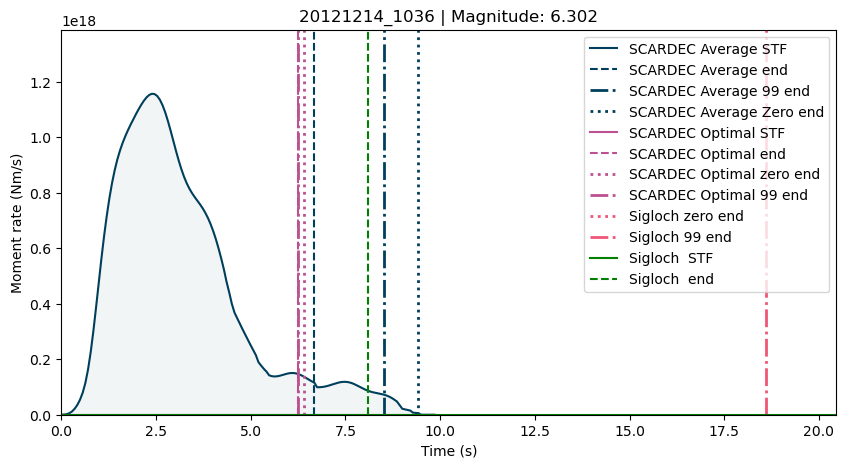

event                              20211011_0910
scardec    FCTs_20211011_091025_ALASKA_PENINSULA
ye                                             0
isc                                            0
sigloch                                        0
usgs                                           0
mag                                        6.889
Name: 66, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170 171 172 173 174 175 176 177]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 100]
17
12.88952635


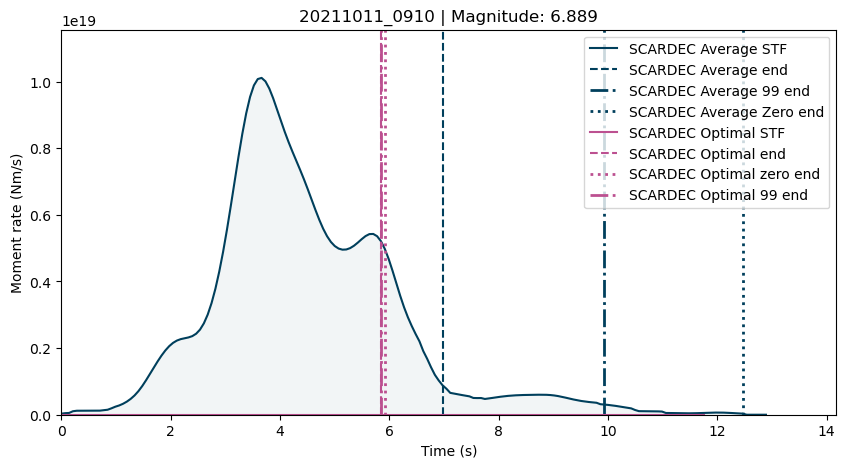

event                     19940808_2108
scardec    FCTs_19940808_210831_MYANMAR
ye                                    0
isc                                   0
sigloch                               0
usgs                                  0
mag                               6.108
Name: 67, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
17
7.6640625


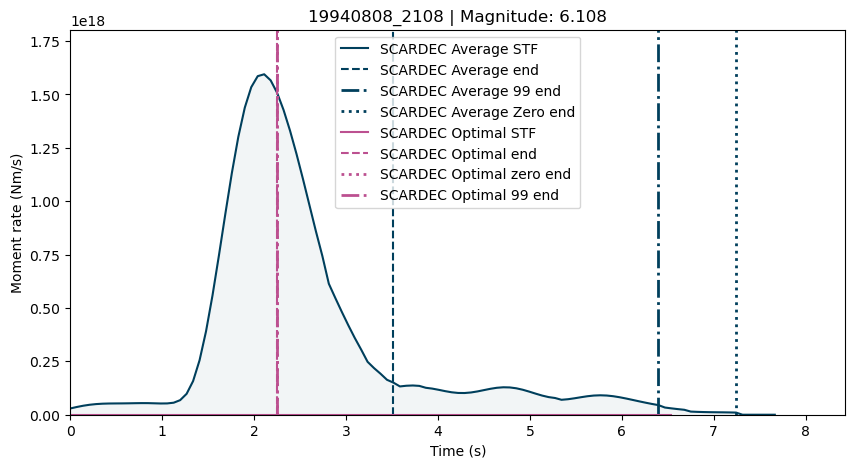

event                           20051127_1022
scardec    FCTs_20051127_102219_SOUTHERN_IRAN
ye                                          0
isc                                         0
sigloch                       0353.2005.331.a
usgs                                        0
mag                                    6.0365
Name: 68, dtype: object
4
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 89 90 91
 92 93 94]
4
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 1

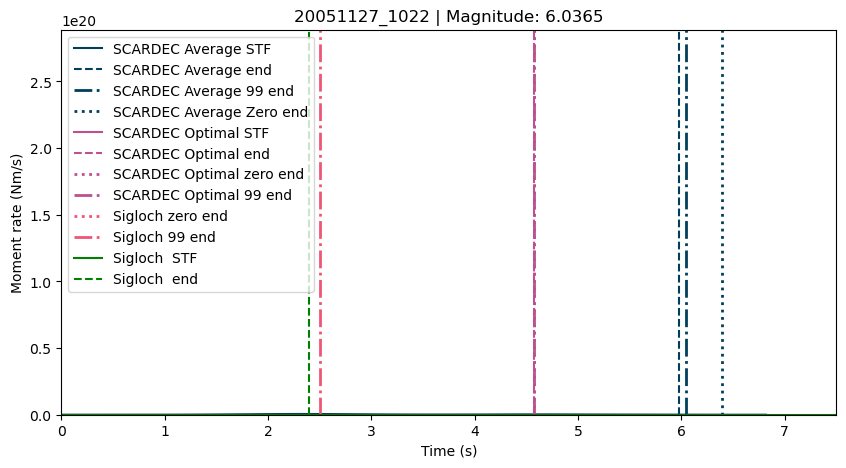

event                                     19980618_0417
scardec    FCTs_19980618_041754_ASCENSION_ISLAND_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.259
Name: 69, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 232 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297 298
 299 300]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 215 216]
17
21.515625


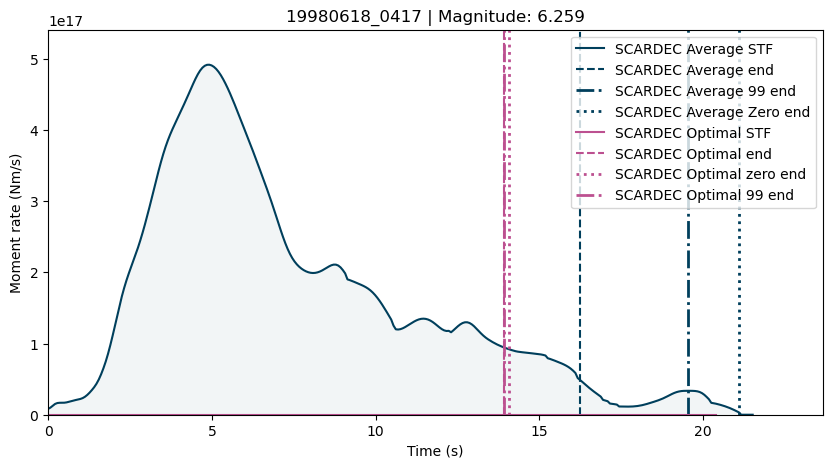

event                                          19960330_1305
scardec    FCTs_19960330_130517_FOX_ISLANDS__ALEUTIAN_ISL...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.283
Name: 70, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  69  70  71  72  73  74  75  76  77  78  79  88  89  90  91  92  93
  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112]
17
12.09375

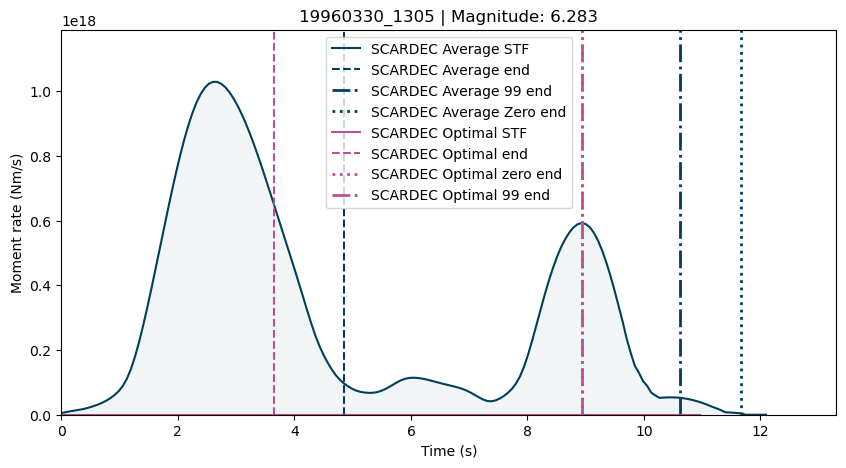

event                                  20180715_1309
scardec    FCTs_20180715_130916_EASTERN_GULF_OF_ADEN
ye                                                 0
isc                                                0
sigloch                                            0
usgs                                               0
mag                                            5.909
Name: 71, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
9.7199707


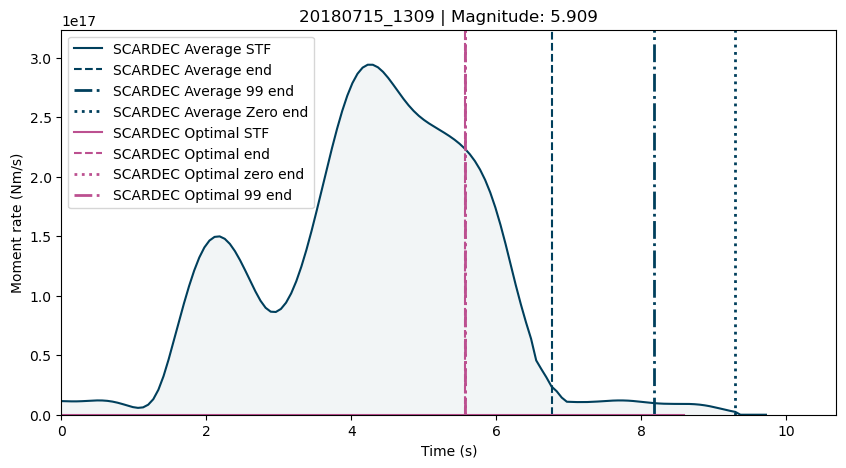

event                                       20200107_1911
scardec    FCTs_20200107_191135_NEW_BRITAIN_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 5.959
Name: 72, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  86  87
  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105
 106 107 108 109 110 111 112 113 114 115 116 117]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 80 81 82 83 84
 85 86 87 88 89 90 91 92 93 94 95 96]
17
8.66345214


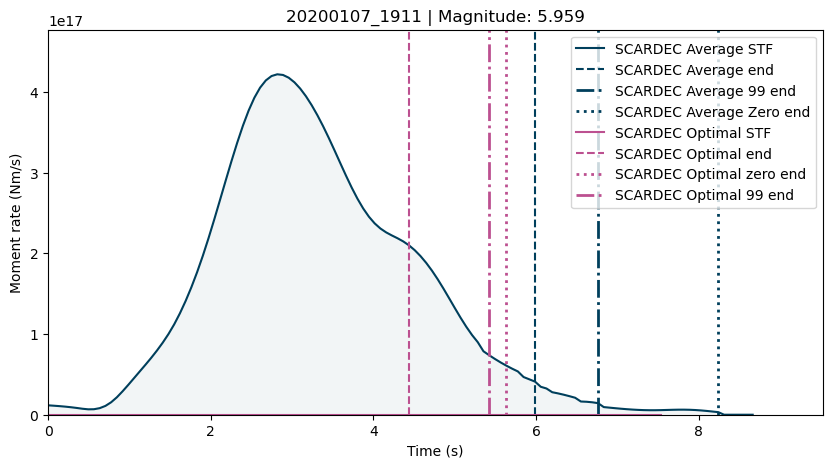

event                           20091010_2124
scardec    FCTs_20091010_212438_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                       0221.2009.283.a
usgs                                        0
mag                                    5.9785
Name: 73, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 51 52 53 54 55
 56 57 58 59 60 61 62 63 64 65 66 67 68 69]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 53 54 55 56
 57 58]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 1

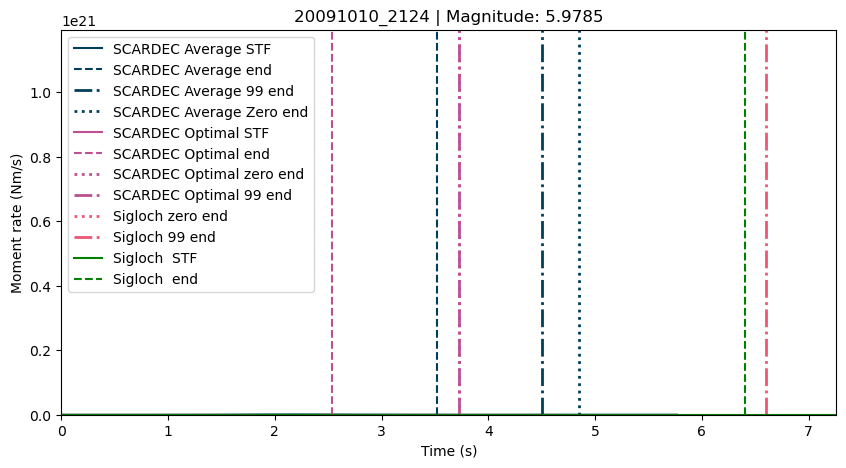

event                      20120930_1631
scardec    FCTs_20120930_163135_COLOMBIA
ye                                     0
isc                                    0
sigloch                  0103.2012.274.a
usgs                                   0
mag                                7.275
Name: 74, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277
 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295
 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313
 314 315 316]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
17
0
[  0   1   2   3   4   5   6 

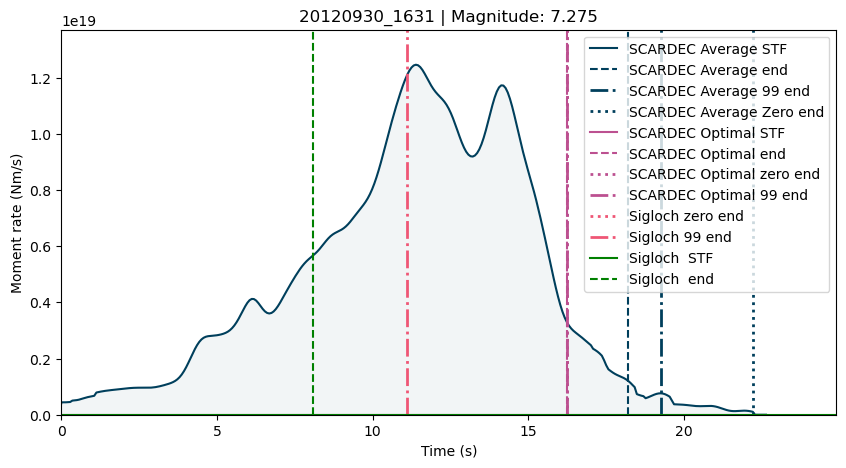

event                           19951006_1139
scardec    FCTs_19951006_113934_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.375
Name: 75, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 73 74 75 76
 77 78 79 80 81 82]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 71 72]
17
6.1875


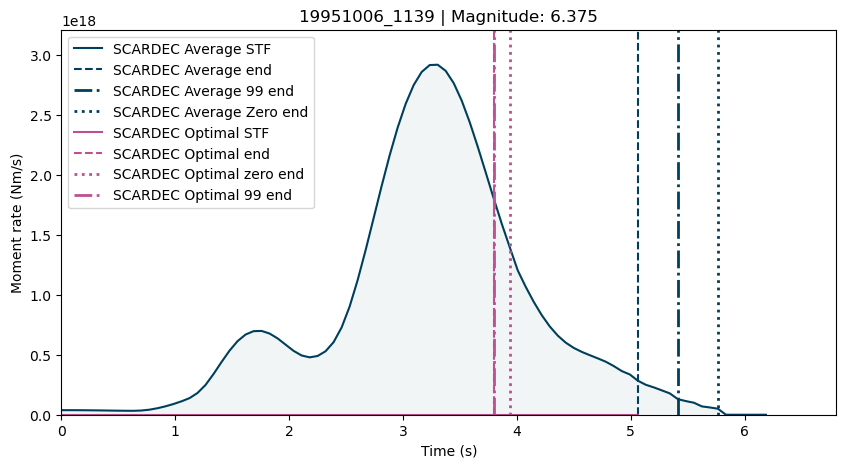

event                                        20190729_2037
scardec    FCTs_20190729_203743_SOUTHEAST_OF_HONSHU__JAPAN
ye                                                       0
isc                                                      0
sigloch                                                  0
usgs                                                     0
mag                                                  5.808
Name: 76, dtype: object
7
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 63 64 65 66
 67 68 69 70 71 72 73 74 75 76]
7
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
5.353027343


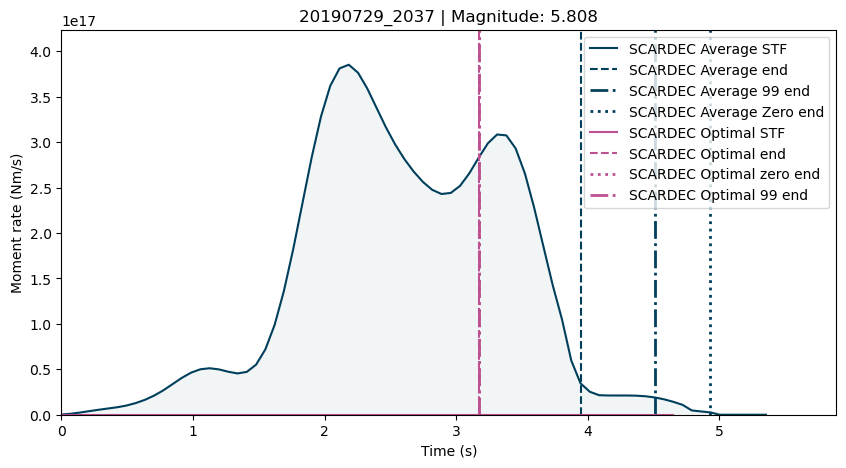

event                        19990821_1049
scardec    FCTs_19990821_104951_COSTA_RICA
ye                                       0
isc                                      0
sigloch                    0078.1999.233.a
usgs                                     0
mag                                  5.779
Name: 77, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 80 81 82 83 84 85
 86 87]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 87]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  49  50  51
  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87
  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105
 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123
 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141
 142 143 

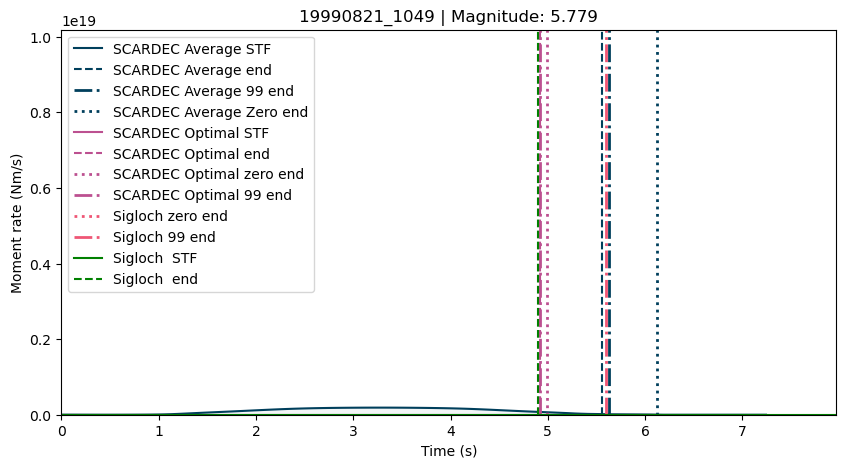

event                             20110820_1655
scardec    FCTs_20110820_165502_VANUATU_ISLANDS
ye                 201108201655_Vanuatu.mrf.txt
isc                                           0
sigloch                         0186.2011.232.a
usgs                        20110820_165502.txt
mag                                      7.1165
Name: 78, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29 172 173 174 175 176 177
 178 179 180 181 182 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
1
[ 0  1  2  3 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55
 56 57 58 59 60 61 62 63]
1
5
[  0   1   2   3   4   5   6   7   8   9  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111 112 113 114 115 116 117 118 119 1

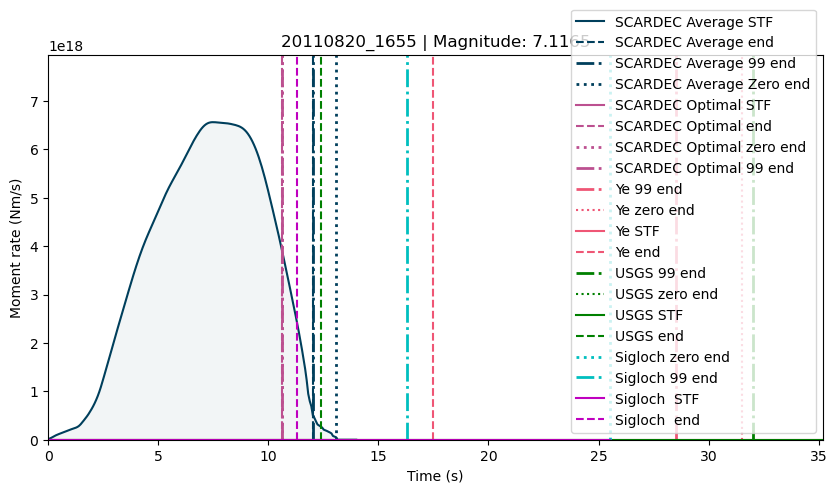

event                             20180123_0634
scardec    FCTs_20180123_063454_JAVA__INDONESIA
ye                                            0
isc                                           0
sigloch                         0259.2009.165.a
usgs                                          0
mag                                    5.922333
Name: 79, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 112]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  81  82  83  84  85  86  94  95  96  97
  98 100 101 102 103 

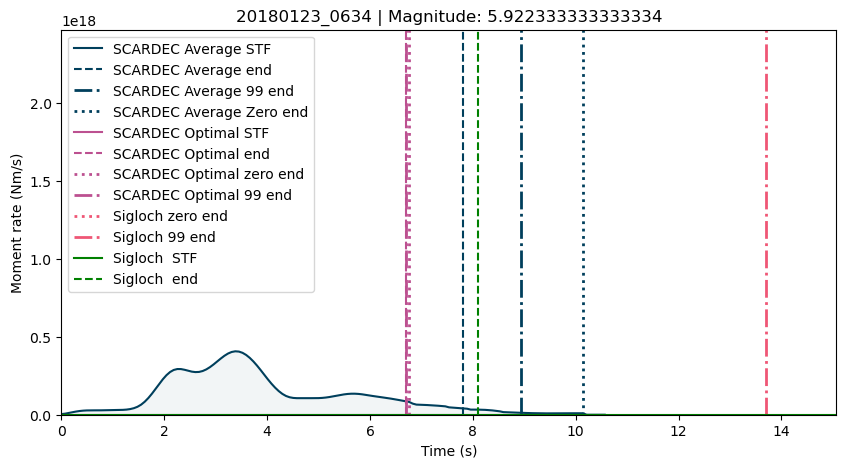

event                                    20100205_0659
scardec    FCTs_20100205_065905_SOUTHEAST_INDIAN_RIDGE
ye                                                   0
isc                                                  0
sigloch                                0435.2010.036.a
usgs                                                 0
mag                                             6.2535
Name: 80, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 216 217 218 219 220 221
 222 223 224 225 226 227 228]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 12

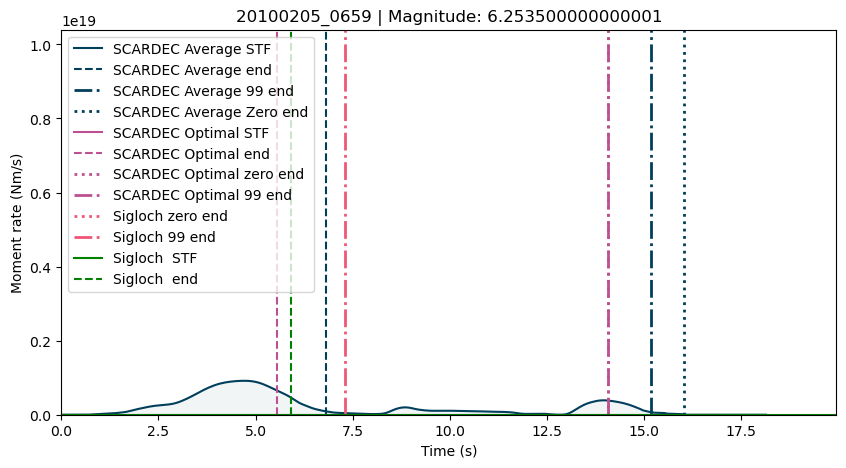

event                            20041107_0202
scardec    FCTs_20041107_020226_SEA_OF_OKHOTSK
ye                                           0
isc                                          0
sigloch                        0663.2004.312.a
usgs                                         0
mag                                     6.1235
Name: 81, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 

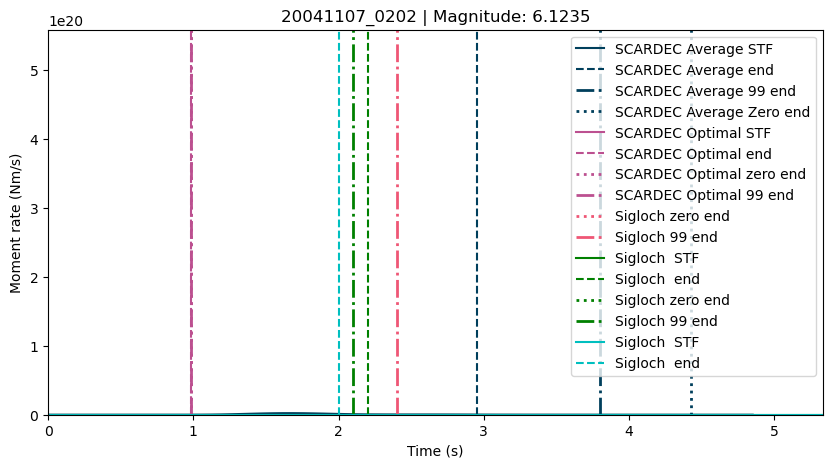

event                                          20030314_0706
scardec    FCTs_20030314_070613_IRIAN_JAYA_REGION__INDONESIA
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.217
Name: 82, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
10.265625


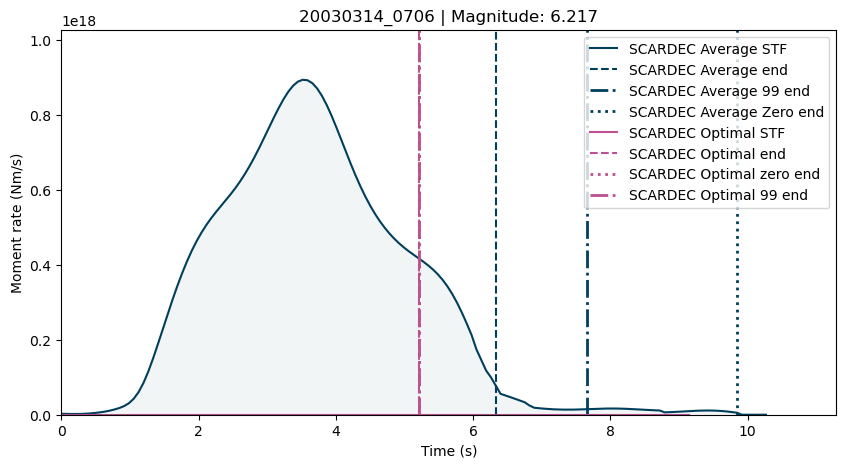

event                                         20170726_1032
scardec    FCTs_20170726_103257_SOUTHEAST_OF_RYUKYU_ISLANDS
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   5.898
Name: 83, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
8.9296875


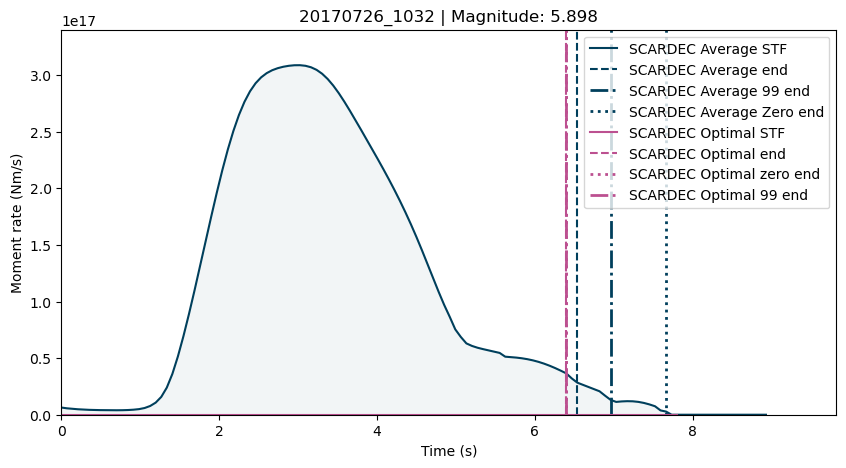

event                                 20131123_0748
scardec    FCTs_20131123_074832_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                             0181.2013.327.a
usgs                                              0
mag                                           6.492
Name: 84, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57

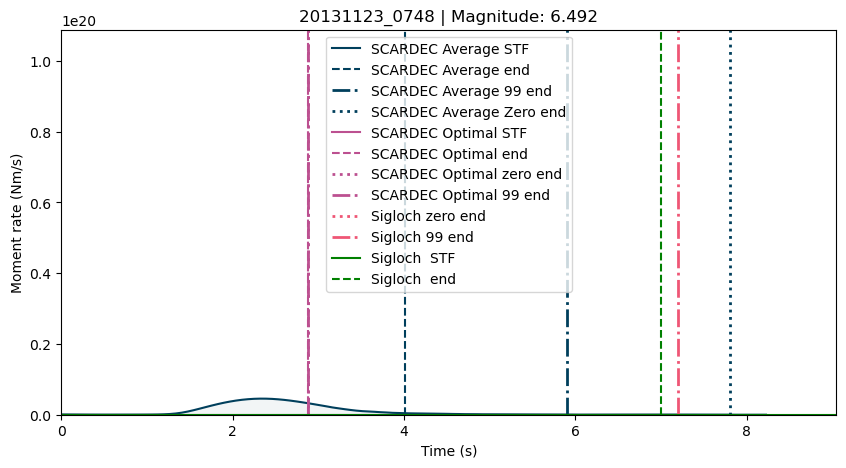

event                                         20091001_0152
scardec    FCTs_20091001_015227_SOUTHERN_SUMATRA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.713
Name: 85, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 233 234 235 236 237 238 239 240 241 242 243 244 245 246
 247 248 249 250 251 252 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 341 342 343 344 345 346 347 348]
17
29.25


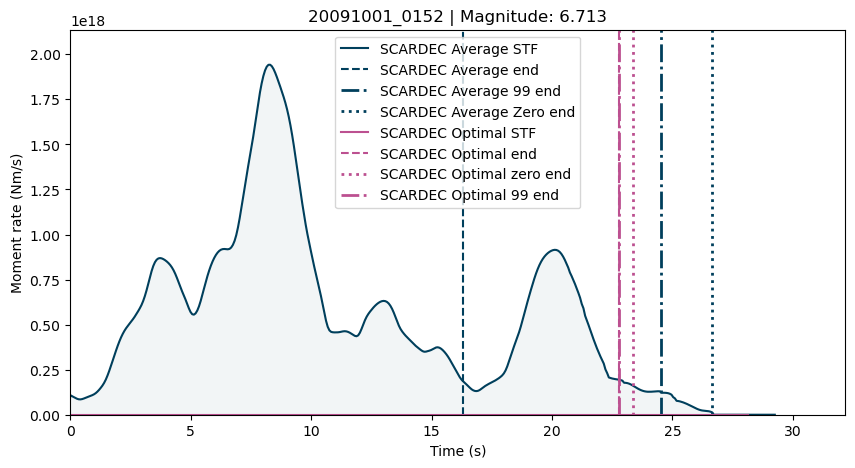

event                                          20110912_2244
scardec    FCTs_20110912_224428_NEAR_N_COAST_OF_NEW_GUINE...
ye                                                         0
isc                                                        0
sigloch                                      0200.2011.255.a
usgs                                                       0
mag                                                   5.9085
Name: 86, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 65
 66]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114

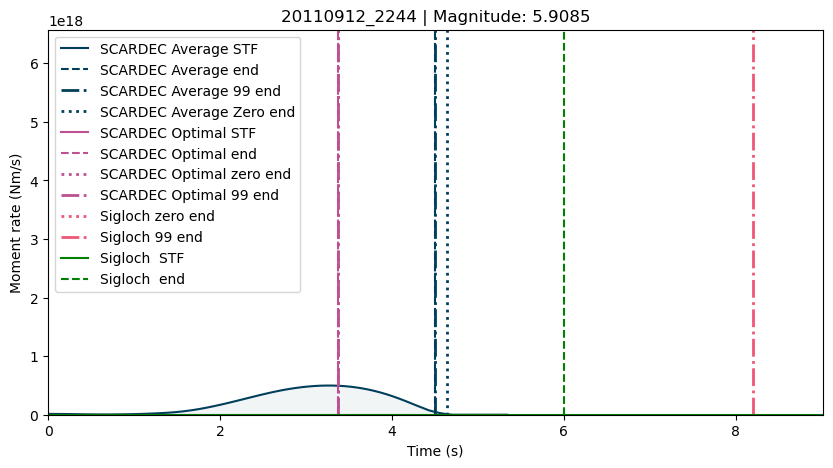

event                                     20181125_1637
scardec    FCTs_20181125_163732_IRAN-IRAQ_BORDER_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.275
Name: 87, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 55 56 57 58 59
 60]
17
13.45300295


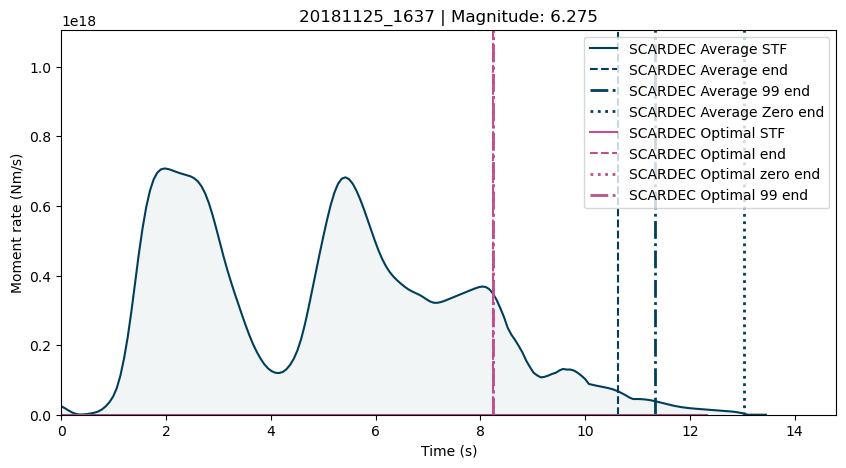

event                                       20110824_1746
scardec    FCTs_20110824_174611_PERU-BRAZIL_BORDER_REGION
ye                                                      0
isc                                                     0
sigloch                                   0112.2011.236.a
usgs                                                    0
mag                                                7.0025
Name: 88, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 103 104 105 106 107 108 109]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91

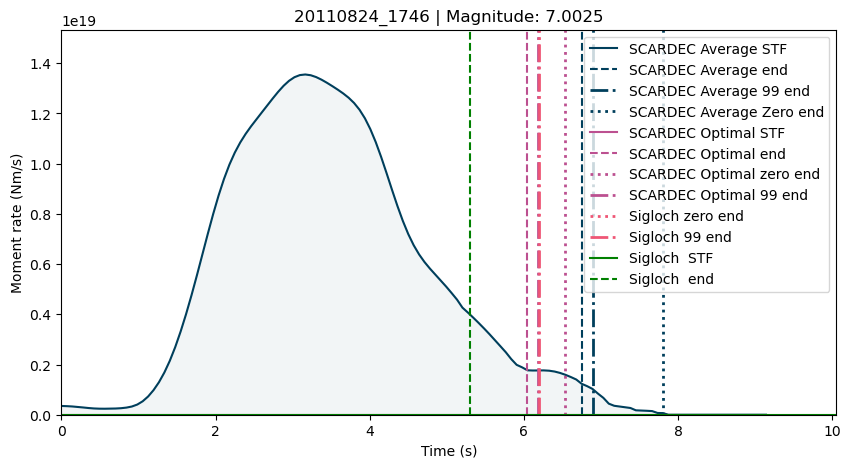

event                             20100104_1128
scardec    FCTs_20100104_112820_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                         0193.2010.004.a
usgs                                          0
mag                                       5.802
Name: 89, dtype: object
3
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 57 58 59 60
 61 62 63 64 65 66 67 68 69 70 71]
3
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119
 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 

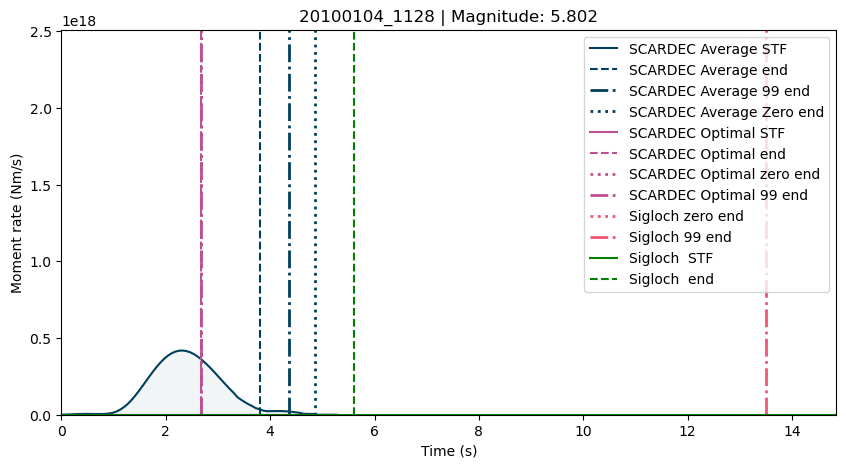

event                                          20190105_1847
scardec    FCTs_20190105_184711_ANDREANOF_ISLANDS__ALEUTI...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.991
Name: 90, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 125 126 127 128 129 130 131 132 137 138]
17
11.69213865


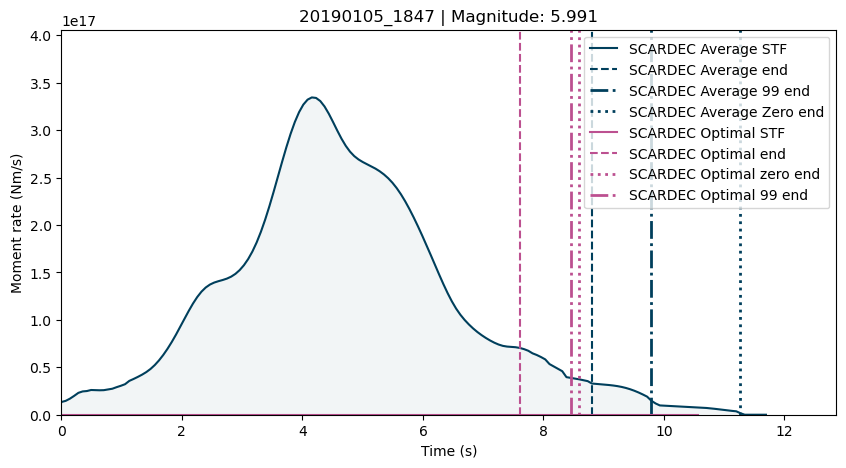

event                                          20041006_2230
scardec    FCTs_20041006_223056_IRIAN_JAYA_REGION__INDONESIA
ye                                                         0
isc                                                        0
sigloch                                      0196.2004.280.a
usgs                                                       0
mag                                                   6.2285
Name: 91, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 190 191 192 193 194 195 196 197 198 199 200 201 202
 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220
 221 222 223 224 225 226 227 228 229 230 231 232 238 239 240 241 242 243
 244 245 246 247 248 249 250 251 252 253 254 255 256 257]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  27  28  29  30  31  32  33  

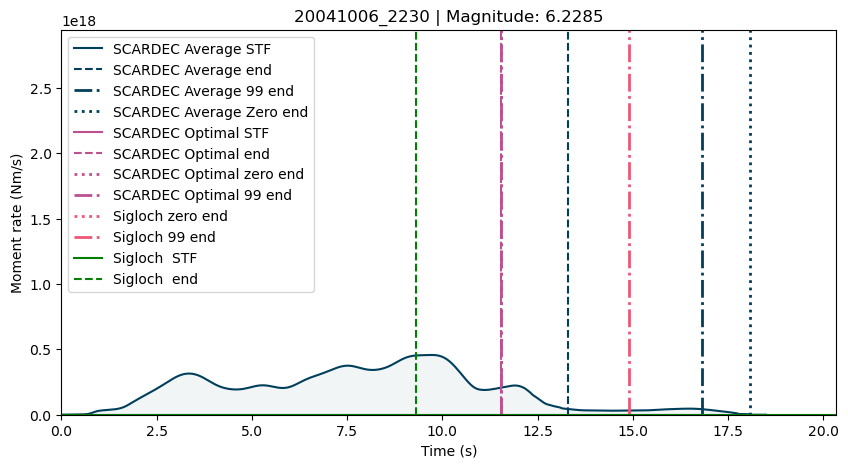

event                                          19930207_1327
scardec    FCTs_19930207_132742_NEAR_WEST_COAST_OF_HONSHU...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.348
Name: 92, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 102 103 104 105]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 104 105]
17
8.7890625


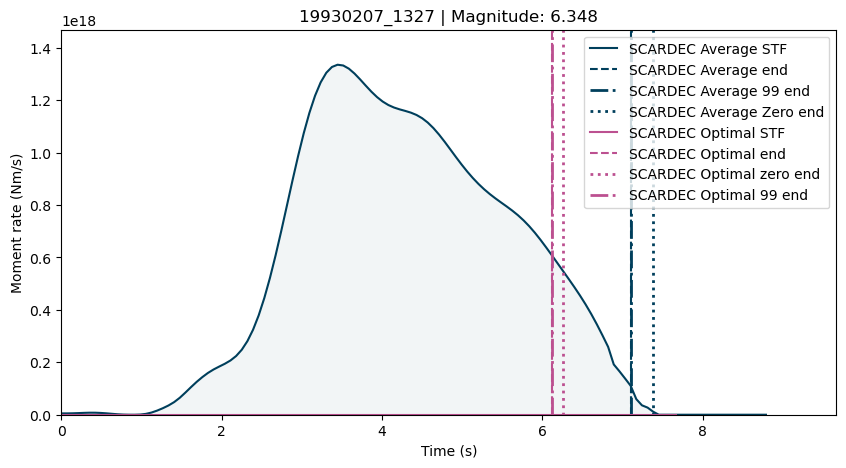

event                                       20021006_1546
scardec    FCTs_20021006_154633_SUMBAWA_REGION__INDONESIA
ye                                                      0
isc                                                     0
sigloch                                   0285.2002.279.a
usgs                                                    0
mag                                                 6.203
Name: 93, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  80  81  82  83  84  85  86  87  88  89  90  91  92 

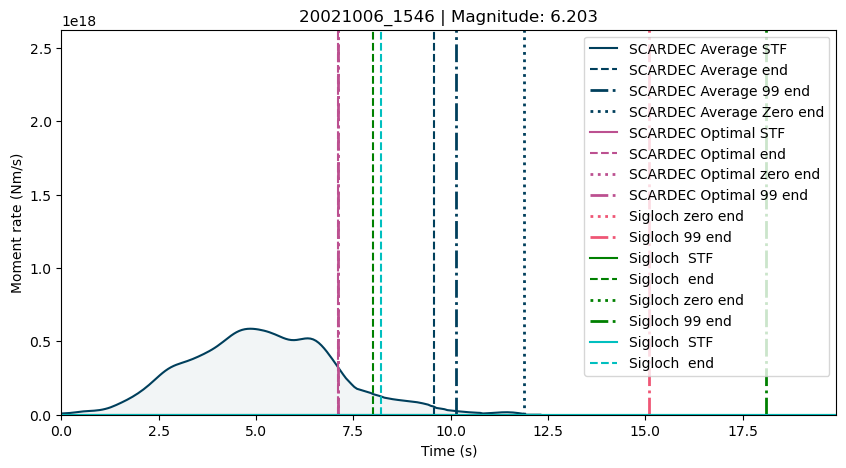

event                             19990214_2112
scardec    FCTs_19990214_211224_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       5.933
Name: 94, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 70 71
 72 73 74 75 76 77 78 79 80 81 82]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 74]
17
6.1875


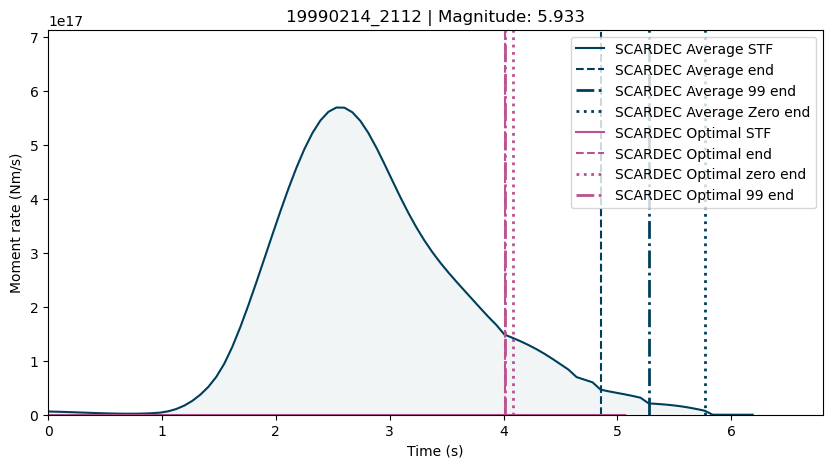

event                                        20070308_0503
scardec    FCTs_20070308_050332_SOUTHEAST_OF_HONSHU__JAPAN
ye                                                       0
isc                                                      0
sigloch                                    0230.2007.067.a
usgs                                                     0
mag                                                 6.0075
Name: 95, dtype: object
5
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 67 68 69 70 71 72 73 74
 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89]
5
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  21  22  23  24  25  26
  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 10

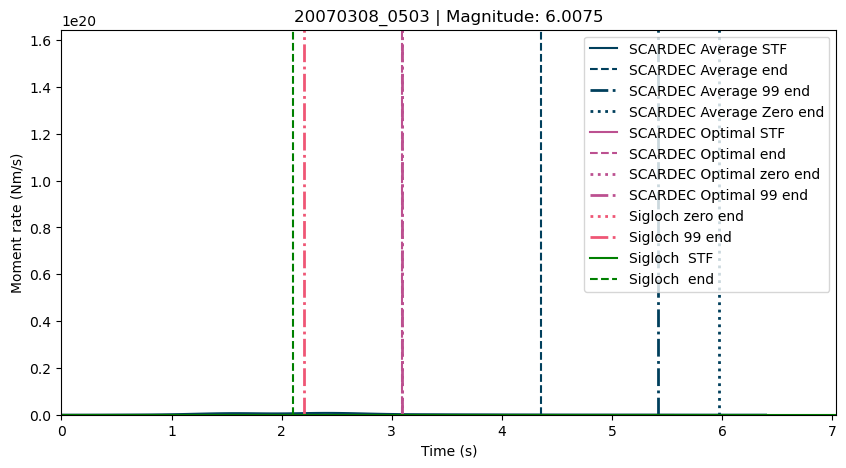

event                                19980716_1156
scardec    FCTs_19980716_115636_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          7.089
Name: 96, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 95 96 97]
17
8.578125


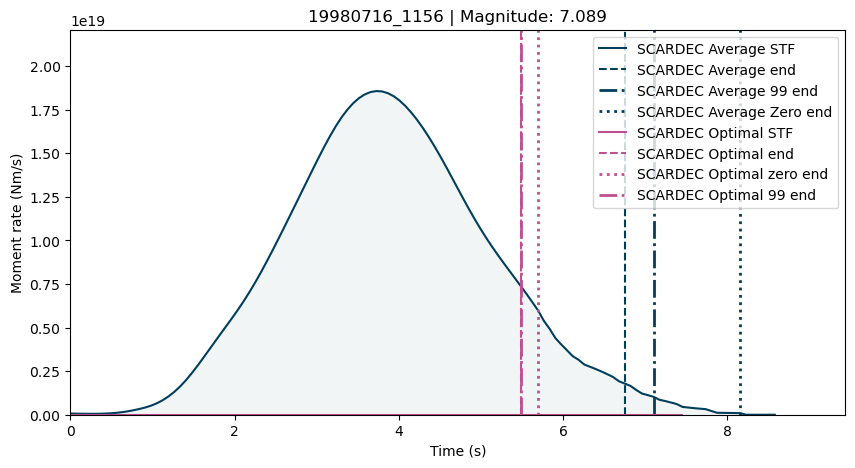

event                           19941016_0510
scardec    FCTs_19941016_051000_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.654
Name: 97, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115
 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133
 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169
 170 171 172 173]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
12.5859375


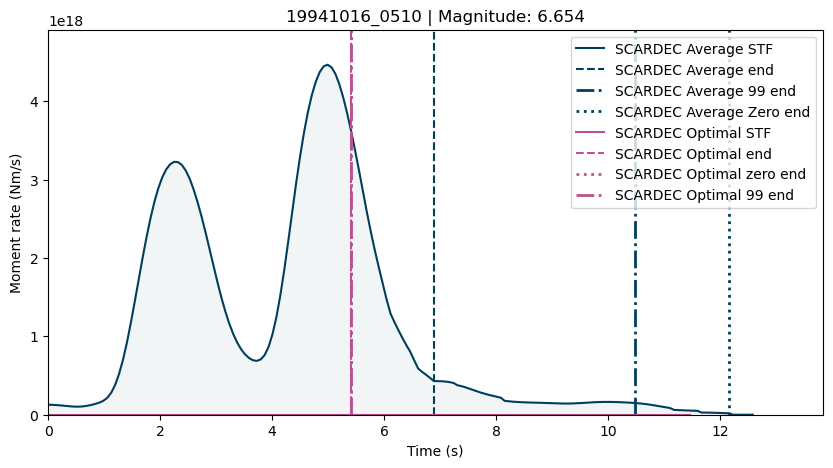

event                                       20061111_1510
scardec    FCTs_20061111_151030_NEW_BRITAIN_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                   0192.2006.315.a
usgs                                                    0
mag                                                 5.942
Name: 98, dtype: object
1
[  0   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27 163 164 165 166 167 168 169 170 171 172
 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24 164]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 10

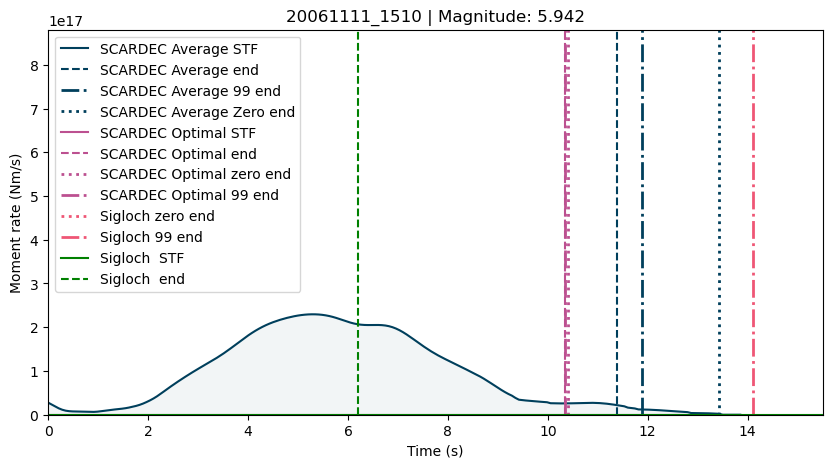

event                  20191120_2350
scardec    FCTs_20191120_235043_LAOS
ye                                 0
isc                                0
sigloch                            0
usgs                               0
mag                            6.178
Name: 99, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 155 156 157 158 159 160 161 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200
 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218
 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
16.97473145


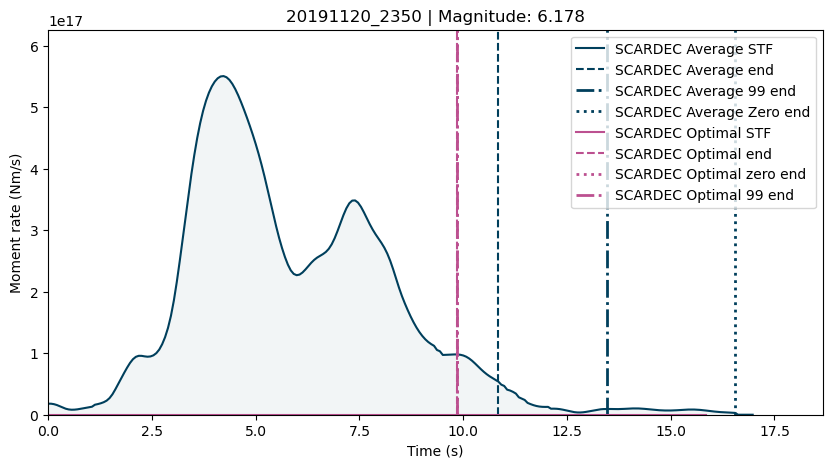

event                           20020824_1840
scardec    FCTs_20020824_184053_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.091
Name: 100, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31 119 120 121 122
 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30 119]
17
11.671875


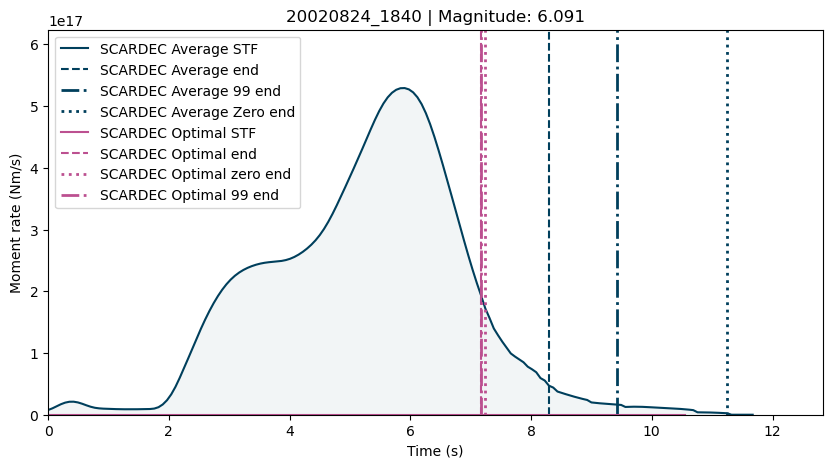

In [26]:
colors = ['#003f5c', '#bc5090', '#ef5675', 'g', 'c', 'm', 'k', 'y']
styles = ['--', '-.', ':', '--', '-.', ':', '--', '-.']
eventcount = 0
already_made = os.listdir('/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/both/')
for i, row in combined.iterrows():
    # if row.event != '20200623_1529':
    #     continue
    # if row.sigloch != '0706.2011.026.a':
    #     continue
    if i > 100:
        continue
    # if row.event + '.png' in already_made:
    #     continue
    lines_count = 0
    count = 0
    print(row)
    sources = 0
    for r in row[1:-1]:
        if r not in [0, '0']:
            sources += 1

    max_end = 0
    y_max = 0
    max_end = 0

    fig, axs = plt.subplots(1, 1, figsize=(10, 5))
    axs = [axs]

    ends_different = False
    count_datasets = 0
    if row.scardec not in ['0', 0]:
        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctmoy')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Average', plot_bar = False)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Average 99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Average Zero end', linewidth = 2)
        max_end = max(max_end, max(time))
        y_max = max(y_max, max(momentrate))
        lines_count += 1

        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctopt')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Optimal', plot_bar = False)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Optimal zero end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Optimal 99 end', linewidth = 2)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.ye not in ['0', 0]:
        momentrate, time = get_ye_stf(row['ye'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Ye 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Ye zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'Ye', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.usgs not in ['0', 0]:
        momentrate, time = get_usgs_stf(row['usgs'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'USGS 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'USGS zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'USGS', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.isc not in ['0', 0]:
        momentrate, time = load_isc(row['isc'])
        momentrate = momentrate[0]
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'ISC  99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label =  'ISC zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'ISC', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.sigloch not in ['0', 0]:
        momentrate_list, time_list = get_sigloch_stf(row['sigloch'])
        for momentrate, time in zip(momentrate_list, time_list):
            momentrate = np.array(momentrate)
            y_max = max(y_max, 10**max(momentrate))
            time = np.arange(0, 25.6, 0.1)#np.array(time)
            detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(10**momentrate, time)
            time = time - detected_start_time # shift to start STF at zero
            detected_end_time = detected_end_time - detected_start_time
            #print(detected_end_time)
            max_end = max(detected_end_time, max_end)
            axs[count] = plot_stf(axs[count], time, 10**momentrate, detected_end_time, colors[lines_count], '--', label_str = 'Sigloch ', plot_bar = False)
            detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            #max_end = max(max_end, detected_zero_end_time)
            axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Sigloch zero end', linewidth = 2)
            detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            max_end = max(max_end, detected_99_end_time)
            axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Sigloch 99 end', linewidth = 2)
            if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
                ends_different = True
            lines_count += 1
        count_datasets += 1

    for ax in axs:
        ax.set_xlim(0, 1.1*max_end)
        ax.set_ylim(0, 1.1*y_max)
        if np.isnan(row.mag) == False:
            ax.set_title(row.event + f' | Magnitude: {row.mag}')
        else:
            ax.set_title(row.event)
    plt.legend()
    if count_datasets >= 2:
        if ends_different is True:
            plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/different/{row.event}.png')
        else:
            plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/same/{row.event}.png')
        # if row.isc not in ['0', 0]:
    #     plt.show()
    #     break
    # else:
    #     plt.close()
    #     continue
    #axs[0].set_yscale('log')
    #plt.close()
    print(max_end)
    plt.show()






event                                       20170818_0259
scardec    FCTs_20170818_025925_NORTH_OF_ASCENSION_ISLAND
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 6.591
Name: 0, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 303 304 305 306 307 308 309 310 311 312 313 314 315 3

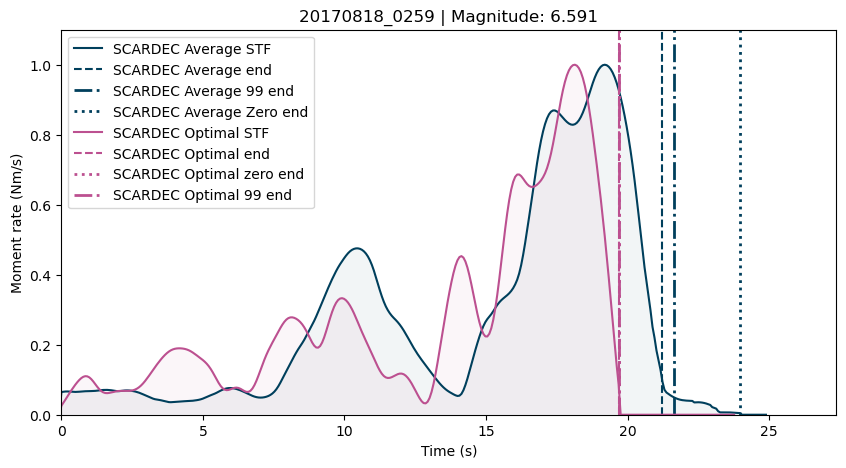

event                                         20110126_1542
scardec    FCTs_20110126_154229_NORTHERN_SUMATRA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                     0706.2011.026.a
usgs                                                      0
mag                                                   6.114
Name: 1, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43 179 180 181 182 183 184 185 186 187 188
 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224
 225 226 227 228 229 230 231 232 233 234 235 236]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  

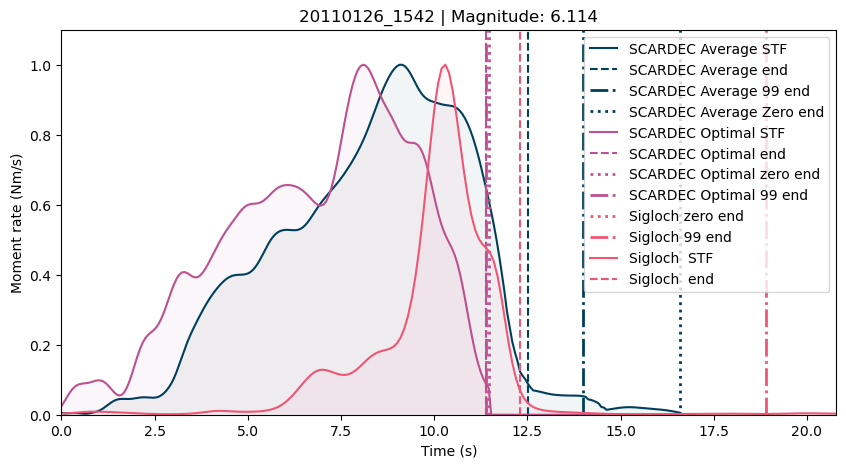

event                                          19981010_1629
scardec    FCTs_19981010_162908_MINAHASSA_PENINSULA__SULA...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.927
Name: 2, dtype: object
13
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116
 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134
 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152
 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170
 171 172 173 174 175 176 177 178]
13
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
12.0937

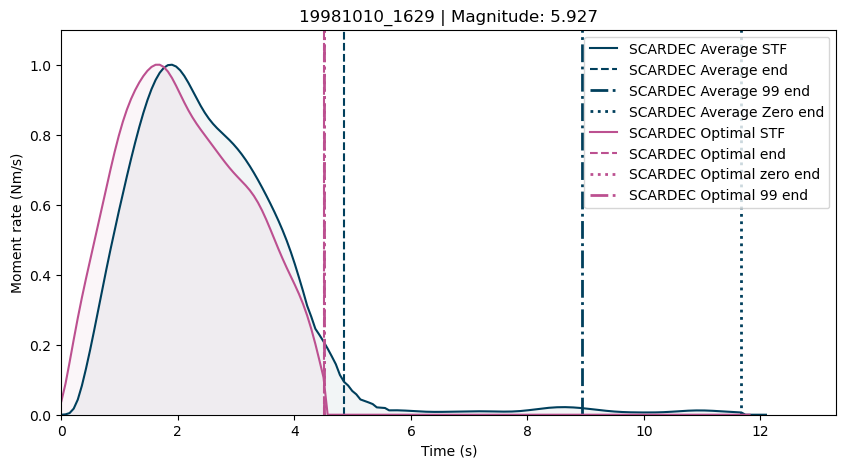

event                    19920730_0824
scardec    FCTs_19920730_082446_XIZANG
ye                                   0
isc                                  0
sigloch                              0
usgs                                 0
mag                              6.017
Name: 3, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39 101 102 103 104 105]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 35 36 37 38
 39]
17
8.296875


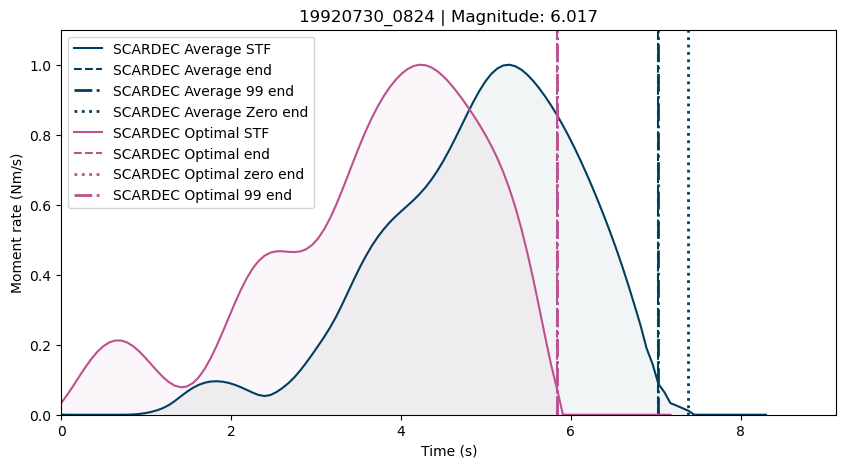

event                                     19960327_2052
scardec    FCTs_19960327_205206_NEAR_COAST_OF_NICARAGUA
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.157
Name: 4, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 296 297 298 299 300 301]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 151 152 153 154 155 156 157 158 159]
17
25.3125


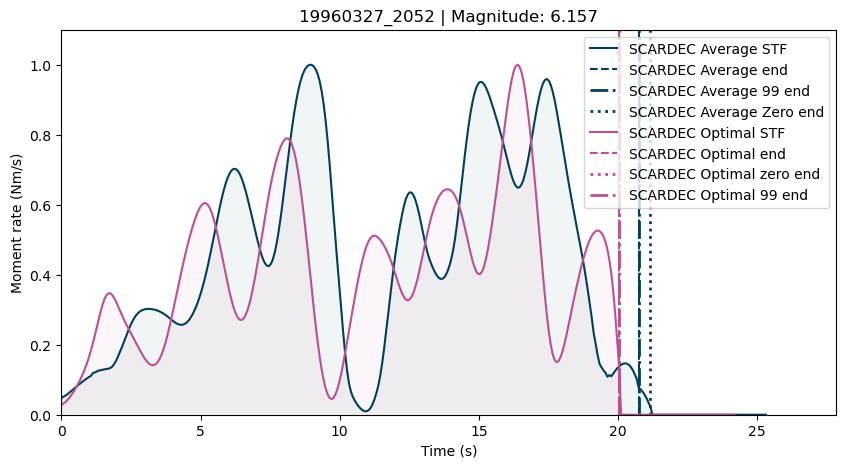

event                                      20011012_1502
scardec    FCTs_20011012_150216_SOUTH_OF_MARIANA_ISLANDS
ye                                                     0
isc                                                    0
sigloch                                  0210.2001.285.a
usgs                                                   0
mag                                               6.9675
Name: 5, dtype: object
11
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194
 195 196 197 198]
11
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 123 124]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  33  34  35  36 

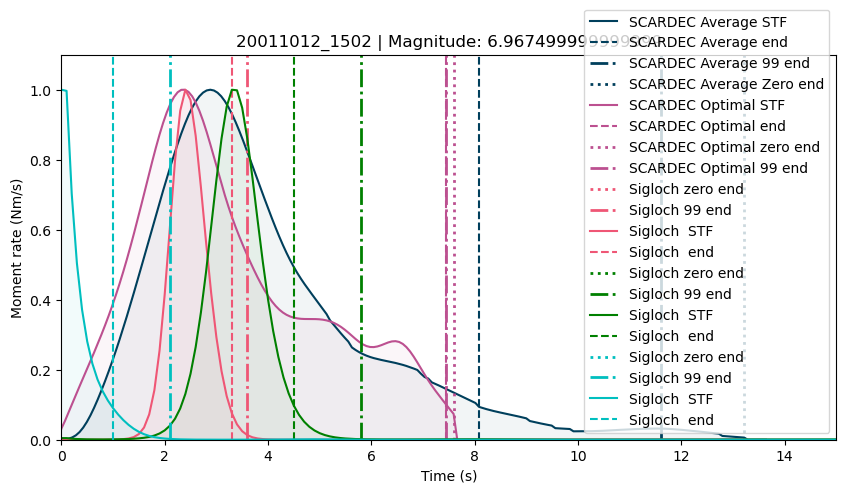

event                                         19960212_0908
scardec    FCTs_19960212_090807_SOUTH_OF_SUMBAWA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.193
Name: 6, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 119 120 121 122 123 216 217 218 219 220]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126]


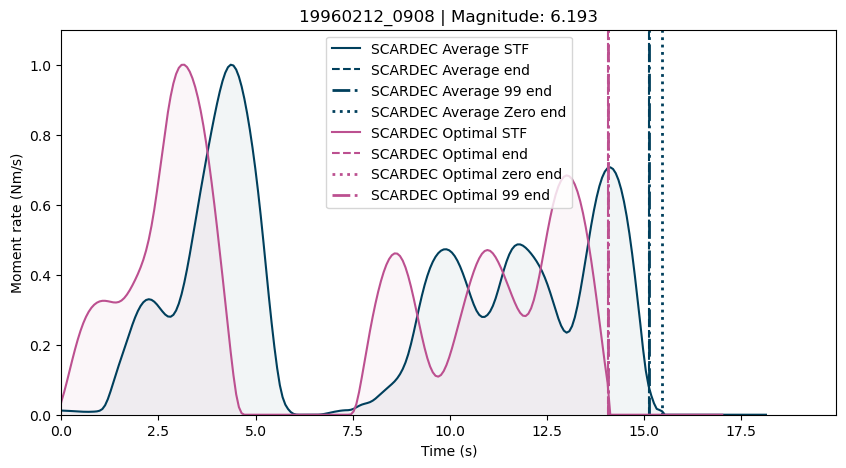

event                                          20120320_1802
scardec    FCTs_20120320_180247_NEAR_COAST_OF_GUERRERO__M...
ye                               201203201802_Mexico.mrf.txt
isc                                                        0
sigloch                                      0058.2012.080.a
usgs                                     20120320_180247.txt
mag                                                    7.387
Name: 7, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 180 181 182 183 184 185 186 187 188
 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 207 208 209 210 211 212 213 214 215 216 217 218 219]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24 188 189]
17
1
[ 0 31 32 33 34 35 36 37 38]
1
1
[  0   1   2   3   4   5   6   7  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81

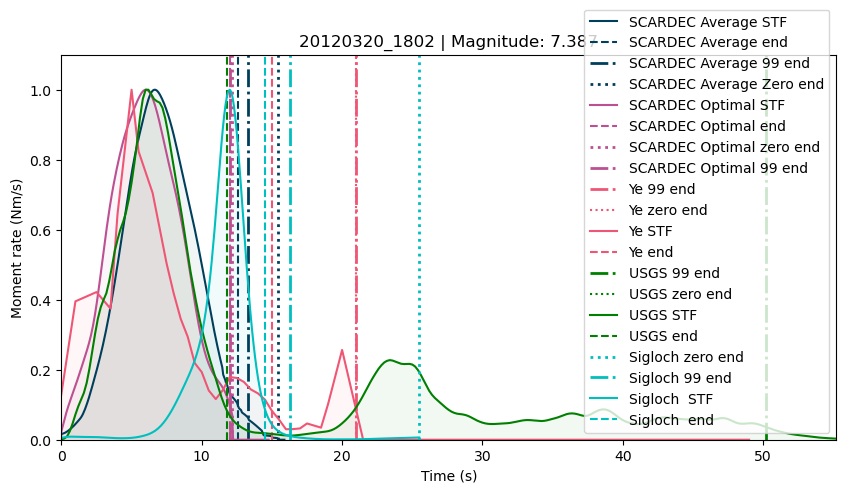

event                             20070402_1202
scardec    FCTs_20070402_120223_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                         0193.2007.092.b
usgs                                          0
mag                                      6.2195
Name: 8, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 79 80 81 82
 83 84 85 86 87 88 89 90 91 92 93 94 95]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 81 82 83 84
 85 86]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  28  29
  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47
  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 

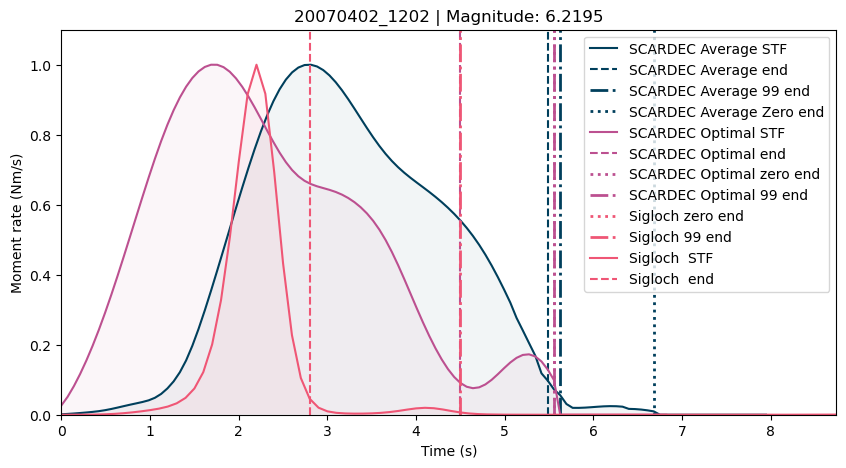

event                             20070427_1349
scardec    FCTs_20070427_134928_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                         5.8
Name: 9, dtype: object
14
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47 102 103 104 105 106 107
 108 109 110 111]
14
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 31 32 33 34
 35 36 37 38 39 40 41 42 43 44 45 46 47]
17
7.59375


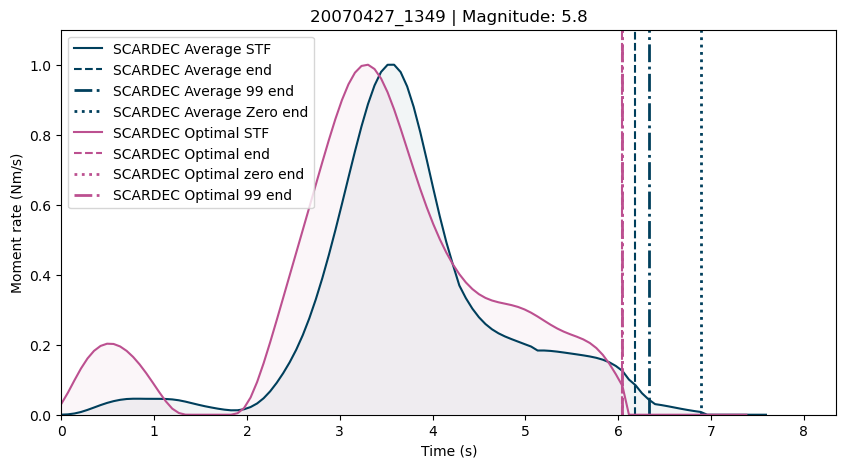

event                           20140904_0533
scardec    FCTs_20140904_053350_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                       0173.2014.247.a
usgs                                        0
mag                                    5.9965
Name: 10, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91
  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127
 128 129 130]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  4

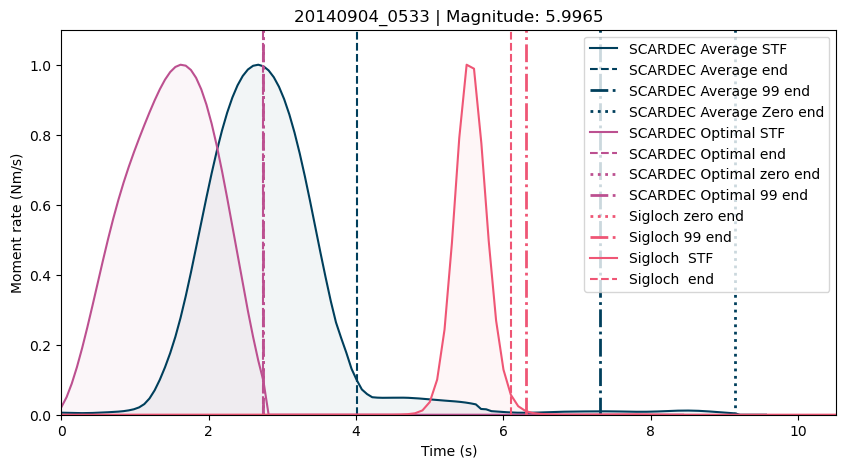

event                                 20040715_0427
scardec    FCTs_20040715_042714_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                             0181.2004.197.a
usgs                                              0
mag                                          7.0725
Name: 11, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  25  26
  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  

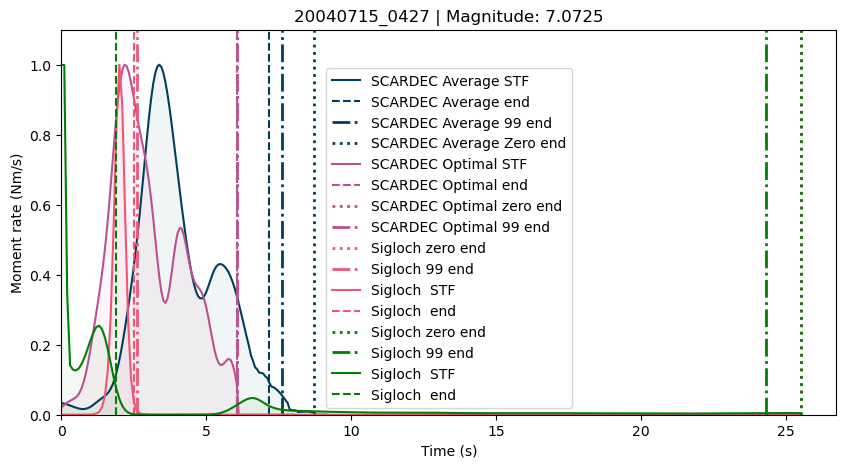

event                                          20080415_2259
scardec    FCTs_20080415_225951_ANDREANOF_ISLANDS__ALEUTI...
ye                                                         0
isc                                                        0
sigloch                                      0007.2008.106.a
usgs                                                       0
mag                                                   6.3925
Name: 12, dtype: object
1
[  0  26  27  28  29  30  31 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59 

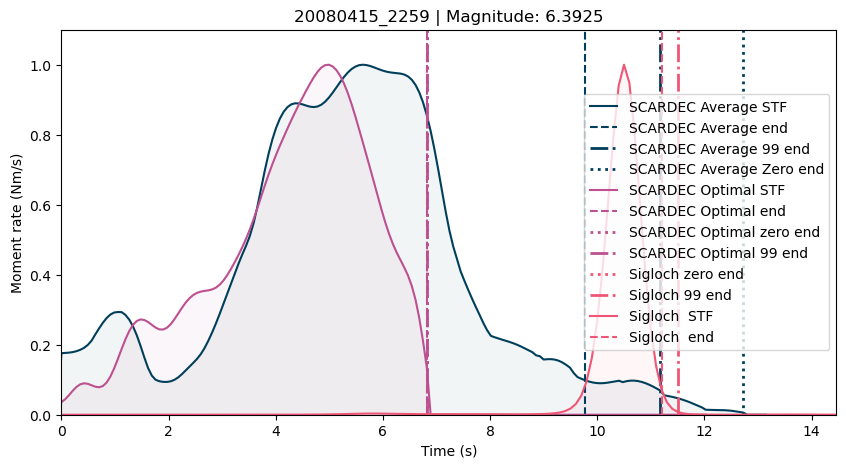

event                             20050505_1912
scardec    FCTs_20050505_191221_SOUTH_OF_PANAMA
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       6.455
Name: 13, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  57  58  59  60  93  94  95  96  97  98  99 100 101 102 103 104
 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122
 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 193 194 195 196 197 198 199 200 201 202 203 204 205 206
 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313
 314 315 316 317 318 319 320 321 322 323 324 325 326 3

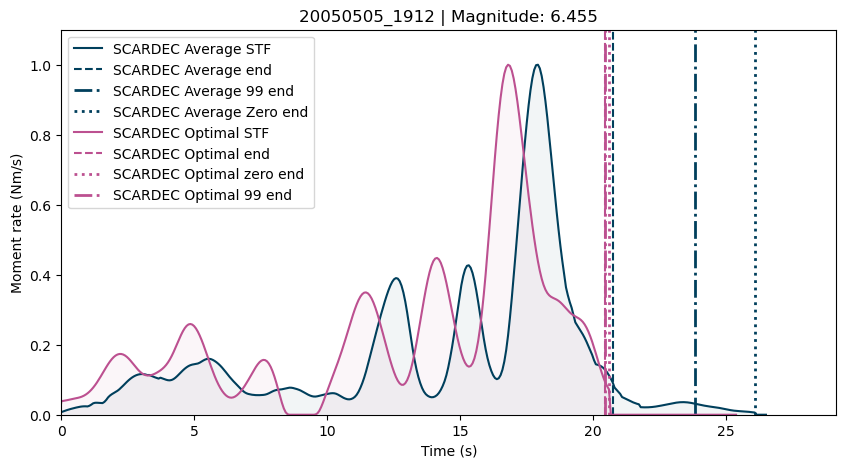

event                       19940713_1145
scardec    FCTs_19940713_114523_BANDA_SEA
ye                                      0
isc                                     0
sigloch                                 0
usgs                                    0
mag                                 6.474
Name: 14, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 57 58 59 60
 61]
17
8.0859375


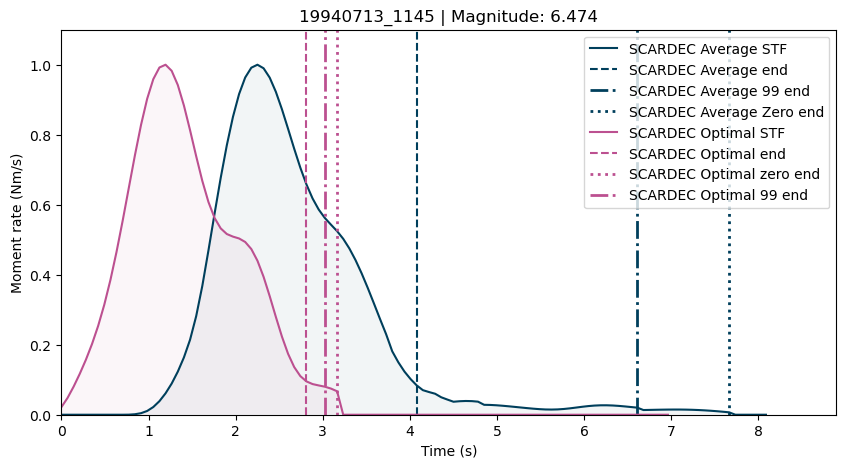

event                                       20111006_1112
scardec    FCTs_20111006_111230_SALTA_PROVINCE__ARGENTINA
ye                                                      0
isc                                                     0
sigloch                                   0129.2011.279.a
usgs                                                    0
mag                                                5.9175
Name: 15, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75
 76 77]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  50  51  52  53  54  55  56  57  58  59  60  61  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105

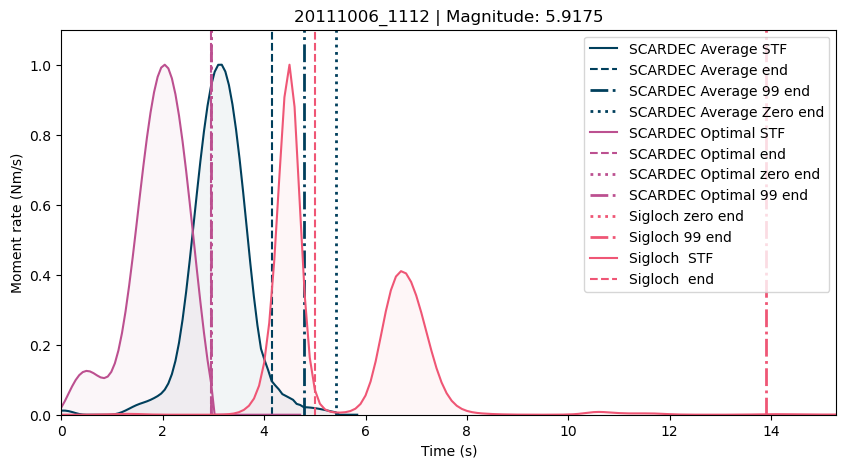

event                                          20030907_1319
scardec    FCTs_20030907_131920_SOUTHEAST_OF_LOYALTY_ISLANDS
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.414
Name: 16, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  20  21  22  23  24 122 123 124
 125 126 127 128 129 130 131 143 144 145 146 147 148 149 150 151 152 219
 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237
 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255
 256 257 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273
 274 275 276 277 278 279 280 281 282 283 284]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
20.390625


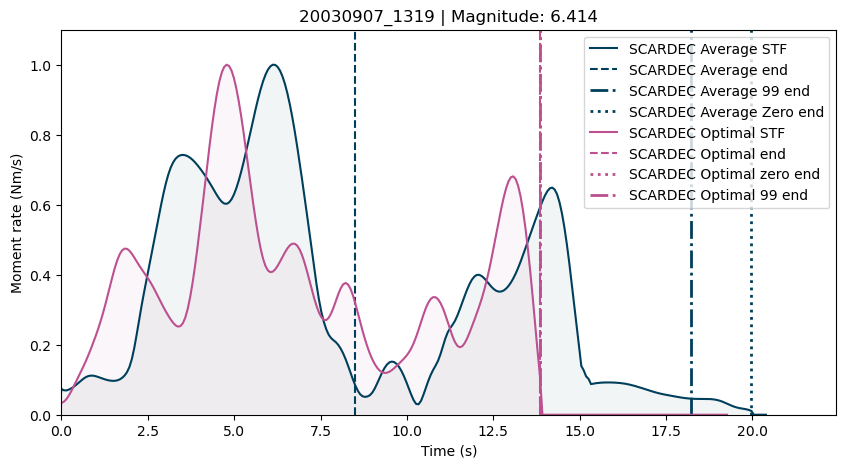

event                             19940713_0235
scardec    FCTs_19940713_023556_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       7.054
Name: 17, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33 247 248
 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310]
1
22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27]
22
22.21875


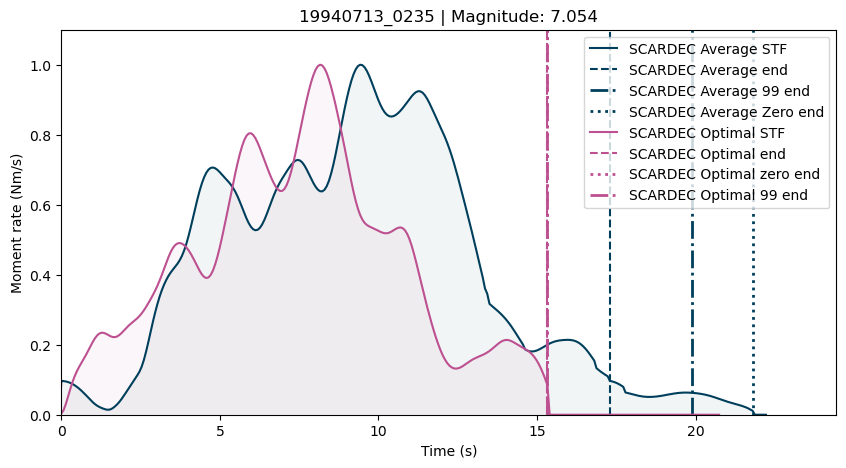

event                                          19980521_2231
scardec    FCTs_19980521_223122_PRINCE_EDWARD_ISLANDS_REGION
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.279
Name: 18, dtype: object
12
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32 180 181 182
 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198]
12
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
14.34375


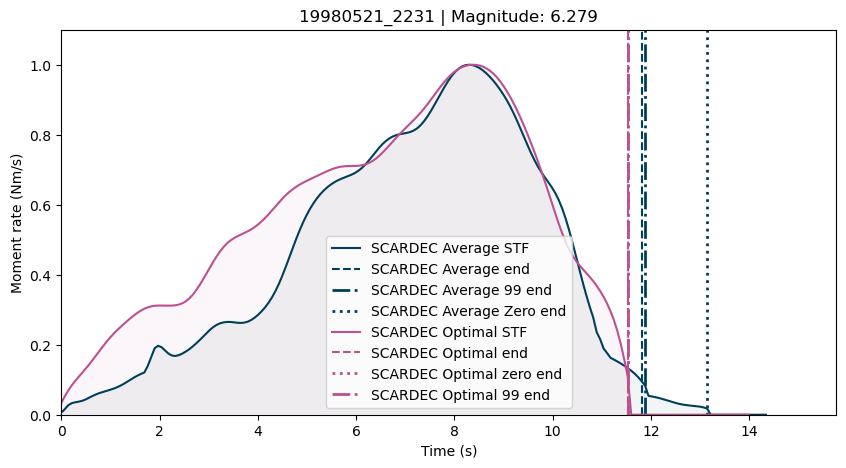

event                       20030825_0628
scardec    FCTs_20030825_062835_GUATEMALA
ye                                      0
isc                                     0
sigloch                   0070.2003.237.a
usgs                                    0
mag                                5.9525
Name: 19, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155
 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173
 174 175 176 177]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  

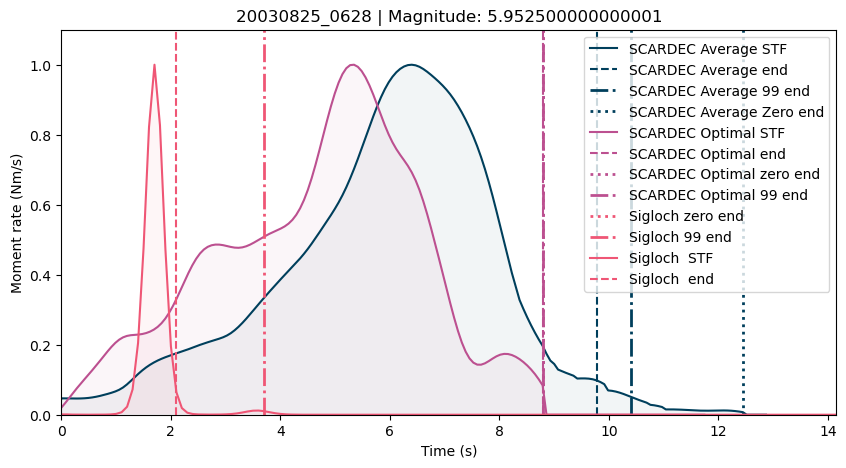

event                                  20060729_1953
scardec    FCTs_20060729_195343_NORTH_ATLANTIC_OCEAN
ye                                                 0
isc                                                0
sigloch                                            0
usgs                                               0
mag                                            5.525
Name: 20, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 46 47]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
3.7265625


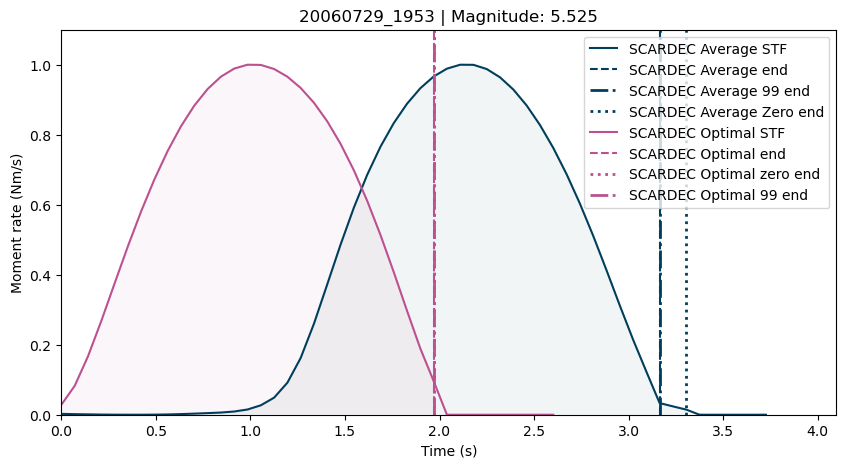

event                             20160407_0332
scardec    FCTs_20160407_033253_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       6.691
Name: 21, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 160]
17
13.640625


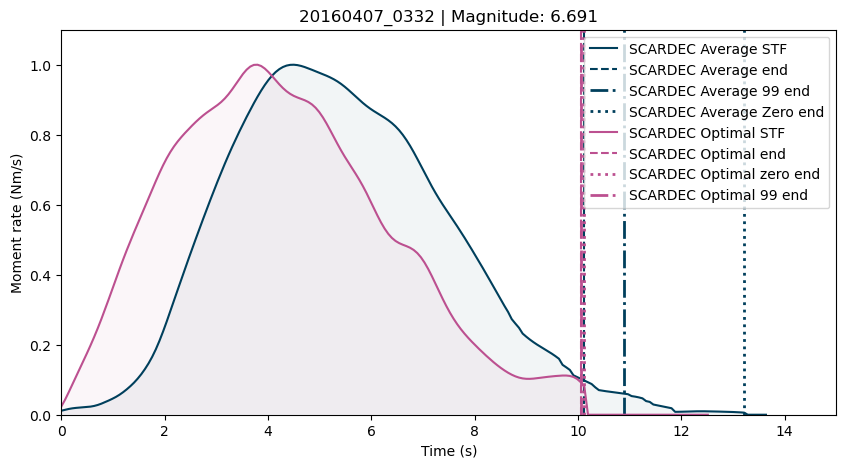

event                           19990508_1944
scardec    FCTs_19990508_194435_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     5.836
Name: 22, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 37 38 39 40 41
 42 43 44 45 46 47 48 49 50]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
3.9375


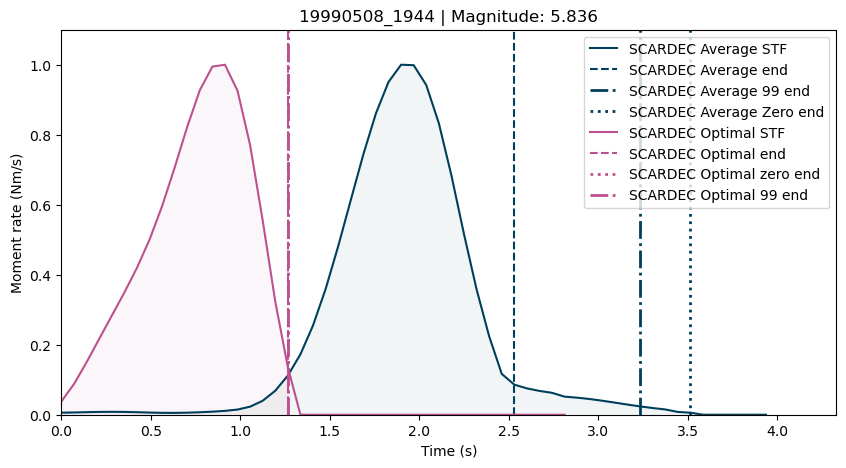

event                                        20181013_1110
scardec    FCTs_20181013_111022_NORTHWEST_OF_KURIL_ISLANDS
ye                                                       0
isc                                                      0
sigloch                                                  0
usgs                                                     0
mag                                                  6.672
Name: 23, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  98  99 100 101 102 103 104 105 106 107 108
 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 91]
17
11.33996585


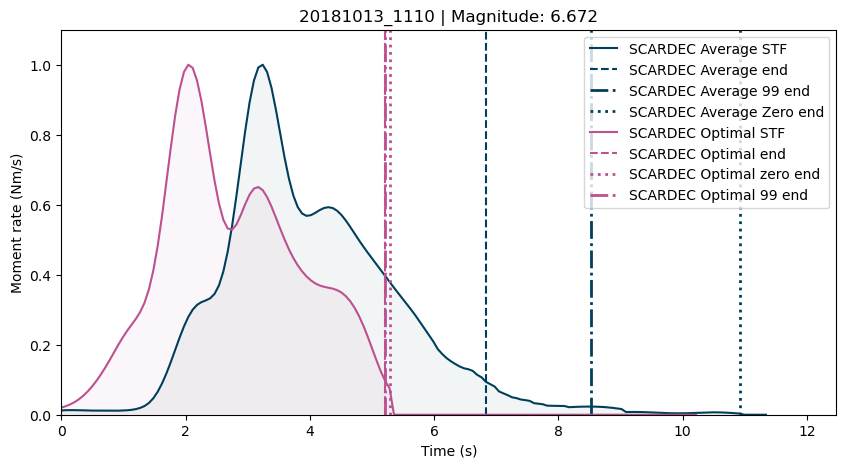

event                                         20150918_1559
scardec    FCTs_20150918_155942_NORTHERN_MID-ATLANTIC_RIDGE
ye                                                        0
isc                                                       0
sigloch                                     0049.2009.217.a
usgs                                                      0
mag                                                6.010667
Name: 24, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 105 106 107 108 109 110 111 112 113 114 115 116]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37
  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55
  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73
  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  

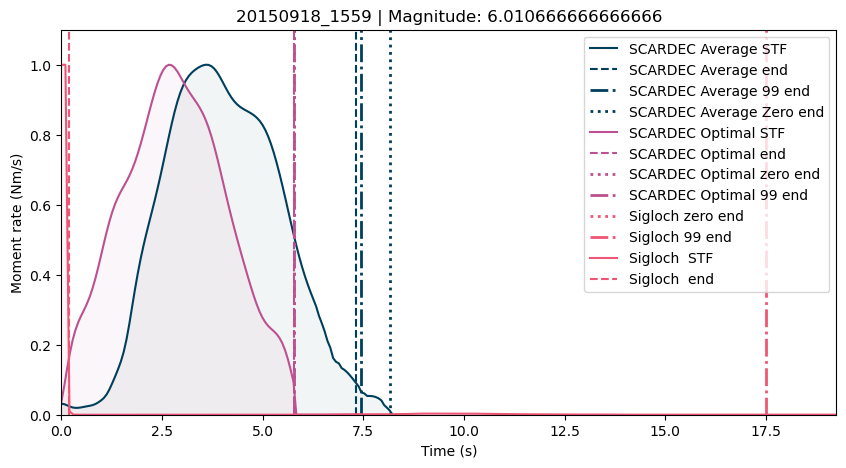

event                           20050726_1411
scardec    FCTs_20050726_141136_SOUTHERN_PERU
ye                                          0
isc                                         0
sigloch                       0117.2005.207.a
usgs                                        0
mag                                     5.891
Name: 25, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  21  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 

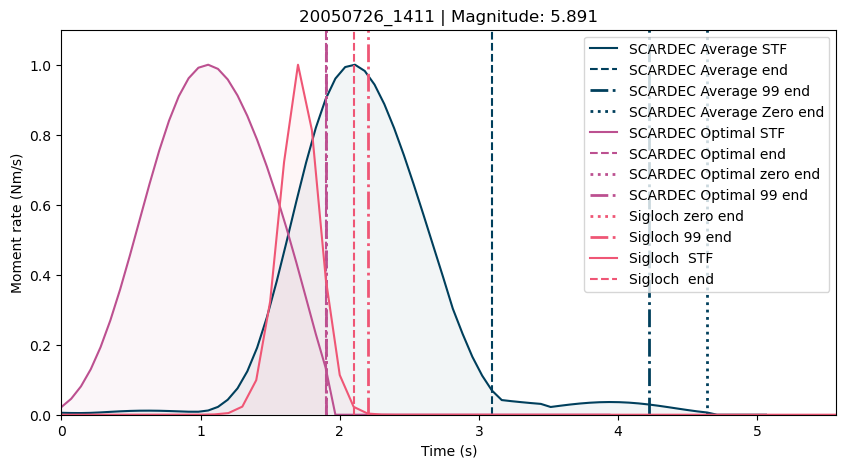

event                                          20110915_0800
scardec    FCTs_20110915_080009_NEAR_EAST_COAST_OF_HONSHU...
ye                                                         0
isc                                                        0
sigloch                                      0228.2011.258.a
usgs                                                       0
mag                                                   6.1785
Name: 26, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 135 136 137 138 139 140 141 142 143 144 145 146 147
 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165
 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183
 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201
 202 203 204 205 206 207 208 209 210 211 212 213 214 215]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 185]
17
0
[  0   1   2   3   4   5   

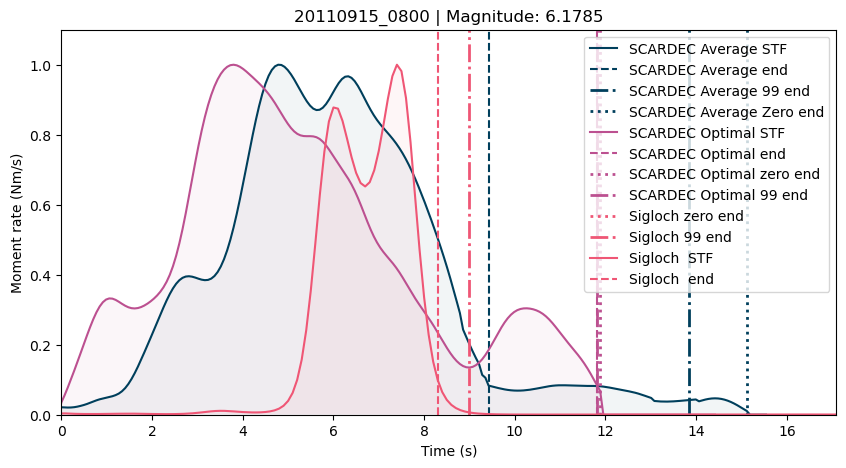

event                                          20171031_0042
scardec    FCTs_20171031_004208_SOUTHEAST_OF_LOYALTY_ISLANDS
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.463
Name: 27, dtype: object
1
[  0   1   2   3   4   5   6   7   8 151 152 153 154 155 156 157 158 159
 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177
 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195
 196 197 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213
 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231
 232 233 234 235 236 237 238 239 240 241 242 243 244 245 246 247 248 249
 250 251 252 253 254 255 256 257 258 259 260 261 262 263 264 265 266 267
 268 269 270 271 272 273 274 357 358

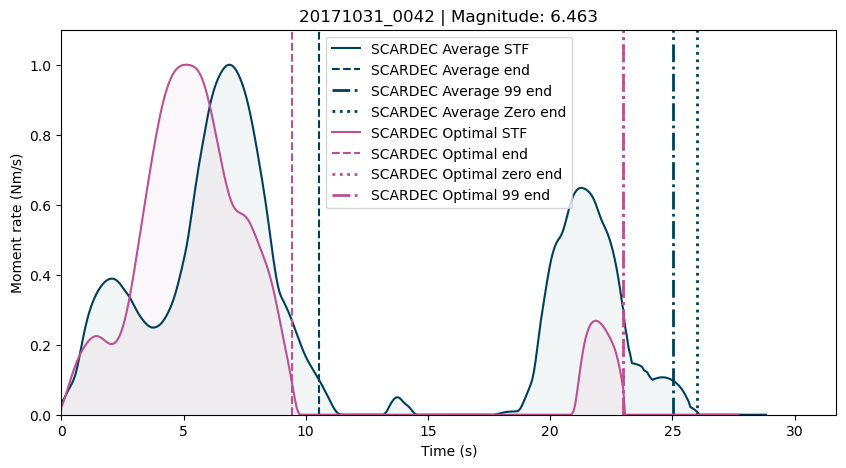

event                           20171104_0900
scardec    FCTs_20171104_090019_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.587
Name: 28, dtype: object
1
[  0  12  13  14  15 141 142 143 144 145 146 147 148 149 183 184 185 186
 187 188 189 190 191 192 193 194 195]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96 130 131 132]
17
14.1328125


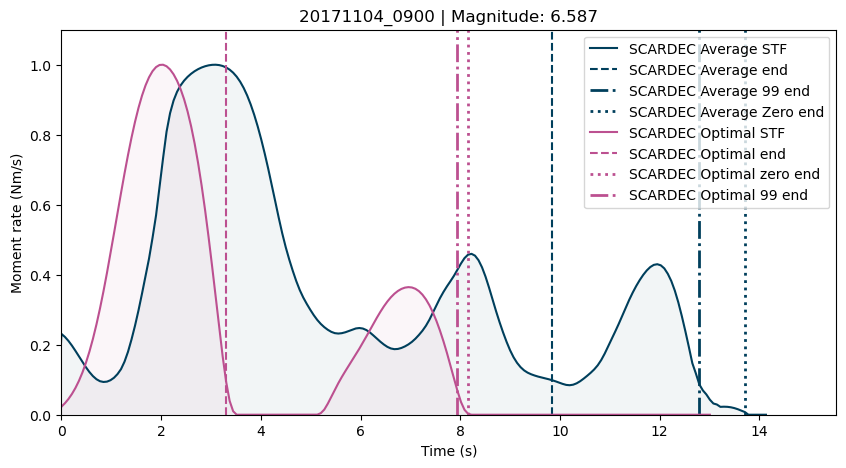

event                                          20221025_0013
scardec    FCTs_20221025_001301_SOUTH_SANDWICH_ISLANDS_RE...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.282
Name: 29, dtype: object
3
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 58 59 60]
3
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
4.507812504


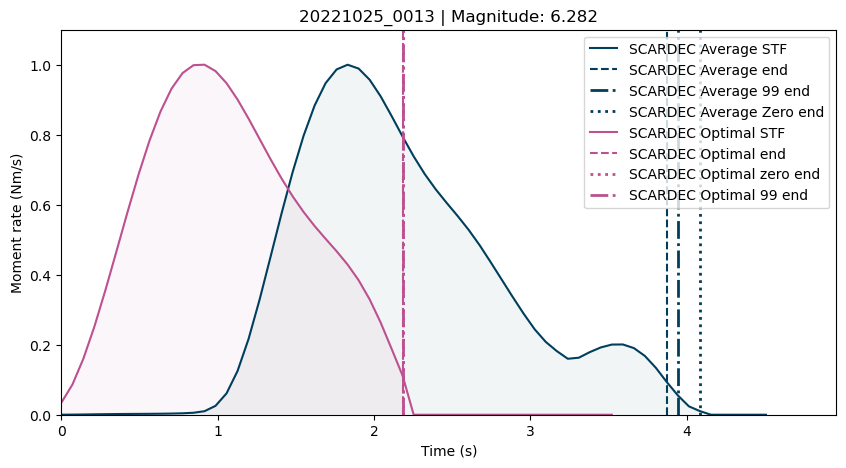

event                                          20180814_0329
scardec    FCTs_20180814_032952_SOUTH_SANDWICH_ISLANDS_RE...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.995
Name: 30, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
7.53649902


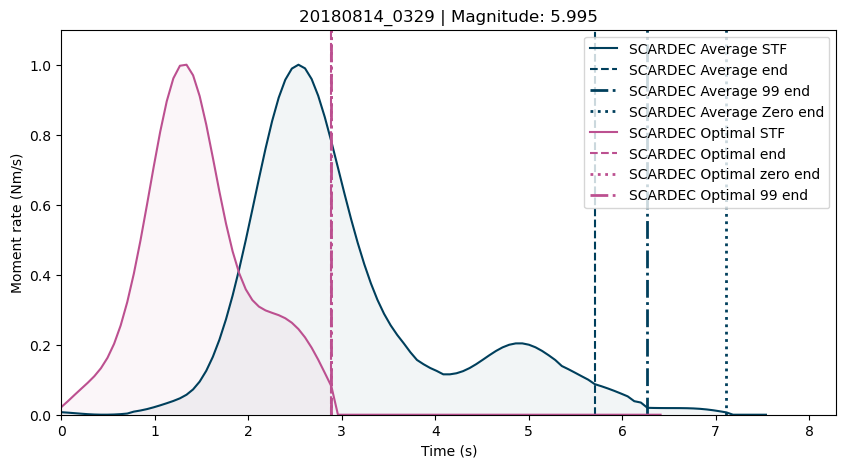

event                                    20211126_0413
scardec    FCTs_20211126_041321_VANUATU_ISLANDS_REGION
ye                                                   0
isc                                                  0
sigloch                                              0
usgs                                                 0
mag                                              5.858
Name: 31, dtype: object
14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 42 43 44 45]
14
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
2.676513671


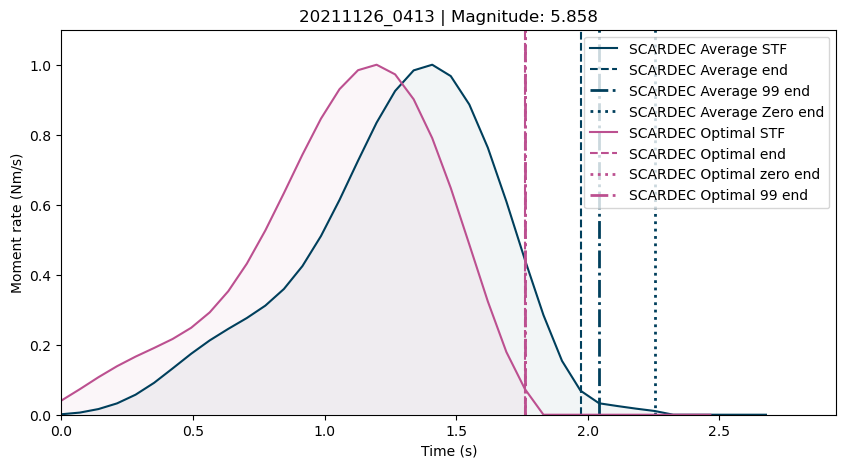

event                                    20130202_1417
scardec    FCTs_20130202_141735_HOKKAIDO__JAPAN_REGION
ye                                                   0
isc                                                  0
sigloch                                0224.2013.033.a
usgs                                                 0
mag                                              6.919
Name: 32, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 165 166 167 168 169 170 171 172 173 174 175]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 14

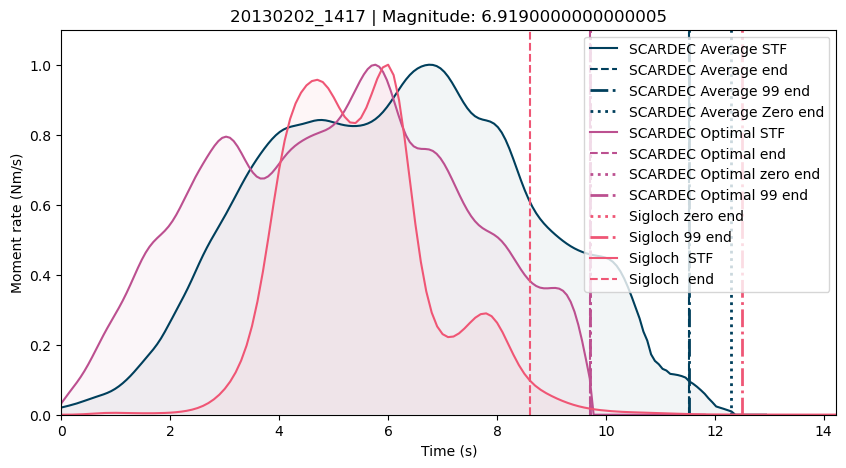

event                       20030309_1036
scardec    FCTs_20030309_103623_BANDA_SEA
ye                                      0
isc                                     0
sigloch                   0280.2003.068.a
usgs                                    0
mag                                5.8925
Name: 33, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 46 47 48
 49 50 51]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  16  17  18  19  20  21  22
  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40
  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58
  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 1

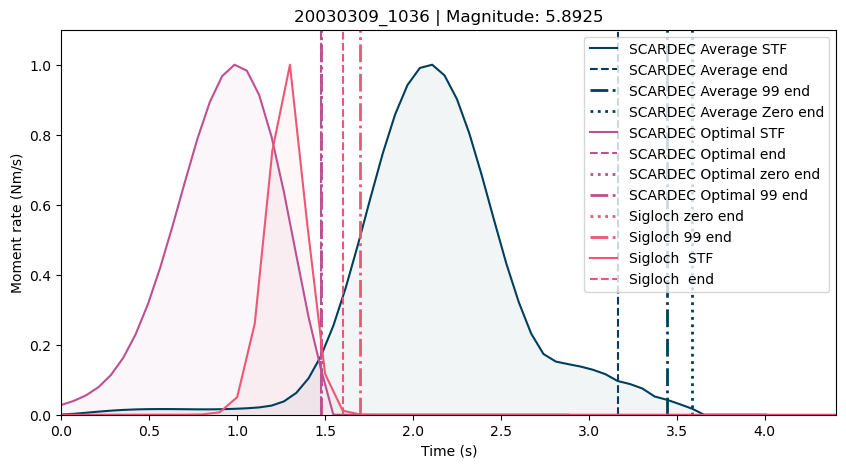

event                                       19990119_0335
scardec    FCTs_19990119_033533_NEW_IRELAND_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 7.017
Name: 34, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41 336 337 338 339 340 341 342 343 344 345 346 347
 348 349 350 351 352 353 354 355 356]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40 334 335 336 337 338 339 340 341 342 343 344]
17
28.96875


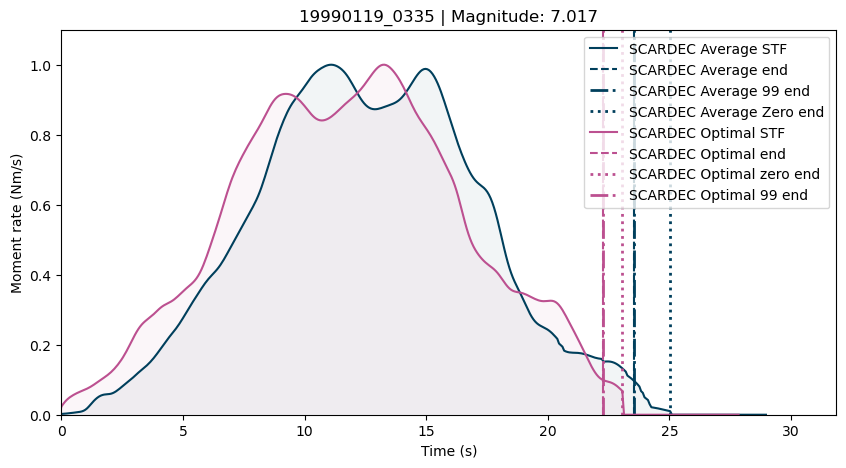

event                                20011202_0247
scardec    FCTs_20011202_024756_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                            0184.2001.336.a
usgs                                             0
mag                                         6.0035
Name: 35, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 71 72 73 74 75 76 77 78 79]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 76]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  21  22
  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40
  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58
  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  

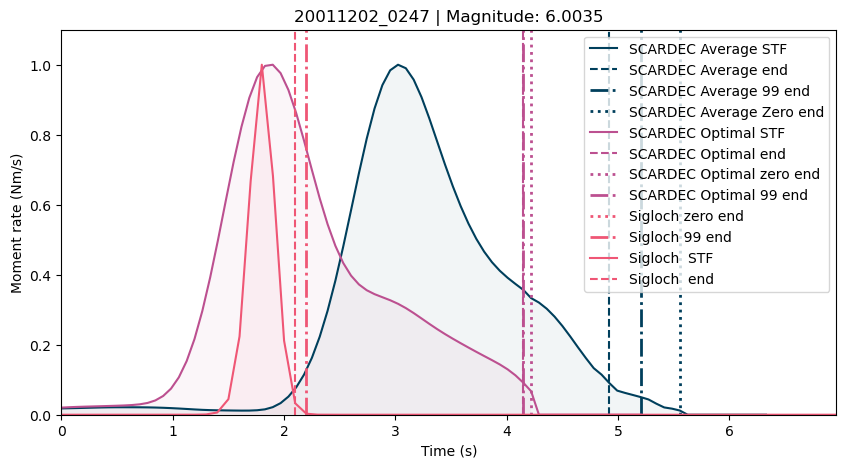

event                                19970512_1345
scardec    FCTs_19970512_134526_PANAY__PHILIPPINES
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          6.006
Name: 36, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 128
 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148 149 150]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 54 55
 56 57 58 59]
17
12.5859375


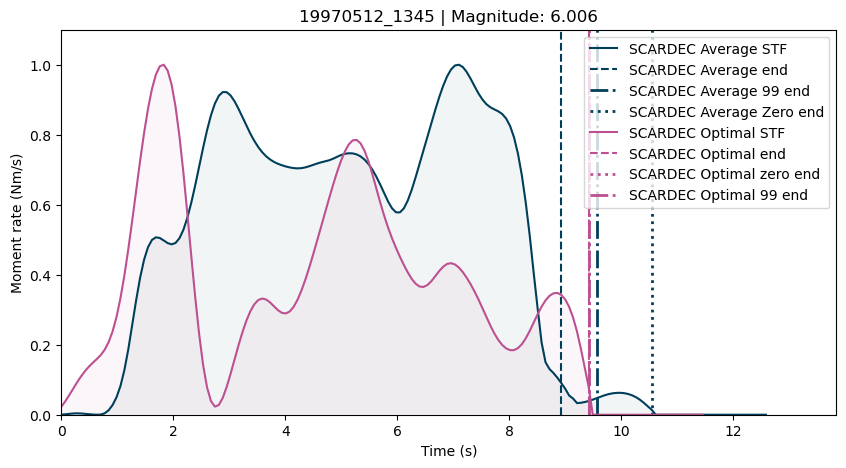

event                           20000126_1326
scardec    FCTs_20000126_132650_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.343
Name: 37, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128
 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146
 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35]
17
13.5


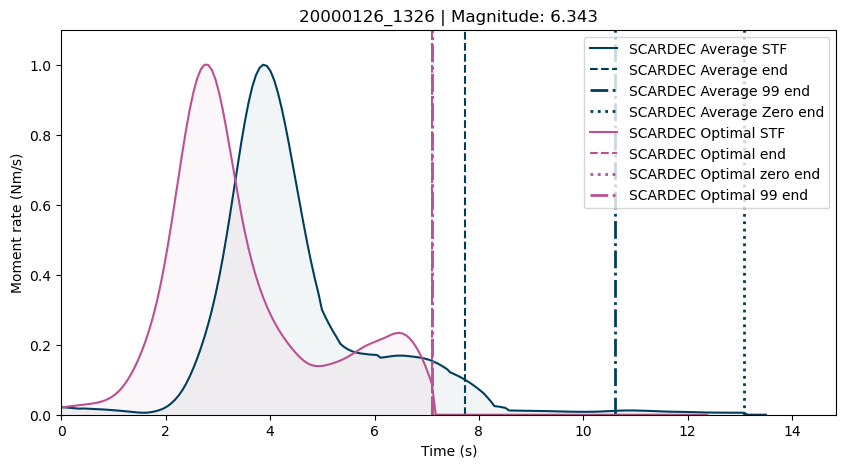

event                                     20120925_2345
scardec    FCTs_20120925_234524_BAJA_CALIFORNIA__MEXICO
ye                                                    0
isc                                                   0
sigloch                                 0048.2012.269.a
usgs                                                  0
mag                                              6.2535
Name: 38, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 83 84 85 86]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  88  89  90  91  92  93  94  95  96  97  98  99 100
 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 13

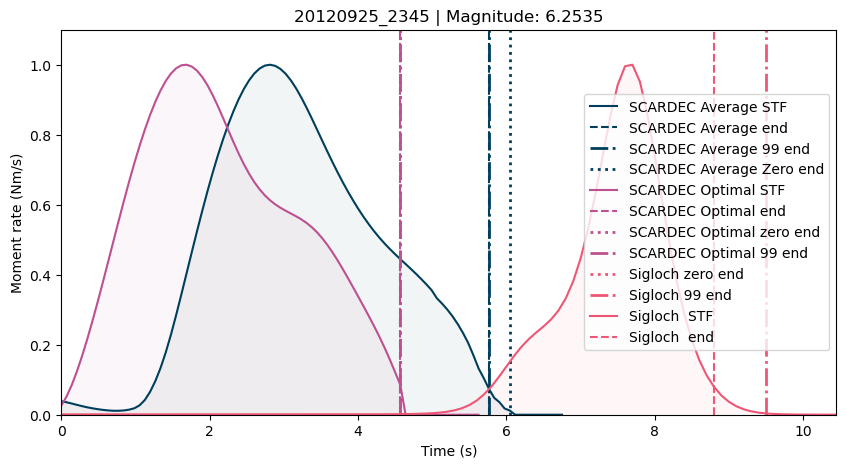

event                                         20190120_0132
scardec    FCTs_20190120_013252_NEAR_COAST_OF_CENTRAL_CHILE
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.751
Name: 39, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26 200 201 202 203 204 205 206 207 208
 209 210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226
 227 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297 298]
1
17
[  0   1   2   3   4   5   6   7   8 

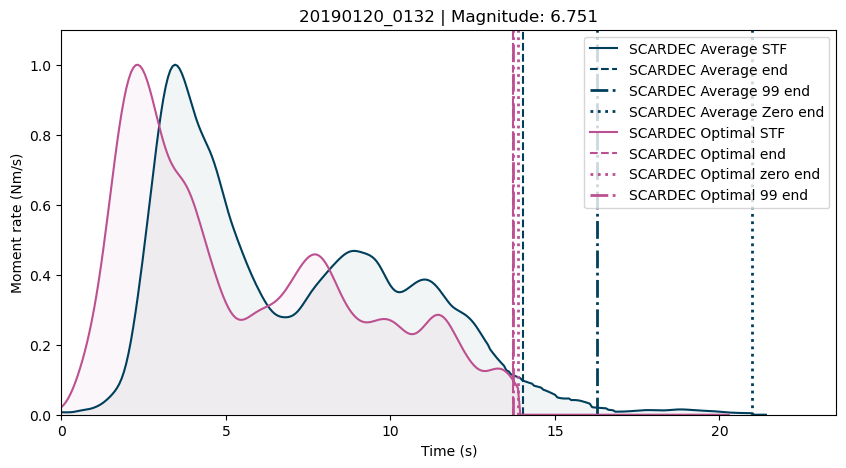

event                           20061226_1226
scardec    FCTs_20061226_122621_TAIWAN_REGION
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     7.113
Name: 40, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 257 258 259 260 261 262 263 264 265 266
 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281 282 283 284
 285 286 287 288 289 290 291 292 293 294 295 296 297 298 299 300 301 302
 303 304 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320
 321 322 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338
 339 340 341 342 343 344 345 346 347 348 349 350 351 352 487 488 489 490
 491 492 493 494 495 496 497 498 499 500 501 502 503 504 505 506 507 508
 509 510 511 512 513 514 515 516 517 518 519 520 521 522 523]
1
17
[

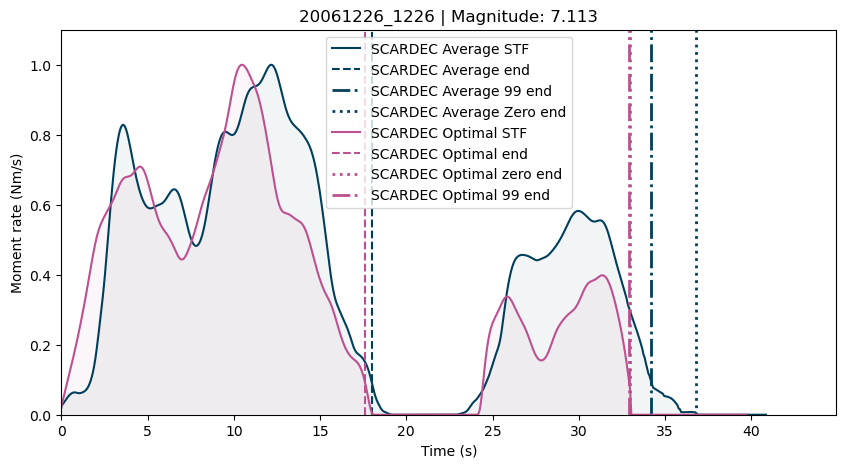

event                            20100630_0722
scardec    FCTs_20100630_072227_OAXACA__MEXICO
ye                                           0
isc                                          0
sigloch                        0060.2010.181.a
usgs                                         0
mag                                     6.2475
Name: 41, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131
 132 133 134 135 136 137 138 139 140 141 142 143 144 145]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 122]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102

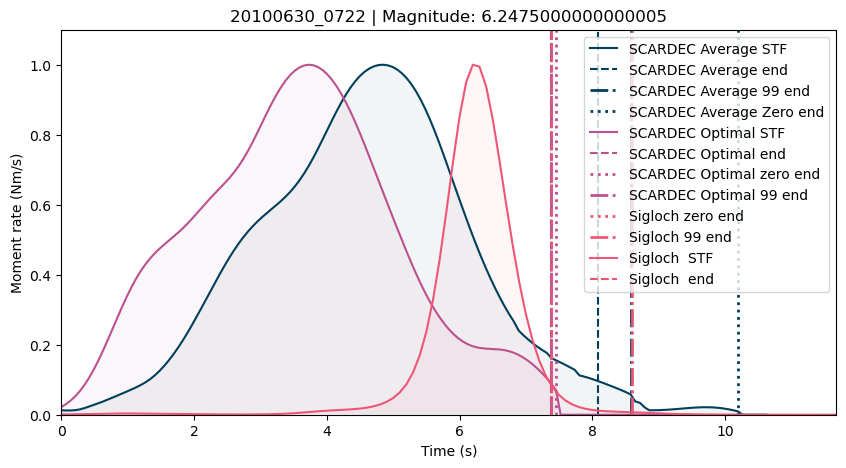

event                                   20170428_2023
scardec    FCTs_20170428_202317_MINDANAO__PHILIPPINES
ye                                                  0
isc                                                 0
sigloch                                             0
usgs                                                0
mag                                             6.817
Name: 42, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 115 116 117
 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189
 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 111]
17
15.1875


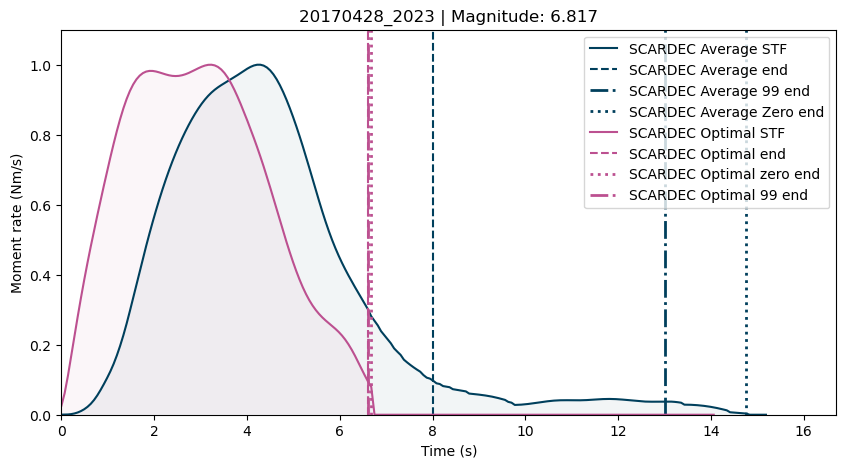

event                          20151104_0344
scardec    FCTs_20151104_034415_TIMOR_REGION
ye                                         0
isc                                        0
sigloch                      0289.2015.308.a
usgs                                       0
mag                                   6.5235
Name: 43, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 166 167 168
 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 236 237
 238 239 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255
 256 257 258 259 260 261 262 263 264 265 266 315 316 317 318 319 320 321
 322 323 324 325 326 327 328 329]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 238 239 240 241 242 243 244 245 246 247
 248 249 250 251 252 253 254 255 256

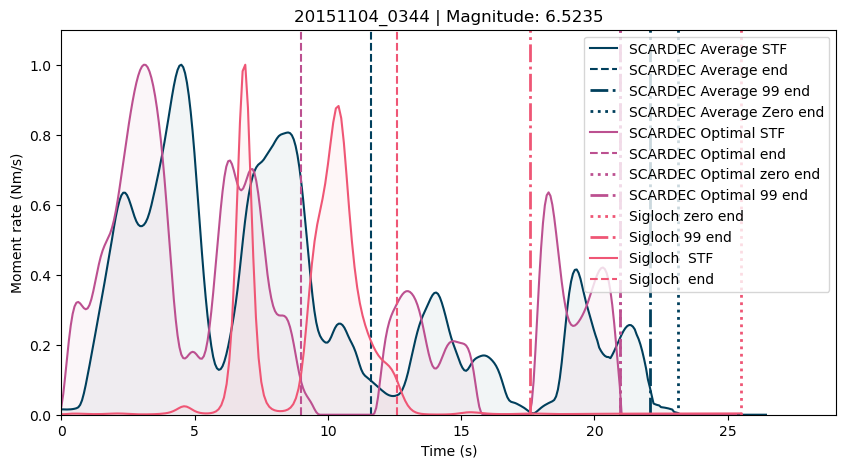

event                    20200614_1424
scardec    FCTs_20200614_142429_TURKEY
ye                                   0
isc                                  0
sigloch                              0
usgs                                 0
mag                                5.8
Name: 44, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 67 68 69
 70 71 72 73 74 75 76 77]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
5.84606933


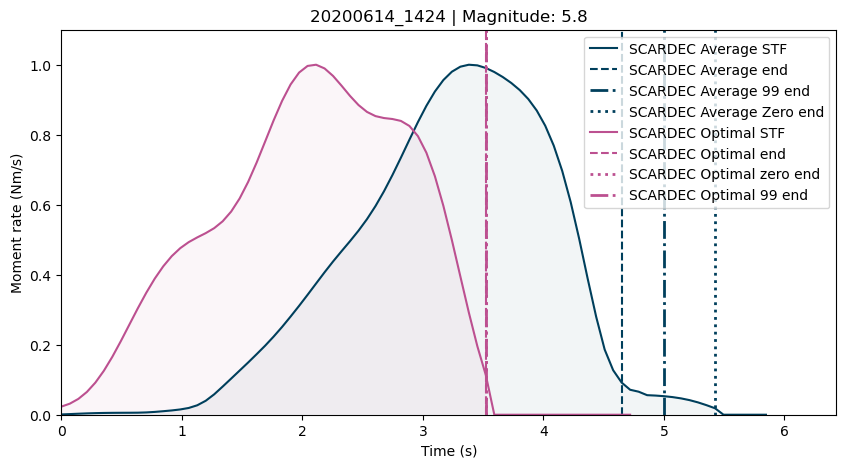

event                                          20200623_1529
scardec    FCTs_20200623_152904_NEAR_COAST_OF_OAXACA__MEXICO
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                     20200623_152904.txt
mag                                                    7.415
Name: 45, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12 195 196 197 198 199
 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217
 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235
 236 237 238]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 222 223 224 225 226 227 228]
17
1
[  0   1   2   3  56  57  58  59  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87
  88  89  90  91  92  93  94  95  96  9

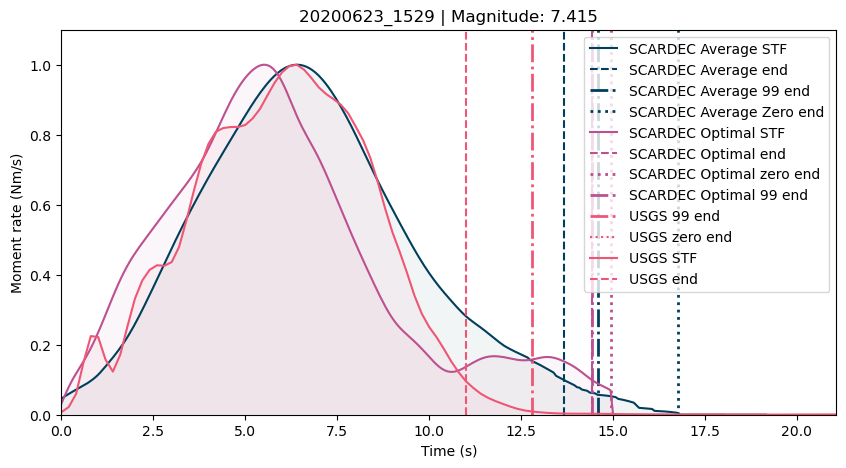

event                                19920804_2108
scardec    FCTs_19920804_210841_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          6.447
Name: 46, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 151 152 153]
17
12.796875


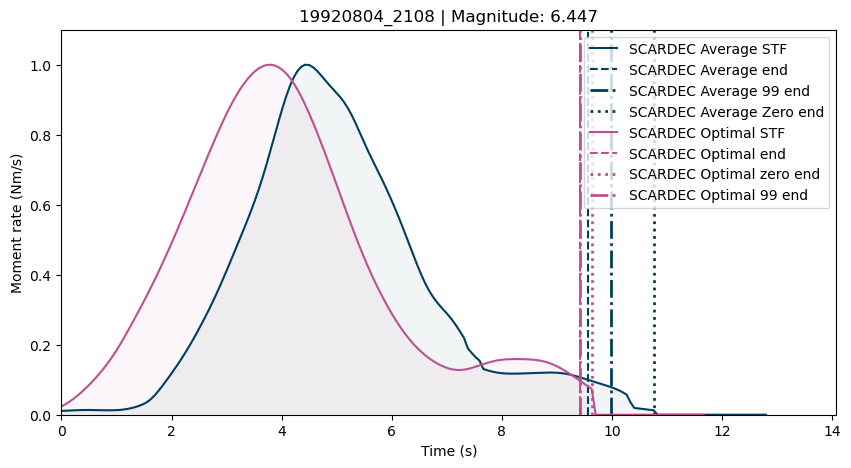

event                             20080106_0514
scardec    FCTs_20080106_051420_SOUTHERN_GREECE
ye                                            0
isc                                           0
sigloch                         0368.2008.006.a
usgs                                          0
mag                                      5.9745
Name: 47, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58 59 60 61
 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85
 86]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58]
17
0
[  0   1   2   3   4   5   6   7   8   9  16  17  18  19  20  21  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 10

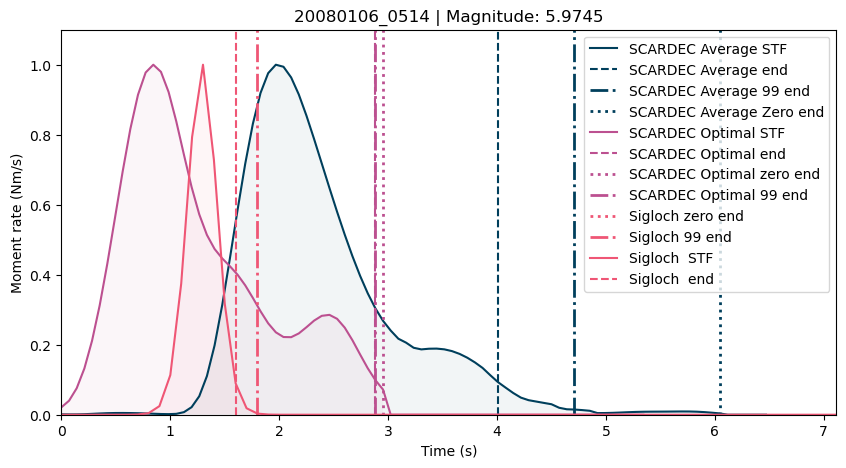

event                                 20050123_2010
scardec    FCTs_20050123_201012_SULAWESI__INDONESIA
ye                                                0
isc                                               0
sigloch                             0268.2005.023.a
usgs                                              0
mag                                           6.177
Name: 48, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28 126 127 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 157 158 159 160 161 162 163 164]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  68  69
  70  71  72  73  74  75  76  

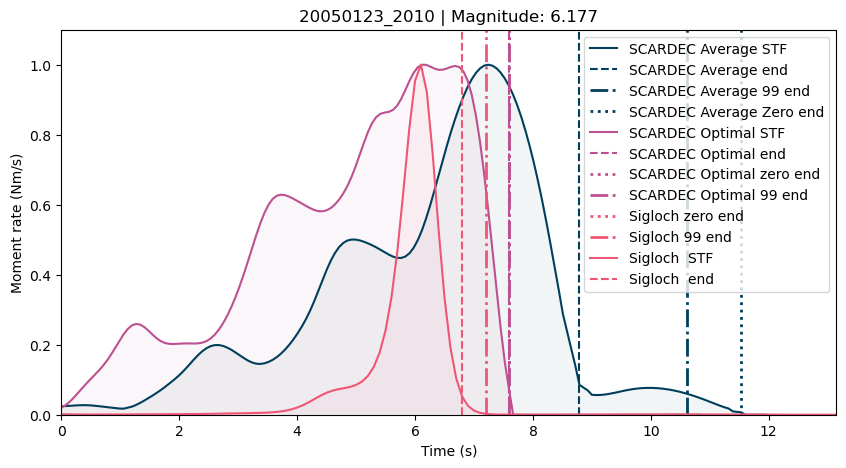

event                                          20020508_1945
scardec    FCTs_20020508_194518_NEAR_EAST_COAST_OF_KAMCHATKA
ye                                                         0
isc                                                        0
sigloch                                      0218.2002.128.a
usgs                                                       0
mag                                                   5.8585
Name: 49, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135
 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189
 190 191 192 193 194 195 196 197 198 199 200 201 202 203 204 205 206 207
 208 209 210 211 212 213]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 2

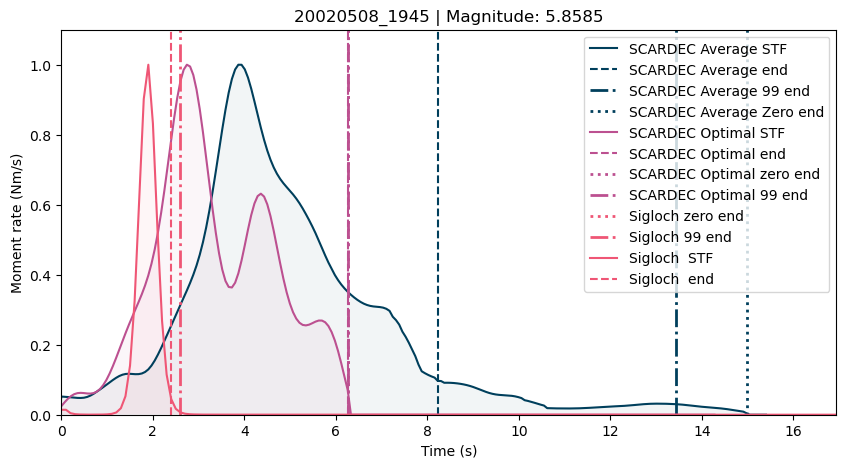

event                           20181029_0654
scardec    FCTs_20181029_065421_DRAKE_PASSAGE
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.354
Name: 50, dtype: object
14
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
 108 109 110 111 112 113 114 115 116 117]
14
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 103]
17
7.747802730999999


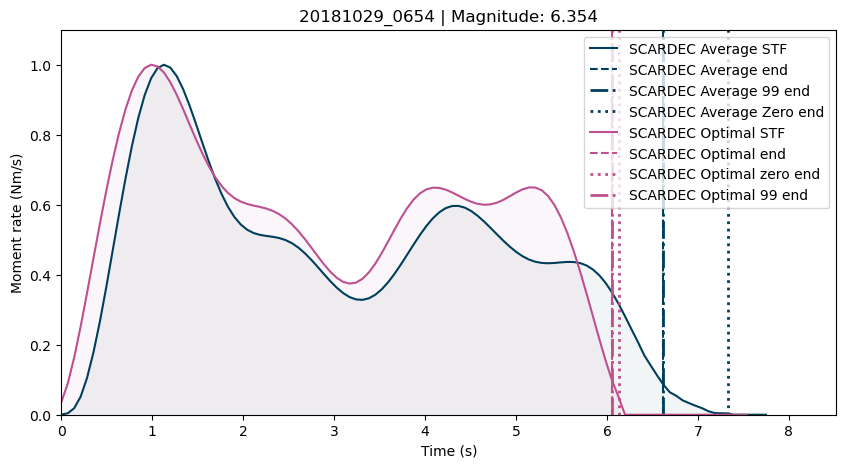

event                                 20060102_2213
scardec    FCTs_20060102_221340_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                                           0
usgs                                              0
mag                                           7.071
Name: 51, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 162 163 164 165 166 167 168 169 170 171 172 173 174 175
 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190 191 192 193
 194 195 196 197 198 199]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36]
17
14.4140625


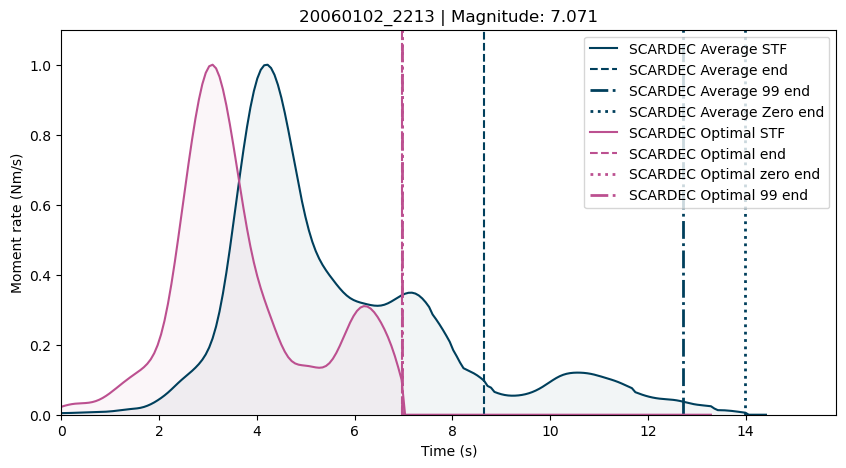

event                                          19990507_1413
scardec    FCTs_19990507_141352_KODIAK_ISLAND_REGION__ALASKA
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.302
Name: 52, dtype: object
5
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14 186 187 188
 189 190 191 192 193 194 195]
5
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27 28 29 30 31 32 33 34 35 36]
17
15.8203125


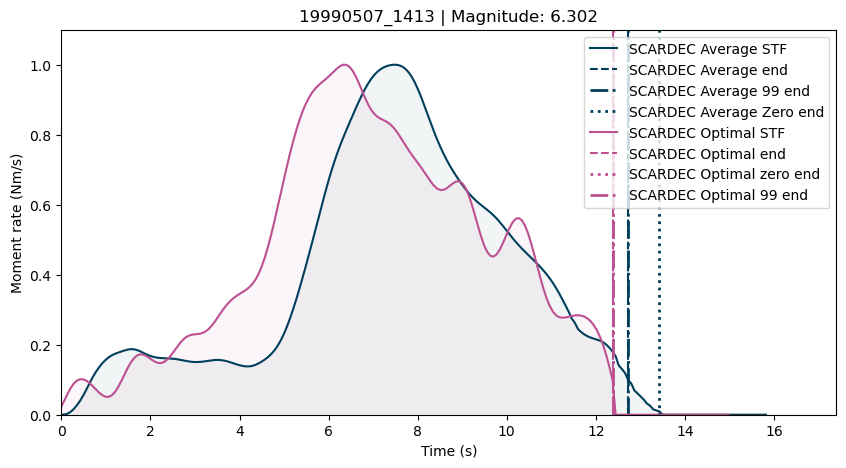

event                                          20080929_1519
scardec    FCTs_20080929_151931_KERMADEC_ISLANDS__NEW_ZEA...
ye                             200809291519_Kermadec.mrf.txt
isc                                                        0
sigloch                                      0178.2008.273.a
usgs                                                       0
mag                                                    7.024
Name: 53, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40 277 278 279 280 281 282 283 284 285 286 287 288 289
 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304 305 306 307
 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323 324 325
 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341 342 343
 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359 360 361
 362 363 364 365 366 367 368 369 370

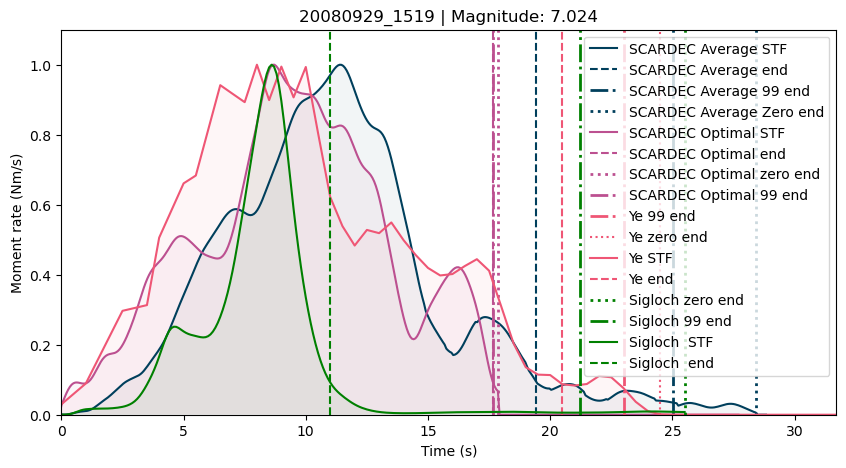

event                            20161225_1422
scardec    FCTs_20161225_142227_SOUTHERN_CHILE
ye                 201612251422_SChile.mrf.txt
isc                                          0
sigloch                                      0
usgs                       20161225_142227.txt
mag                                      7.559
Name: 54, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 296 297 298 299 300 301 302 303 304 305
 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323
 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427]
1
1

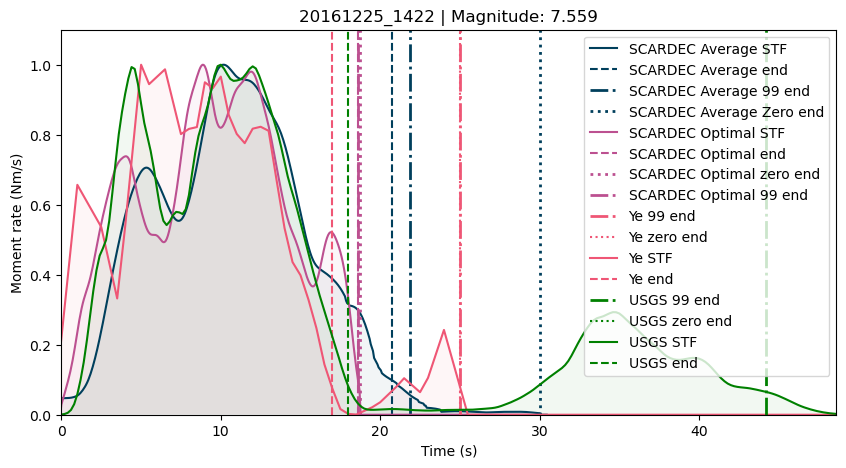

event                              19940609_0033
scardec    FCTs_19940609_003316_NORTHERN_BOLIVIA
ye                                             0
isc                                            0
sigloch                                        0
usgs                                           0
mag                                        8.237
Name: 55, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 565 566 567 568 569
 570 571 572 573 574 575 576 577 578 579 580 58

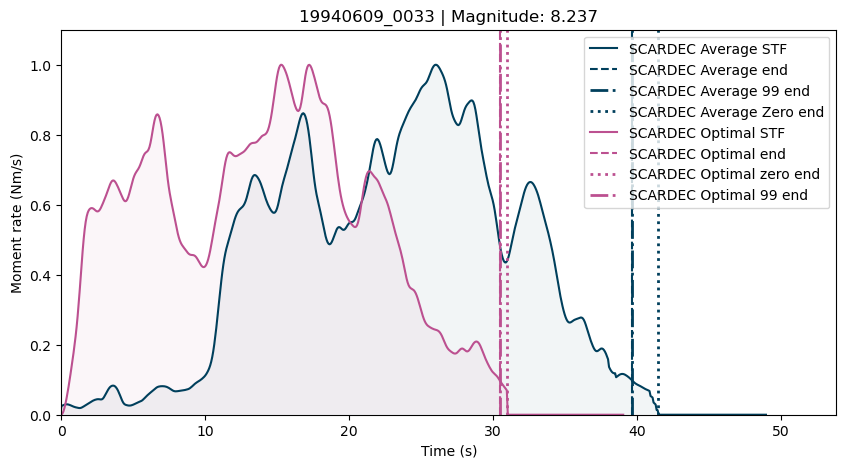

event                                         19940111_0051
scardec    FCTs_19940111_005156_MYANMAR-CHINA_BORDER_REGION
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.003
Name: 56, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  71  83  84
  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102
 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120
 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
10.0546875


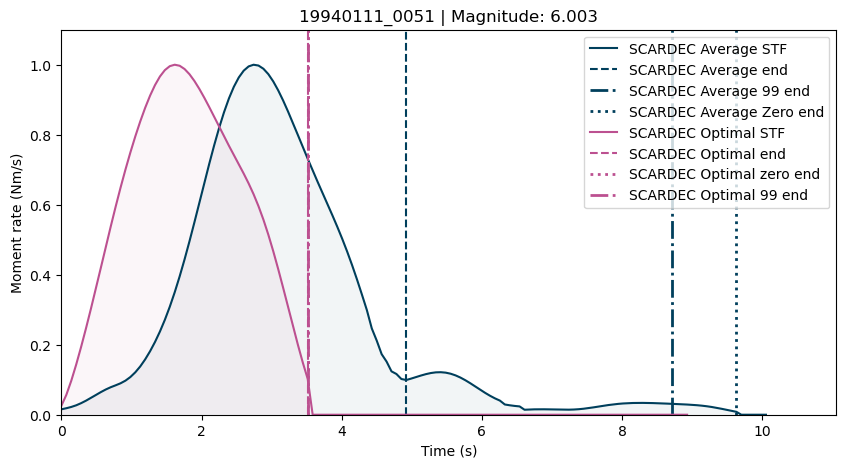

event                                 20190822_1927
scardec    FCTs_20190822_192711_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                                           0
usgs                                              0
mag                                           6.061
Name: 57, dtype: object
16
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 128 129 130 131 132
 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150
 151 152 153 154 155 156 199 200 201 202 203 204 205 206 207 208 209 210
 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227 228
 229 230 231]
16
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89 

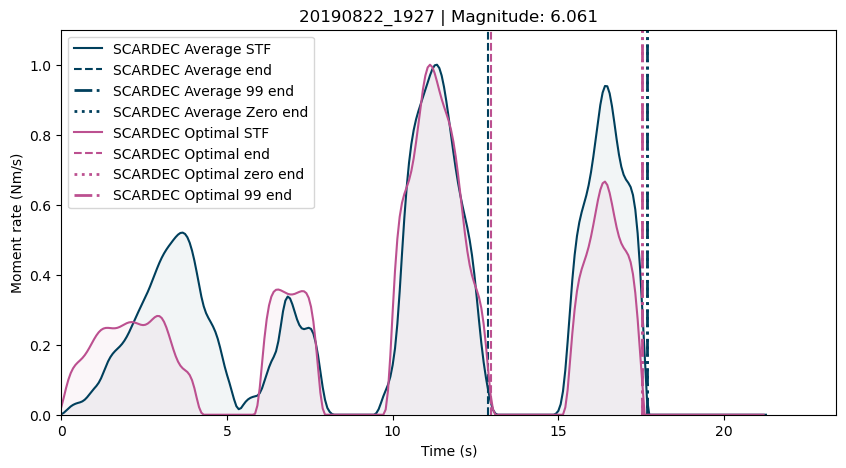

event                                     20220320_1810
scardec    FCTs_20220320_181043_KERMADEC_ISLANDS_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.071
Name: 58, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 151 152 153 154 155 156 157 158]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 104 105 106]
17
11.55126955


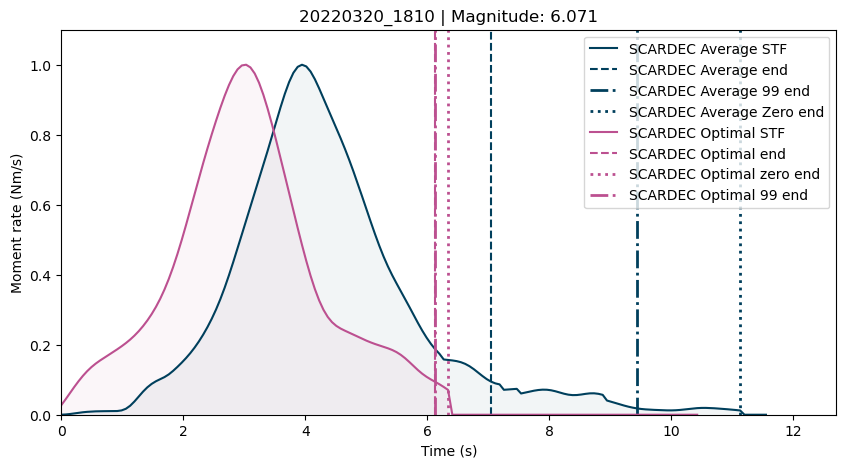

event                                          20001205_2211
scardec    FCTs_20001205_221134_FOX_ISLANDS__ALEUTIAN_ISL...
ye                                                         0
isc                                                        0
sigloch                                      0009.2000.340.a
usgs                                                       0
mag                                                   5.9405
Name: 59, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103
 104 105 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134
 173 174 175 176 177 178 179 180 181 182 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  29  30  31  32
  33  34  35  36  37  38  39  40  41  42

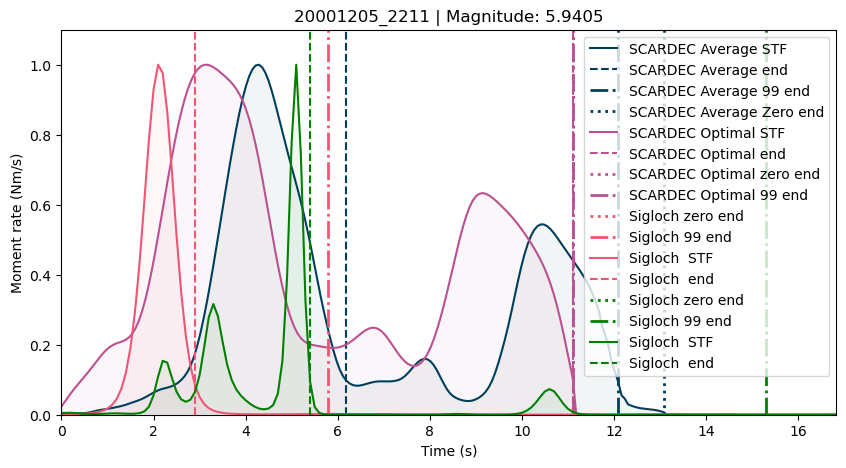

event                    19951001_1557
scardec    FCTs_19951001_155716_TURKEY
ye                                   0
isc                                  0
sigloch                0366.1995.274.a
usgs                                 0
mag                              6.343
Name: 60, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87 212 213 214 215 216
 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32 216]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  20  21  22  23  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  96

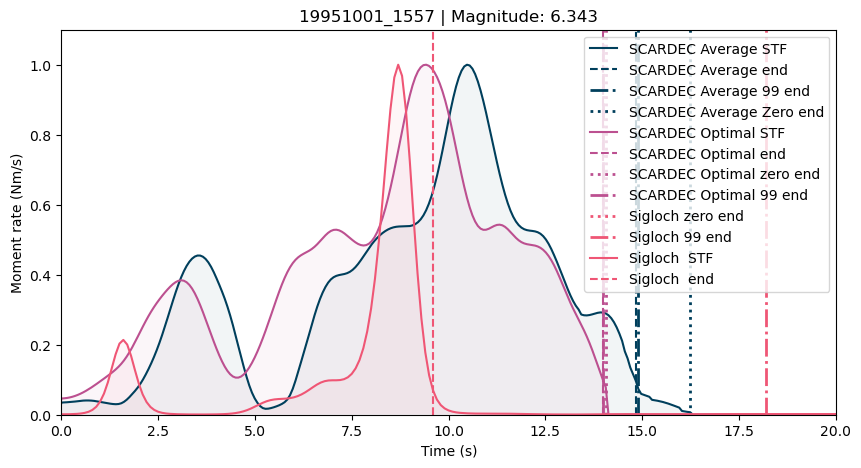

event                                   19951019_0032
scardec    FCTs_19951019_003206_RYUKYU_ISLANDS__JAPAN
ye                                                  0
isc                                                 0
sigloch                                             0
usgs                                                0
mag                                             6.402
Name: 61, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12 163 164 165 166 167
 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185
 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221
 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239
 240 241 242 243 244 245 246 247 248 249 250 251 252 253 254 255 256 257
 258 259 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275
 276 277 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293
 294 295 296

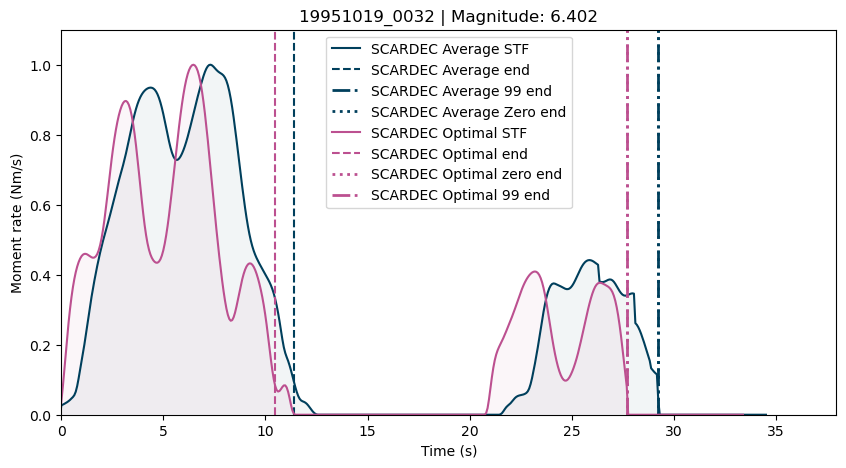

event                                   20020101_1129
scardec    FCTs_20020101_112922_MINDANAO__PHILIPPINES
ye                                                  0
isc                                                 0
sigloch                               0259.2002.001.a
usgs                                                0
mag                                             6.285
Name: 62, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81
  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99
 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117
 118 119 120 121 122 123]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 67 68]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58 

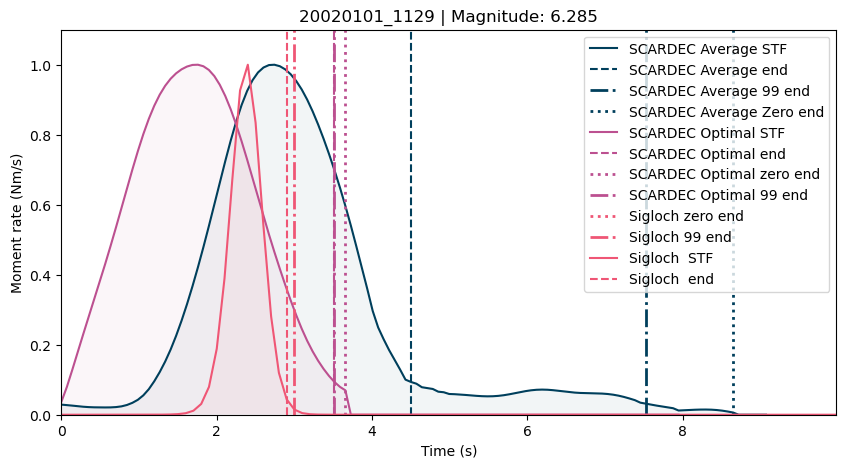

event                                          20190615_2255
scardec    FCTs_20190615_225504_KERMADEC_ISLANDS__NEW_ZEA...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                     20190615_225504.txt
mag                                                    7.292
Name: 63, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 231 232 233]
17
1
[  0   1   2   3   4   5  73  74  75  76  77  78  79  80  81  82  83  84
  85  86  87  88  89  9

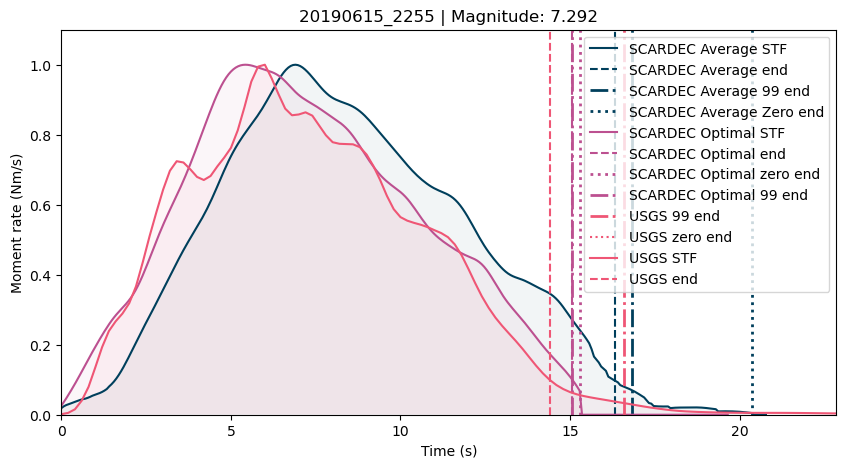

event                                         20211110_1545
scardec    FCTs_20211110_154513_SOUTHEAST_OF_RYUKYU_ISLANDS
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                    6.56
Name: 64, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15 166 167
 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182 183 184 185
 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200 201 202 203
 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220 221
 222 223 224 225 226 227 228 229 230 231 232 233 234 235 236 237 238 239
 240 241 242 243 244 245 246 247 248 249 250]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 144 145 146 147 148]
17
18.03124995


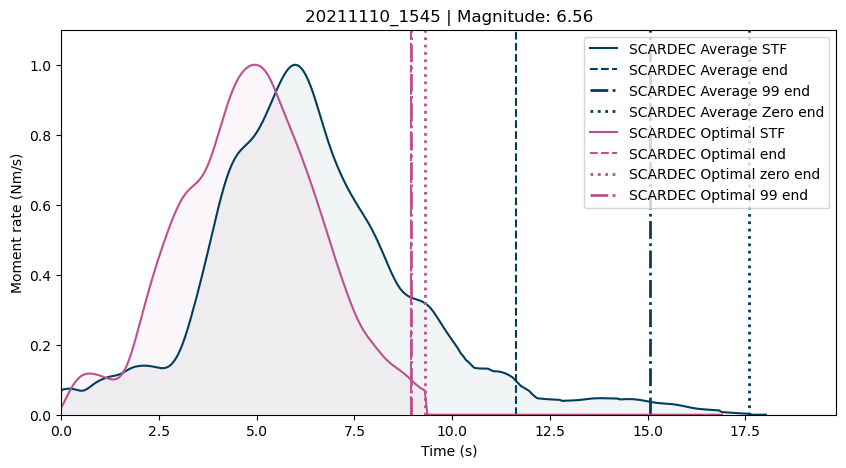

event                                          20121214_1036
scardec    FCTs_20121214_103601_OFF_W._COAST_OF_BAJA_CALI...
ye                                                         0
isc                                                        0
sigloch                                      0047.2012.349.a
usgs                                                       0
mag                                                    6.302
Name: 65, dtype: object
13
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 108 109 110 111 112 113 114 115 116 117 122 123 124
 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142
 143 144 145 146]
13
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 106 107]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98 

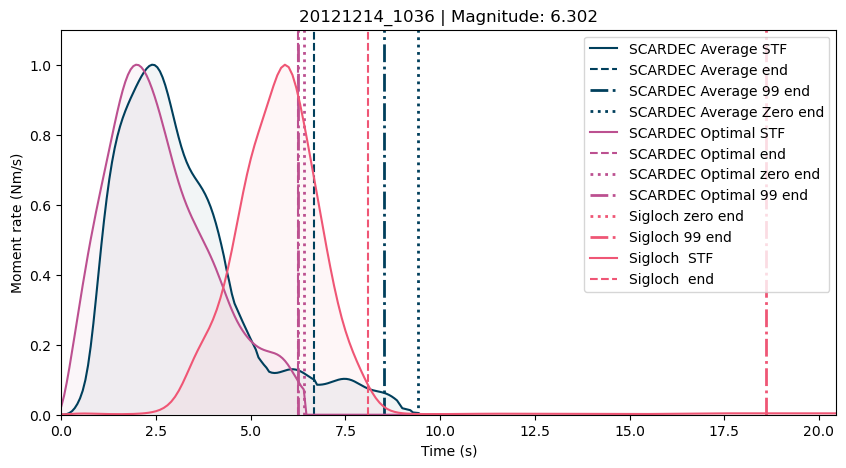

event                              20211011_0910
scardec    FCTs_20211011_091025_ALASKA_PENINSULA
ye                                             0
isc                                            0
sigloch                                        0
usgs                                           0
mag                                        6.889
Name: 66, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130
 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148
 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166
 167 168 169 170 171 172 173 174 175 176 177]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23 100]
17
12.88952635


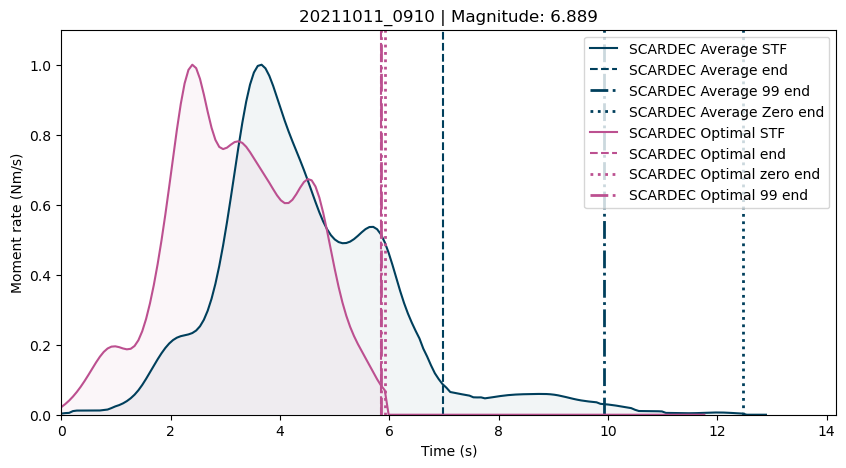

event                     19940808_2108
scardec    FCTs_19940808_210831_MYANMAR
ye                                    0
isc                                   0
sigloch                               0
usgs                                  0
mag                               6.108
Name: 67, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
17
7.6640625


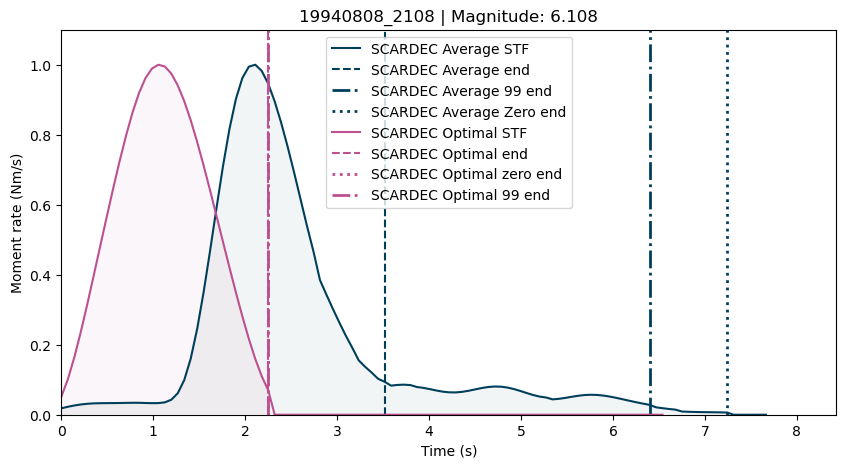

event                           20051127_1022
scardec    FCTs_20051127_102219_SOUTHERN_IRAN
ye                                          0
isc                                         0
sigloch                       0353.2005.331.a
usgs                                        0
mag                                    6.0365
Name: 68, dtype: object
4
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 89 90 91
 92 93 94]
4
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  24
  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42
  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60
  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78
  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114
 115 116 117 118 119 120 121 122 123 124 125 126 127 128 1

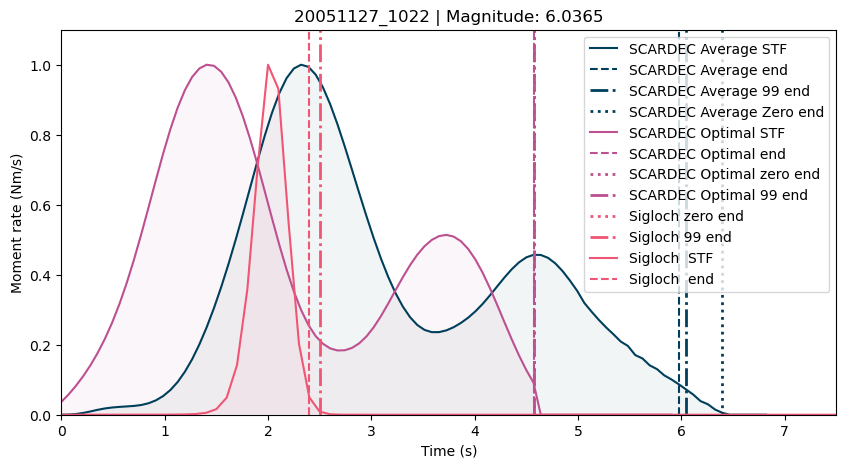

event                                     19980618_0417
scardec    FCTs_19980618_041754_ASCENSION_ISLAND_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.259
Name: 69, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 232 233 234 235 236 237 238 239 240 241 242 243 244
 245 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262
 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280
 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295 296 297 298
 299 300]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 215 216]
17
21.515625


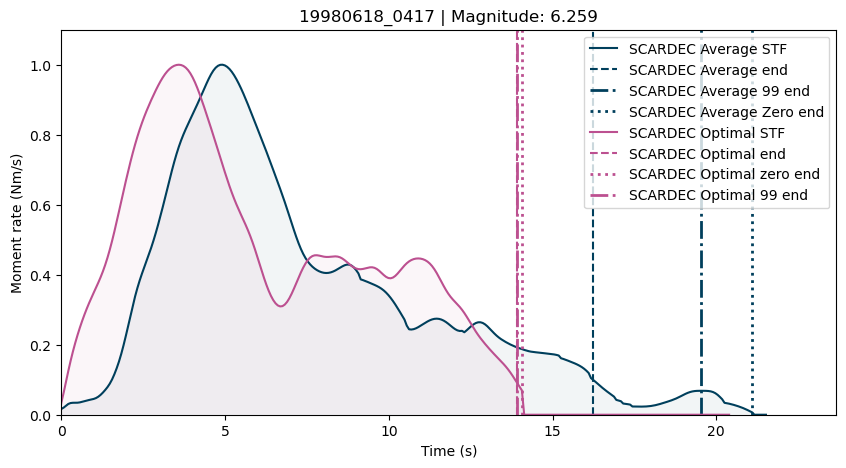

event                                          19960330_1305
scardec    FCTs_19960330_130517_FOX_ISLANDS__ALEUTIAN_ISL...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.283
Name: 70, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  92  93  94  95  96
  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  69  70  71  72  73  74  75  76  77  78  79  88  89  90  91  92  93
  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112]
17
12.09375

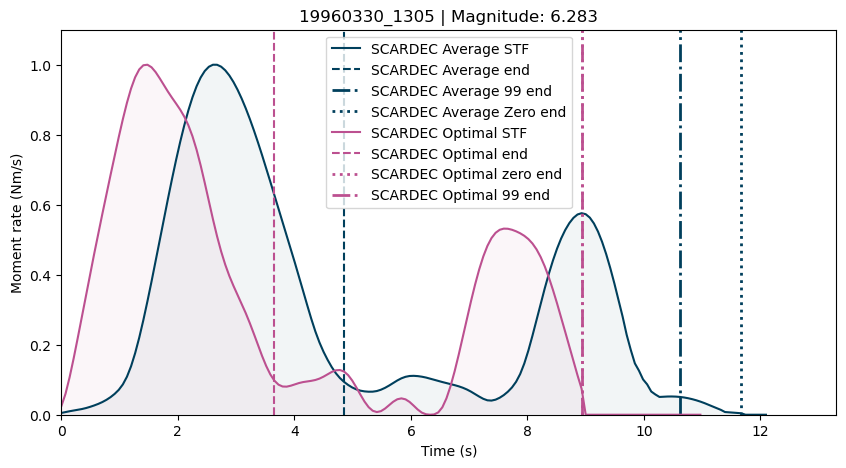

event                                  20180715_1309
scardec    FCTs_20180715_130916_EASTERN_GULF_OF_ADEN
ye                                                 0
isc                                                0
sigloch                                            0
usgs                                               0
mag                                            5.909
Name: 71, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129
 130 131 132]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
9.7199707


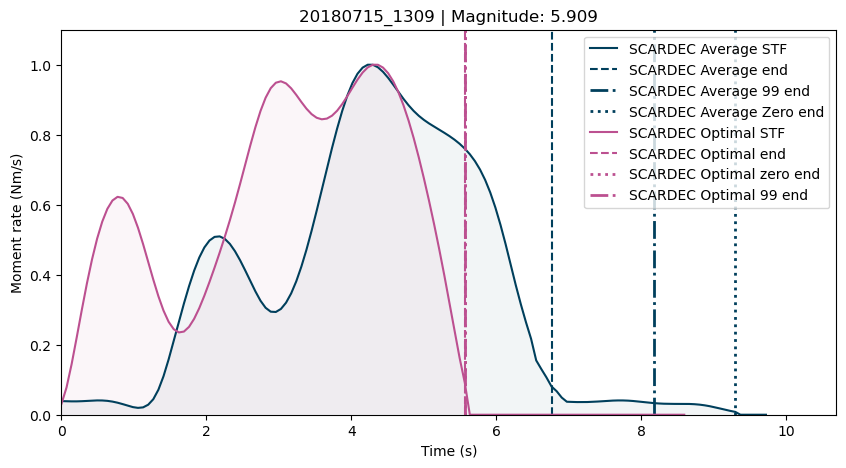

event                                       20200107_1911
scardec    FCTs_20200107_191135_NEW_BRITAIN_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                                 0
usgs                                                    0
mag                                                 5.959
Name: 72, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  86  87
  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105
 106 107 108 109 110 111 112 113 114 115 116 117]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 80 81 82 83 84
 85 86 87 88 89 90 91 92 93 94 95 96]
17
8.66345214


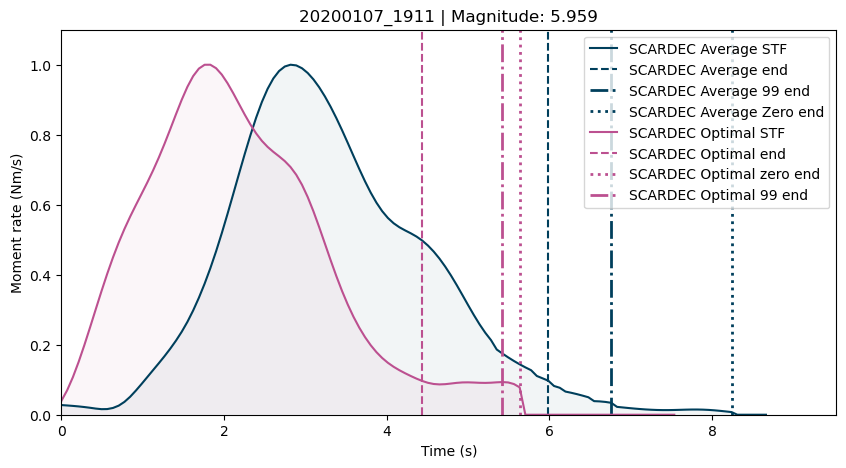

event                           20091010_2124
scardec    FCTs_20091010_212438_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                       0221.2009.283.a
usgs                                        0
mag                                    5.9785
Name: 73, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 51 52 53 54 55
 56 57 58 59 60 61 62 63 64 65 66 67 68 69]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 53 54 55 56
 57 58]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  64  65  66  67  68  69  70  71  72  73  74  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112
 113 1

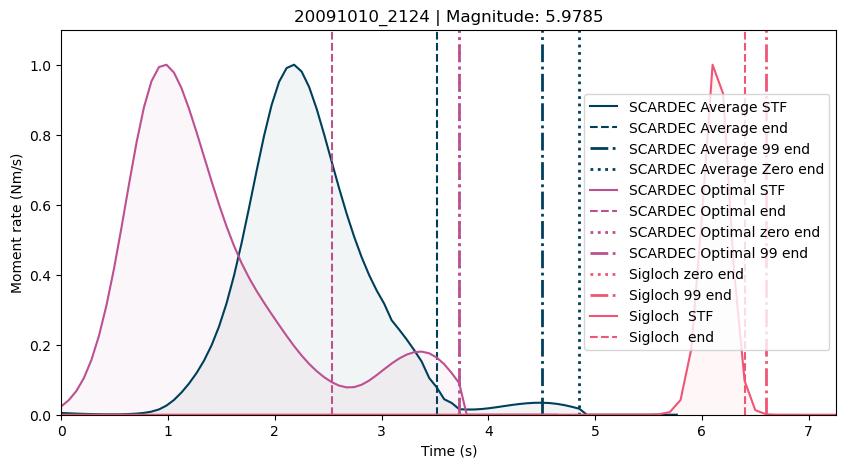

event                      20120930_1631
scardec    FCTs_20120930_163135_COLOMBIA
ye                                     0
isc                                    0
sigloch                  0103.2012.274.a
usgs                                   0
mag                                7.275
Name: 74, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277
 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295
 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313
 314 315 316]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
17
0
[  0   1   2   3   4   5   6 

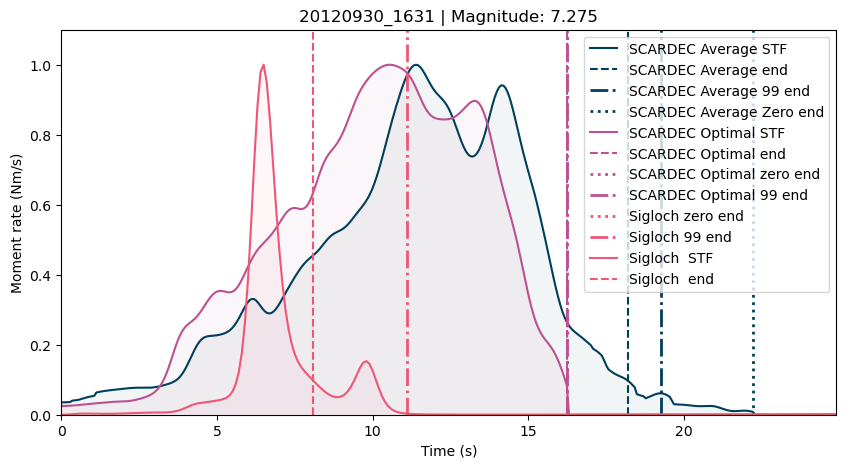

event                           19951006_1139
scardec    FCTs_19951006_113934_TONGA_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.375
Name: 75, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 73 74 75 76
 77 78 79 80 81 82]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 71 72]
17
6.1875


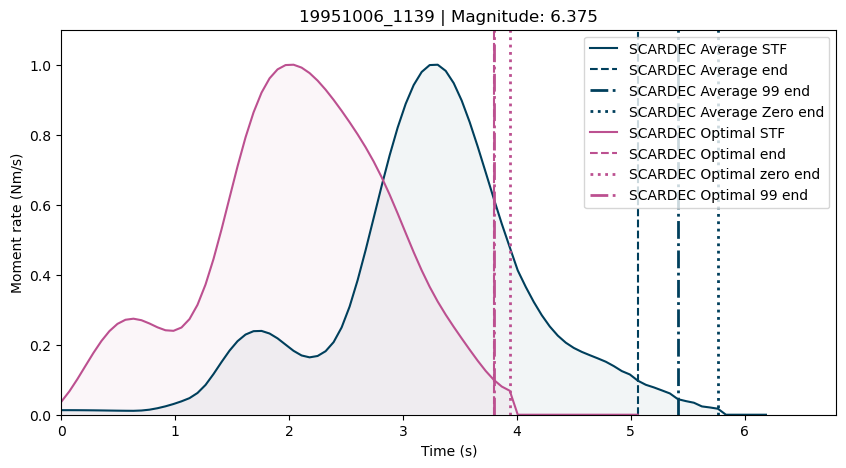

event                                        20190729_2037
scardec    FCTs_20190729_203743_SOUTHEAST_OF_HONSHU__JAPAN
ye                                                       0
isc                                                      0
sigloch                                                  0
usgs                                                     0
mag                                                  5.808
Name: 76, dtype: object
7
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 63 64 65 66
 67 68 69 70 71 72 73 74 75 76]
7
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
5.353027343


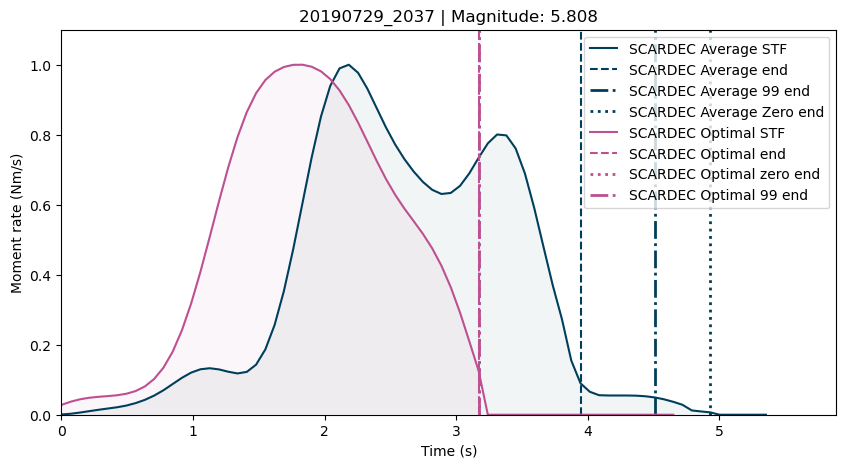

event                        19990821_1049
scardec    FCTs_19990821_104951_COSTA_RICA
ye                                       0
isc                                      0
sigloch                    0078.1999.233.a
usgs                                     0
mag                                  5.779
Name: 77, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 80 81 82 83 84 85
 86 87]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 87]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  49  50  51
  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69
  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87
  88  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105
 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123
 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141
 142 143 

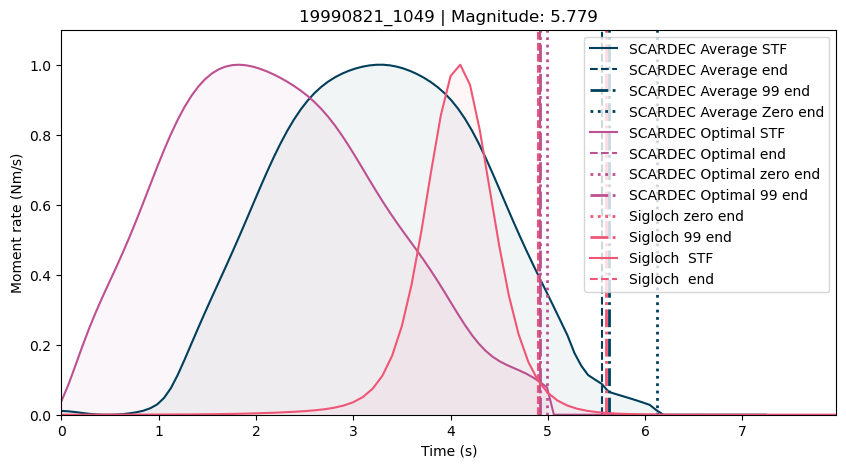

event                             20110820_1655
scardec    FCTs_20110820_165502_VANUATU_ISLANDS
ye                 201108201655_Vanuatu.mrf.txt
isc                                           0
sigloch                         0186.2011.232.a
usgs                        20110820_165502.txt
mag                                      7.1165
Name: 78, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29 172 173 174 175 176 177
 178 179 180 181 182 183 184 185 186]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
1
[ 0  1  2  3 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55
 56 57 58 59 60 61 62 63]
1
5
[  0   1   2   3   4   5   6   7   8   9  67  68  69  70  71  72  73  74
  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92
  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110
 111 112 113 114 115 116 117 118 119 1

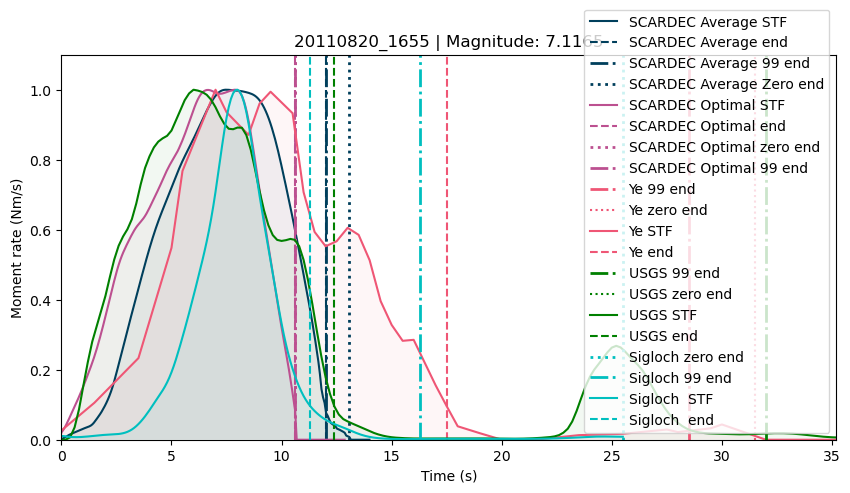

event                             20180123_0634
scardec    FCTs_20180123_063454_JAVA__INDONESIA
ye                                            0
isc                                           0
sigloch                         0259.2009.165.a
usgs                                          0
mag                                    5.922333
Name: 79, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 112]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  81  82  83  84  85  86  94  95  96  97
  98 100 101 102 103 

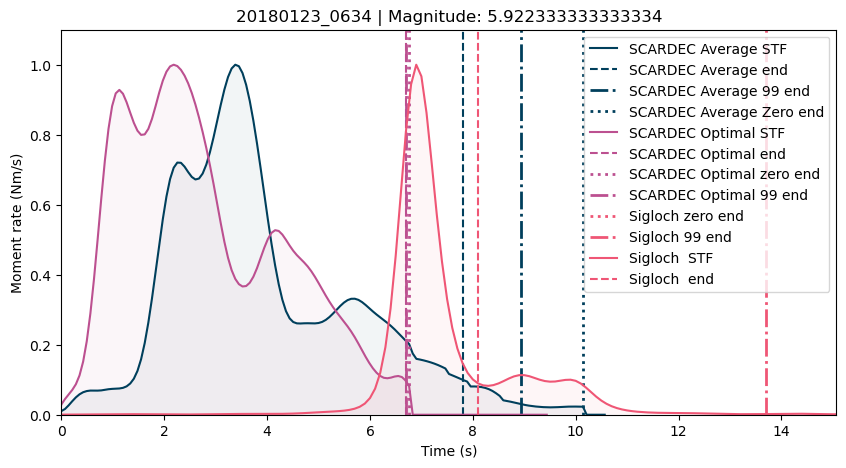

event                                    20100205_0659
scardec    FCTs_20100205_065905_SOUTHEAST_INDIAN_RIDGE
ye                                                   0
isc                                                  0
sigloch                                0435.2010.036.a
usgs                                                 0
mag                                             6.2535
Name: 80, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 216 217 218 219 220 221
 222 223 224 225 226 227 228]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 12

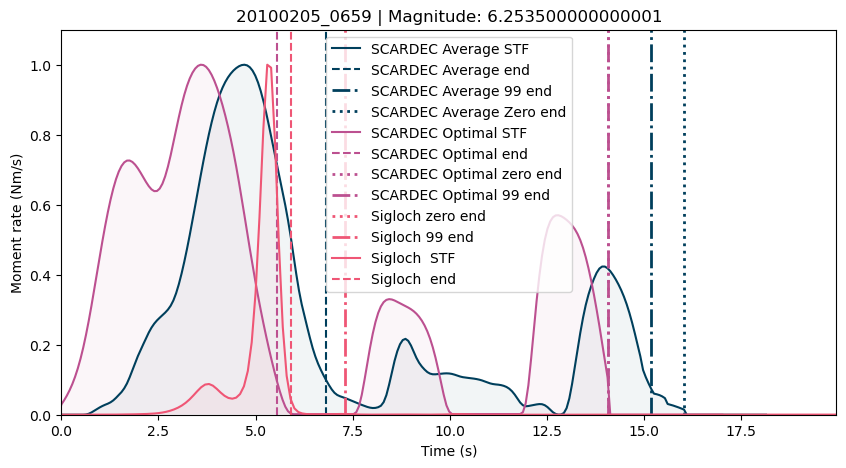

event                            20041107_0202
scardec    FCTs_20041107_020226_SEA_OF_OKHOTSK
ye                                           0
isc                                          0
sigloch                        0663.2004.312.a
usgs                                         0
mag                                     6.1235
Name: 81, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 43 44 45 46 47 48
 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  22  23
  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41
  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59
  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77
  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95
  96  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113
 114 115 116 117 118 

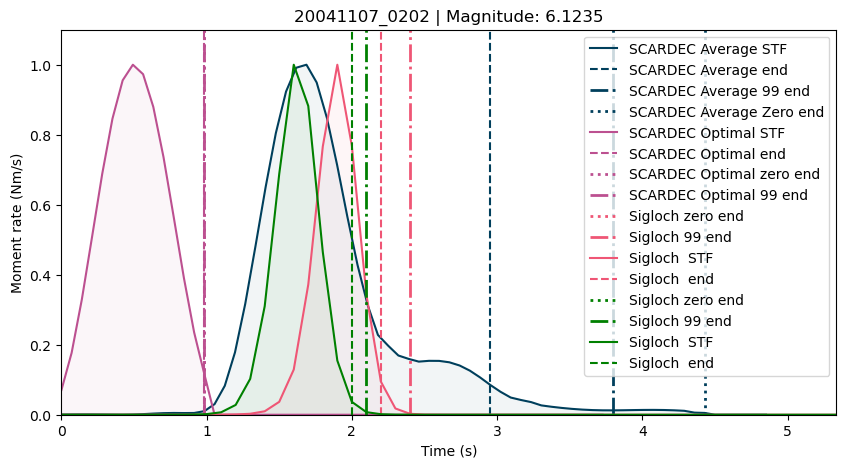

event                                          20030314_0706
scardec    FCTs_20030314_070613_IRIAN_JAYA_REGION__INDONESIA
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.217
Name: 82, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
10.265625


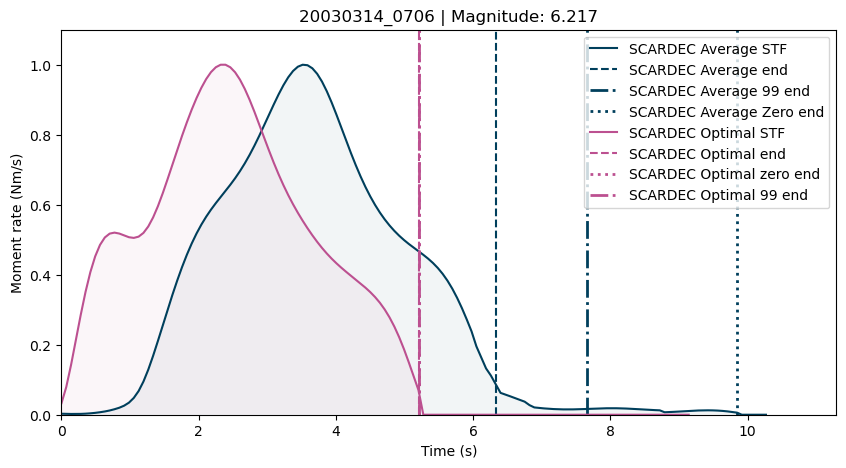

event                                         20170726_1032
scardec    FCTs_20170726_103257_SOUTHEAST_OF_RYUKYU_ISLANDS
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   5.898
Name: 83, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
8.9296875


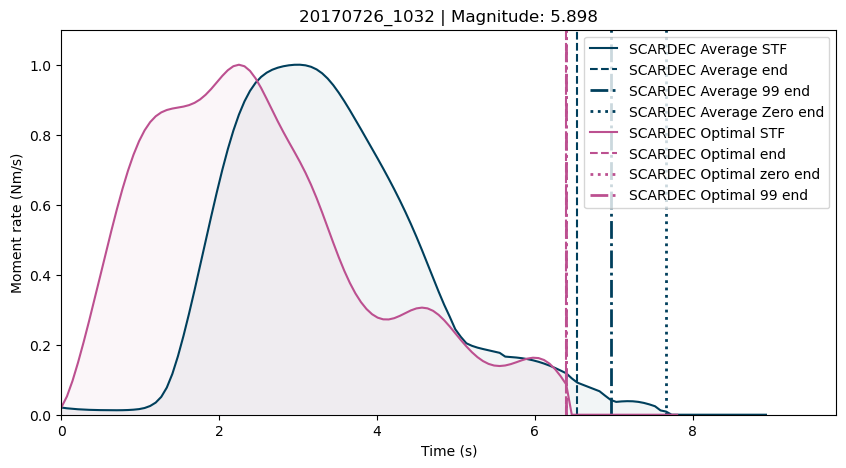

event                                 20131123_0748
scardec    FCTs_20131123_074832_FIJI_ISLANDS_REGION
ye                                                0
isc                                               0
sigloch                             0181.2013.327.a
usgs                                              0
mag                                           6.492
Name: 84, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72
  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90
  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107 108
 109 110 111]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57

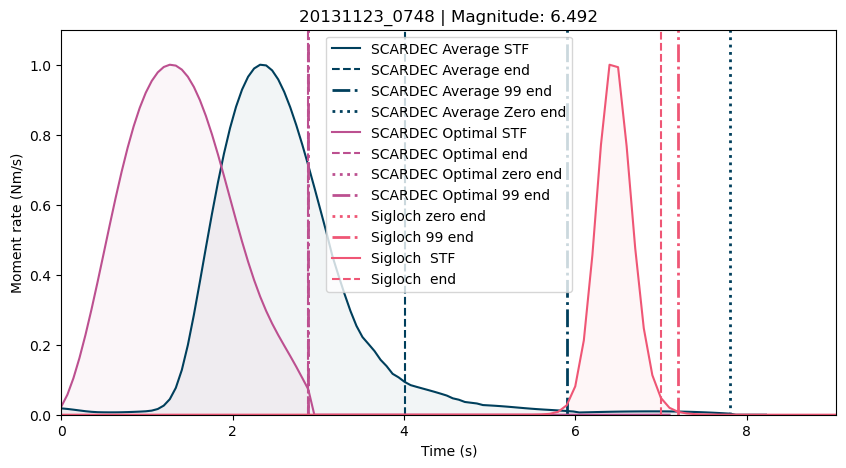

event                                         20091001_0152
scardec    FCTs_20091001_015227_SOUTHERN_SUMATRA__INDONESIA
ye                                                        0
isc                                                       0
sigloch                                                   0
usgs                                                      0
mag                                                   6.713
Name: 85, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 233 234 235 236 237 238 239 240 241 242 243 244 245 246
 247 248 249 250 251 252 326 327 328 329 330 331 332 333 334 335 336 337
 338 339 340 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355
 356 357 358 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373
 374 375 376 377 378 379]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 341 342 343 344 345 346 347 348]
17
29.25


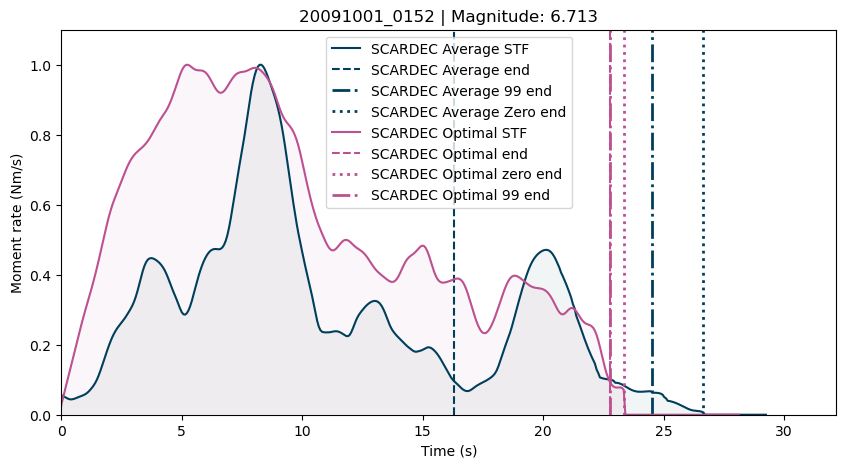

event                                          20110912_2244
scardec    FCTs_20110912_224428_NEAR_N_COAST_OF_NEW_GUINE...
ye                                                         0
isc                                                        0
sigloch                                      0200.2011.255.a
usgs                                                       0
mag                                                   5.9085
Name: 86, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 65
 66]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106
 107 108 109 110 111 112 113 114

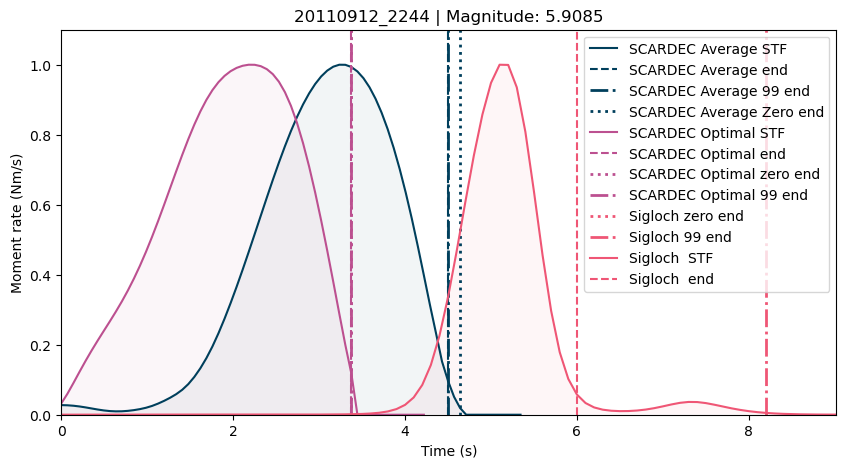

event                                     20181125_1637
scardec    FCTs_20181125_163732_IRAN-IRAQ_BORDER_REGION
ye                                                    0
isc                                                   0
sigloch                                               0
usgs                                                  0
mag                                               6.275
Name: 87, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15 152 153
 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169 170 171
 172 173 174 175 176 177 178 179 180 181 182 183 184 185]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 55 56 57 58 59
 60]
17
13.45300295


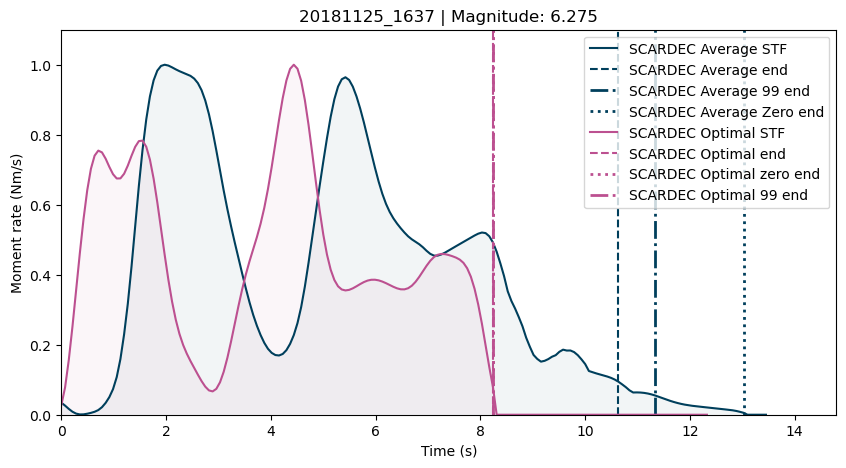

event                                       20110824_1746
scardec    FCTs_20110824_174611_PERU-BRAZIL_BORDER_REGION
ye                                                      0
isc                                                     0
sigloch                                   0112.2011.236.a
usgs                                                    0
mag                                                7.0025
Name: 88, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19 103 104 105 106 107 108 109]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70
  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88
  89  90  91

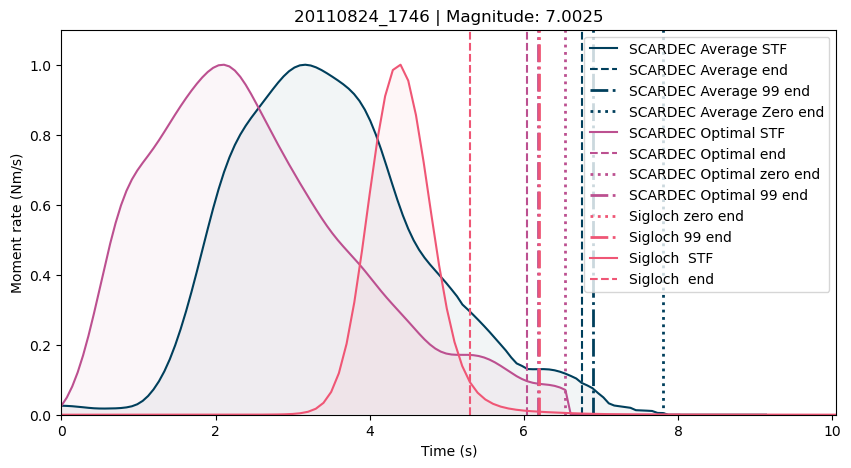

event                             20100104_1128
scardec    FCTs_20100104_112820_SOLOMON_ISLANDS
ye                                            0
isc                                           0
sigloch                         0193.2010.004.a
usgs                                          0
mag                                       5.802
Name: 89, dtype: object
3
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 57 58 59 60
 61 62 63 64 65 66 67 68 69 70 71]
3
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  56  57  58  59  60  61  62  63  64  65
  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83
  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99 100 101
 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119
 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137
 138 139 140 141 

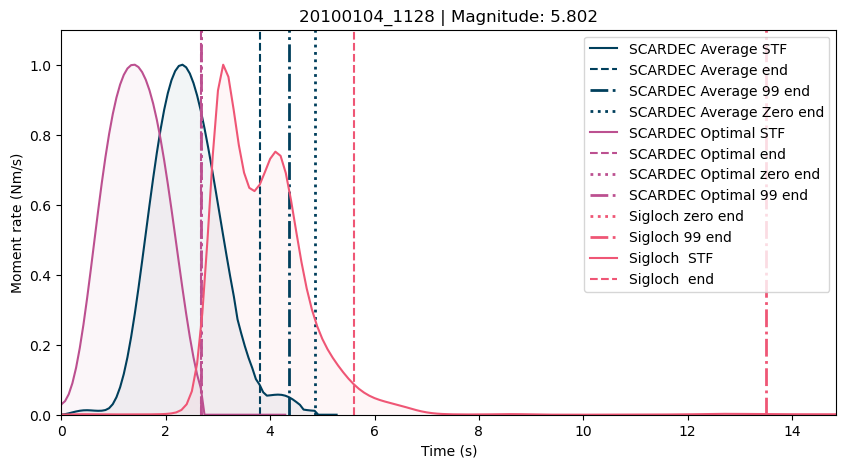

event                                          20190105_1847
scardec    FCTs_20190105_184711_ANDREANOF_ISLANDS__ALEUTI...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    5.991
Name: 90, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 126
 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144
 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21 125 126 127 128 129 130 131 132 137 138]
17
11.69213865


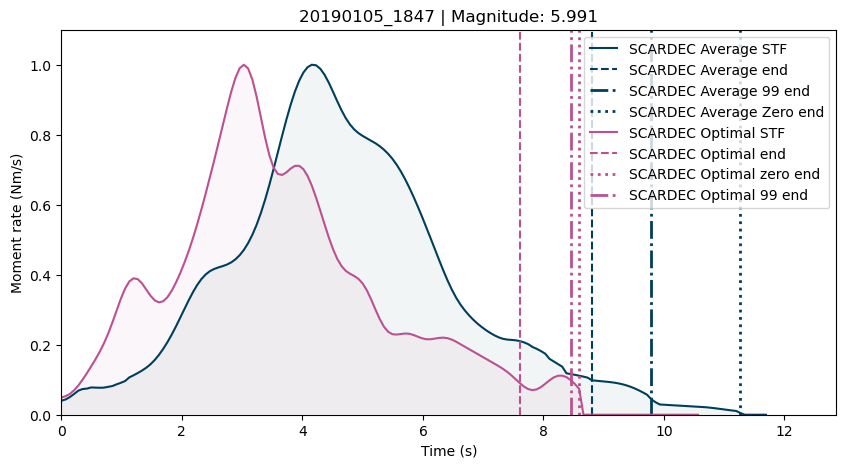

event                                          20041006_2230
scardec    FCTs_20041006_223056_IRIAN_JAYA_REGION__INDONESIA
ye                                                         0
isc                                                        0
sigloch                                      0196.2004.280.a
usgs                                                       0
mag                                                   6.2285
Name: 91, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22 190 191 192 193 194 195 196 197 198 199 200 201 202
 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218 219 220
 221 222 223 224 225 226 227 228 229 230 231 232 238 239 240 241 242 243
 244 245 246 247 248 249 250 251 252 253 254 255 256 257]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  27  28  29  30  31  32  33  

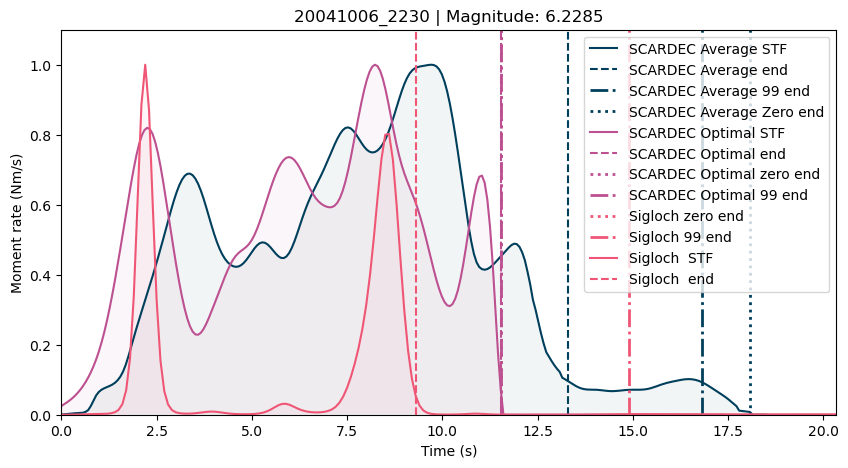

event                                          19930207_1327
scardec    FCTs_19930207_132742_NEAR_WEST_COAST_OF_HONSHU...
ye                                                         0
isc                                                        0
sigloch                                                    0
usgs                                                       0
mag                                                    6.348
Name: 92, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 102 103 104 105]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18 104 105]
17
8.7890625


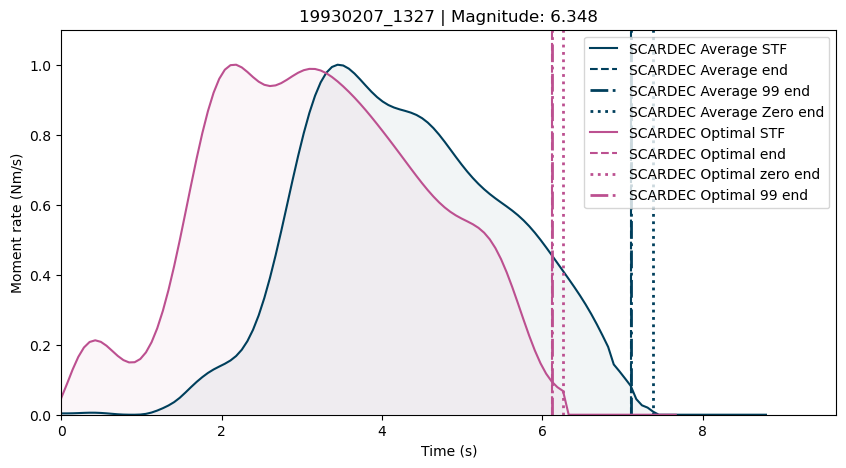

event                                       20021006_1546
scardec    FCTs_20021006_154633_SUMBAWA_REGION__INDONESIA
ye                                                      0
isc                                                     0
sigloch                                   0285.2002.279.a
usgs                                                    0
mag                                                 6.203
Name: 93, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  80  81  82  83  84  85  86  87  88  89  90  91  92 

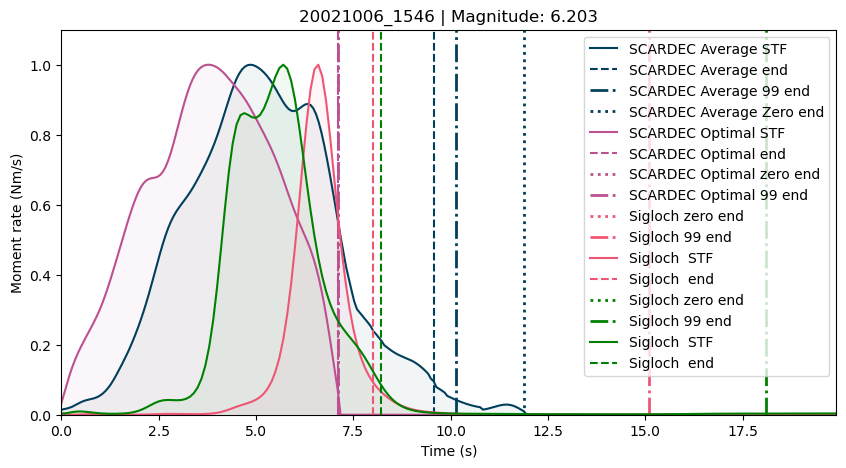

event                             19990214_2112
scardec    FCTs_19990214_211224_VANUATU_ISLANDS
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                       5.933
Name: 94, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 70 71
 72 73 74 75 76 77 78 79 80 81 82]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 74]
17
6.1875


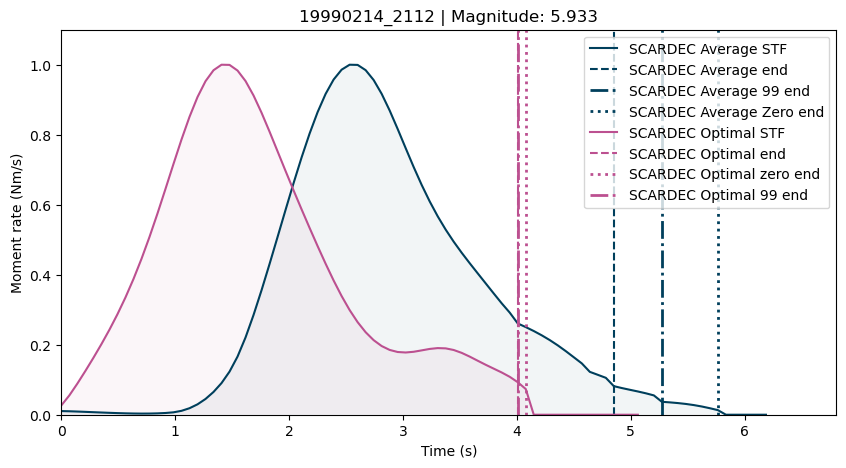

event                                        20070308_0503
scardec    FCTs_20070308_050332_SOUTHEAST_OF_HONSHU__JAPAN
ye                                                       0
isc                                                      0
sigloch                                    0230.2007.067.a
usgs                                                     0
mag                                                 6.0075
Name: 95, dtype: object
5
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 67 68 69 70 71 72 73 74
 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89]
5
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  21  22  23  24  25  26
  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44
  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 10

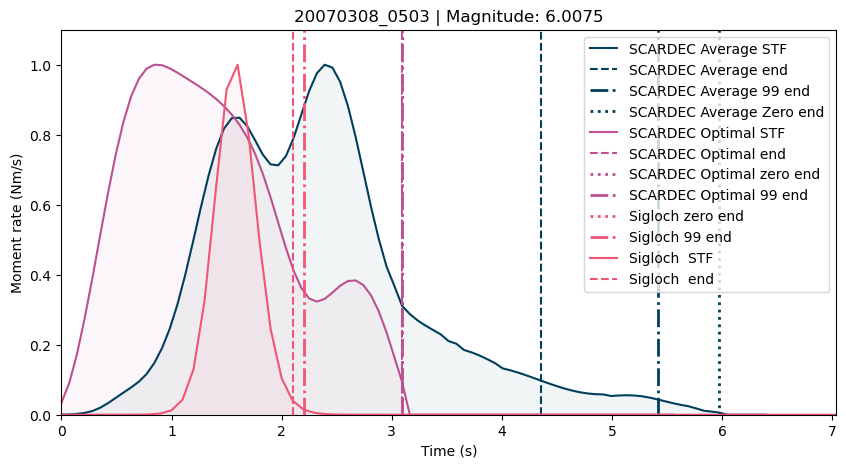

event                                19980716_1156
scardec    FCTs_19980716_115636_SANTA_CRUZ_ISLANDS
ye                                               0
isc                                              0
sigloch                                          0
usgs                                             0
mag                                          7.089
Name: 96, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  97  98  99 100 101 102 103 104 105 106 107 108 109 110 111
 112 113 114 115 116]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 95 96 97]
17
8.578125


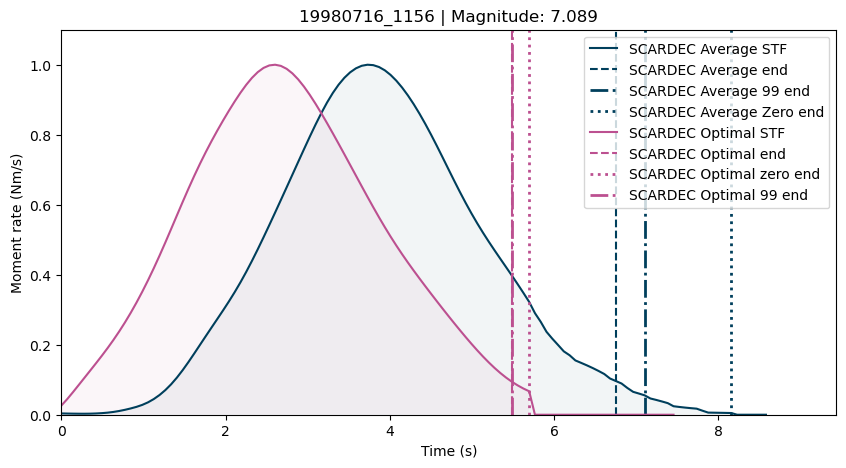

event                           19941016_0510
scardec    FCTs_19941016_051000_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.654
Name: 97, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115
 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133
 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151
 152 153 154 155 156 157 158 159 160 161 162 163 164 165 166 167 168 169
 170 171 172 173]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
12.5859375


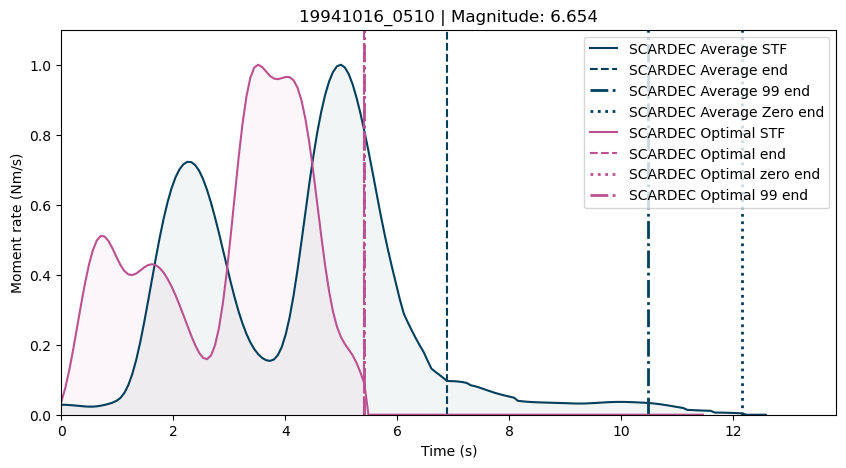

event                                       20061111_1510
scardec    FCTs_20061111_151030_NEW_BRITAIN_REGION__P.N.G
ye                                                      0
isc                                                     0
sigloch                                   0192.2006.315.a
usgs                                                    0
mag                                                 5.942
Name: 98, dtype: object
1
[  0   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17  18  19
  20  21  22  23  24  25  26  27 163 164 165 166 167 168 169 170 171 172
 173 174 175 176 177 178 179 180 181 182 183 184 185 186 187 188 189 190
 191]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24 164]
17
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  62
  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80
  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98
  99 10

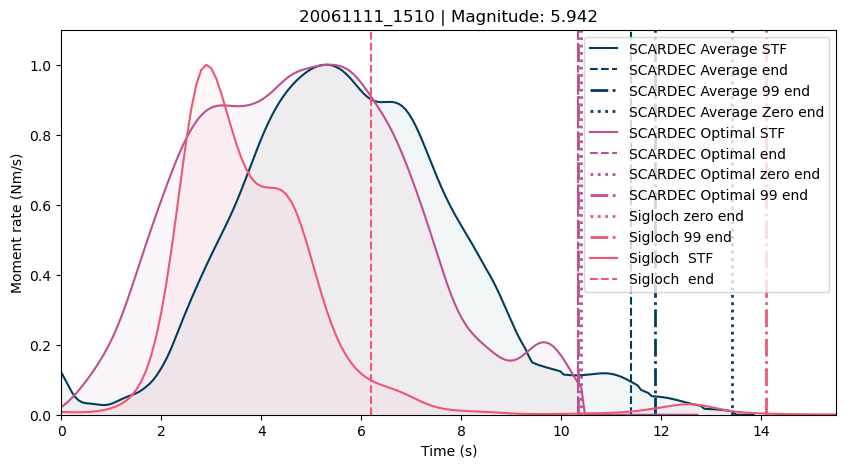

event                  20191120_2350
scardec    FCTs_20191120_235043_LAOS
ye                                 0
isc                                0
sigloch                            0
usgs                               0
mag                            6.178
Name: 99, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 155 156 157 158 159 160 161 162 163 164
 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181 182
 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199 200
 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 216 217 218
 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233 234 235]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
16.97473145


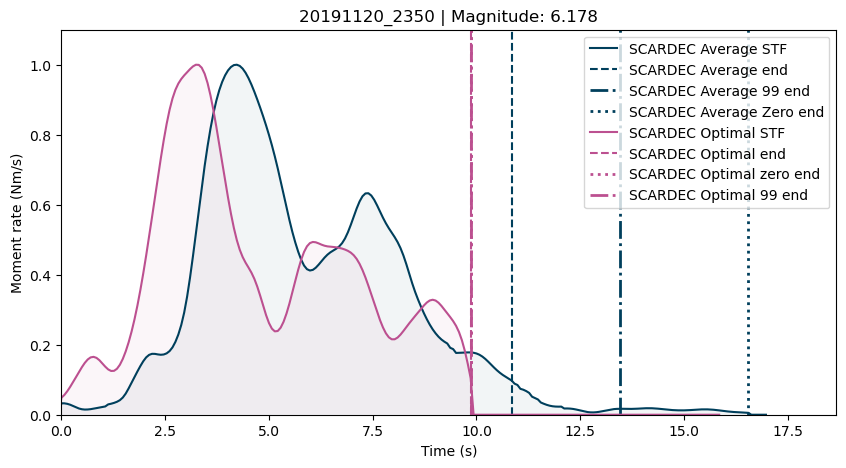

event                           20020824_1840
scardec    FCTs_20020824_184053_KURIL_ISLANDS
ye                                          0
isc                                         0
sigloch                                     0
usgs                                        0
mag                                     6.091
Name: 100, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31 119 120 121 122
 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140
 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158
 159 160]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30 119]
17
11.671875


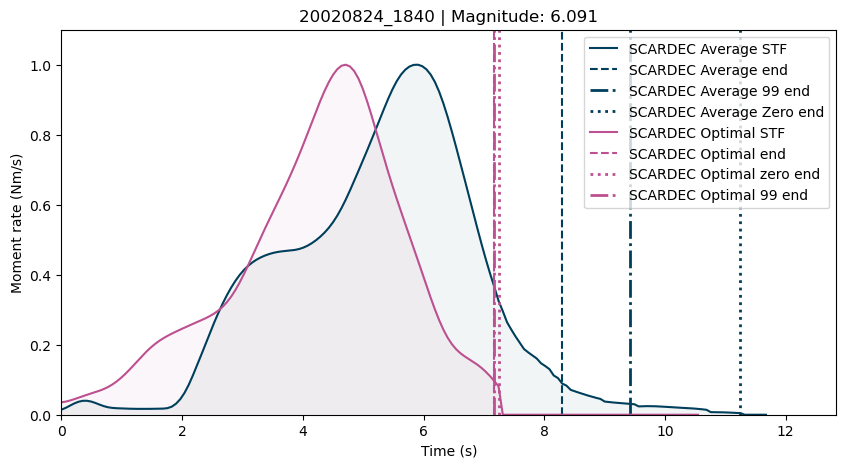

In [28]:
colors = ['#003f5c', '#bc5090', '#ef5675', 'g', 'c', 'm', 'k', 'y']
styles = ['--', '-.', ':', '--', '-.', ':', '--', '-.']
eventcount = 0
already_made = os.listdir('/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/both/')
for i, row in combined.iterrows():
    # if row.event != '20200623_1529':
    #     continue
    # if row.sigloch != '0706.2011.026.a':
    #     continue
    if i > 100:
        continue
    # if row.event + '.png' in already_made:
    #     continue
    lines_count = 0
    count = 0
    print(row)
    sources = 0
    for r in row[1:-1]:
        if r not in [0, '0']:
            sources += 1

    max_end = 0
    y_max = 0
    max_end = 0

    fig, axs = plt.subplots(1, 1, figsize=(10, 5))
    axs = [axs]

    ends_different = False
    count_datasets = 0
    if row.scardec not in ['0', 0]:
        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctmoy')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Average', plot_bar = False)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Average 99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Average Zero end', linewidth = 2)
        max_end = max(max_end, max(time))
        y_max = max(y_max, max(momentrate))
        lines_count += 1

        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctopt')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Optimal', plot_bar = False)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Optimal zero end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Optimal 99 end', linewidth = 2)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.ye not in ['0', 0]:
        momentrate, time = get_ye_stf(row['ye'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Ye 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Ye zero end')
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'Ye', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.usgs not in ['0', 0]:
        momentrate, time = get_usgs_stf(row['usgs'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'USGS 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'USGS zero end')
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'USGS', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.isc not in ['0', 0]:
        momentrate, time = load_isc(row['isc'])
        momentrate = momentrate[0]
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'ISC  99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label =  'ISC zero end')
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'ISC', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.sigloch not in ['0', 0]:
        momentrate_list, time_list = get_sigloch_stf(row['sigloch'])
        for momentrate, time in zip(momentrate_list, time_list):
            momentrate = np.array(momentrate)
            y_max = max(y_max, 10**max(momentrate))
            time = np.arange(0, 25.6, 0.1)#np.array(time)
            detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(10**momentrate, time)
            time = time - detected_start_time # shift to start STF at zero
            detected_end_time = detected_end_time - detected_start_time
            #print(detected_end_time)
            max_end = max(detected_end_time, max_end)
            detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            #max_end = max(max_end, detected_zero_end_time)
            axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Sigloch zero end', linewidth = 2)
            detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            max_end = max(max_end, detected_99_end_time)
            axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Sigloch 99 end', linewidth = 2)
            if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
                ends_different = True
            axs[count] = plot_stf(axs[count], time, (10**momentrate)/max(10**momentrate), detected_end_time, colors[lines_count], '--', label_str = 'Sigloch ', plot_bar = False)
            lines_count += 1
        count_datasets += 1

    for ax in axs:
        ax.set_xlim(0, 1.1*max_end)
        #ax.set_ylim(0, 1.1*y_max)
        if np.isnan(row.mag) == False:
            ax.set_title(row.event + f' | Magnitude: {row.mag}')
        else:
            ax.set_title(row.event)
    plt.legend()
    if count_datasets >= 2:
        if ends_different is True:
            plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/norm/end_comparisons/different/{row.event}.png')
        else:
            plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/norm/end_comparisons/same/{row.event}.png')
        # if row.isc not in ['0', 0]:
    #     plt.show()
    #     break
    # else:
    #     plt.close()
    #     continue
    #axs[0].set_yscale('log')
    #plt.close()
    print(max_end)
    plt.show()






event                             20080106_0514
scardec    FCTs_20080106_051420_SOUTHERN_GREECE
ye                                            0
isc                                           0
sigloch                                       0
usgs                                          0
mag                                      5.9745
Name: 47, dtype: object
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58 59 60 61
 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85
 86]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 58]
17
6.46875


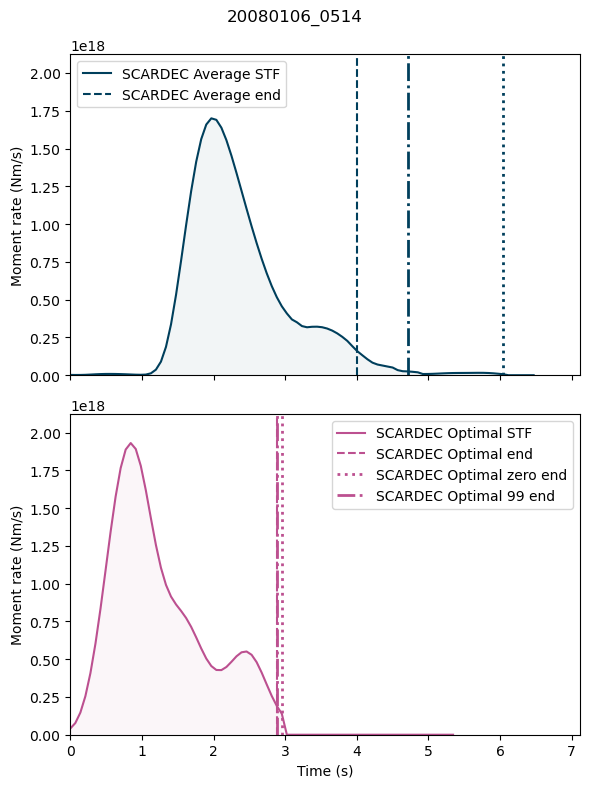

event                            20161225_1422
scardec    FCTs_20161225_142227_SOUTHERN_CHILE
ye                 201612251422_SChile.mrf.txt
isc                                          0
sigloch                                      0
usgs                       20161225_142227.txt
mag                                      7.559
Name: 54, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25 296 297 298 299 300 301 302 303 304 305
 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322 323
 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340 341
 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358 359
 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376 377
 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394 395
 396 397 398 399 400 401 402 403 404 405 406 407 408 409 410 411 412 413
 414 415 416 417 418 419 420 421 422 423 424 425 426 427]
1
1

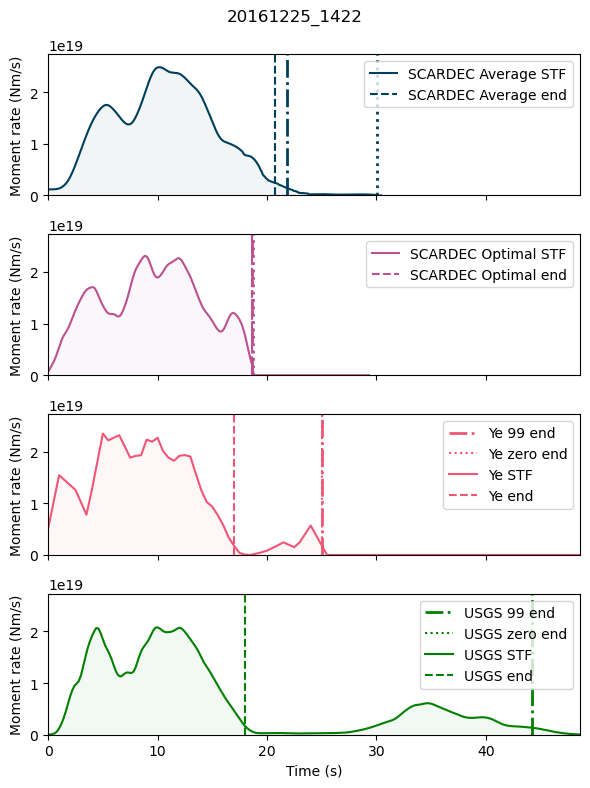

event                      20120930_1631
scardec    FCTs_20120930_163135_COLOMBIA
ye                                     0
isc                                    0
sigloch                                0
usgs                                   0
mag                                7.275
Name: 74, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
 260 261 262 263 264 265 266 267 268 269 270 271 272 273 274 275 276 277
 278 279 280 281 282 283 284 285 286 287 288 289 290 291 292 293 294 295
 296 297 298 299 300 301 302 303 304 305 306 307 308 309 310 311 312 313
 314 315 316]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47
 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63]
17
22.640625


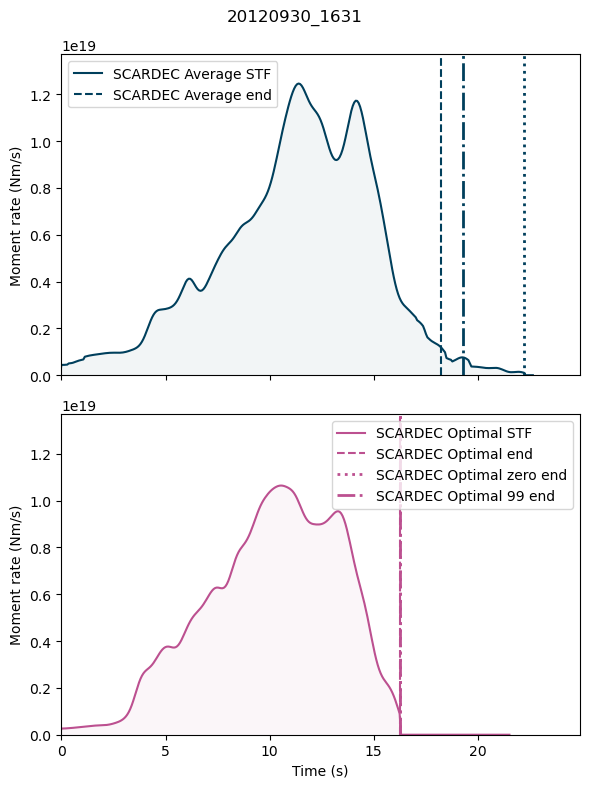

event                                    20100205_0659
scardec    FCTs_20100205_065905_SOUTHEAST_INDIAN_RIDGE
ye                                                   0
isc                                                  0
sigloch                                0435.2010.036.a
usgs                                                 0
mag                                             6.2535
Name: 80, dtype: object
1
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 155 156 157 158
 159 160 161 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176
 177 178 179 180 181 182 183 184 185 186 187 188 216 217 218 219 220 221
 222 223 224 225 226 227 228]
1
17
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  96  97  98  99 100 101 102 103 104 105 106 107 108 109
 110 111 112 113 114 115 116 117 118 119 12

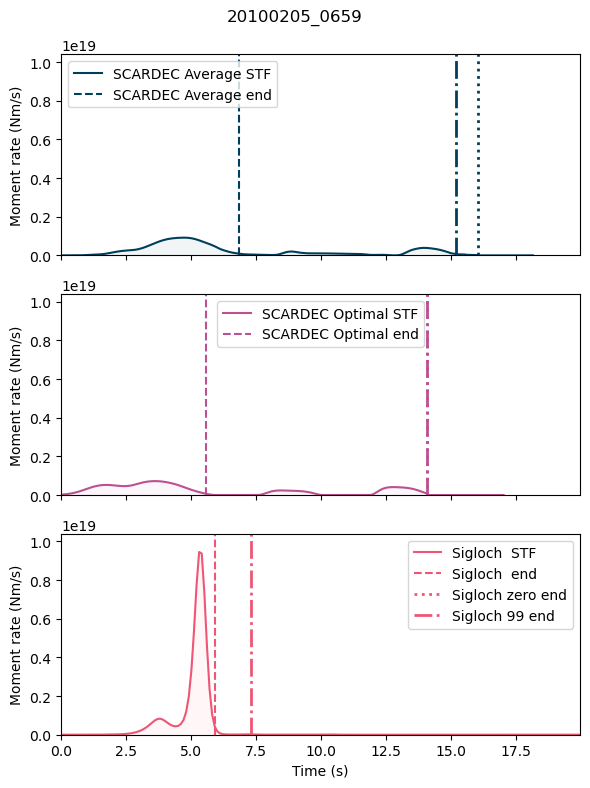

event                                        20070308_0503
scardec    FCTs_20070308_050332_SOUTHEAST_OF_HONSHU__JAPAN
ye                                                       0
isc                                                      0
sigloch                                                  0
usgs                                                     0
mag                                                 6.0075
Name: 95, dtype: object
5
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 67 68 69 70 71 72 73 74
 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89]
5
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18]
17
6.3984375


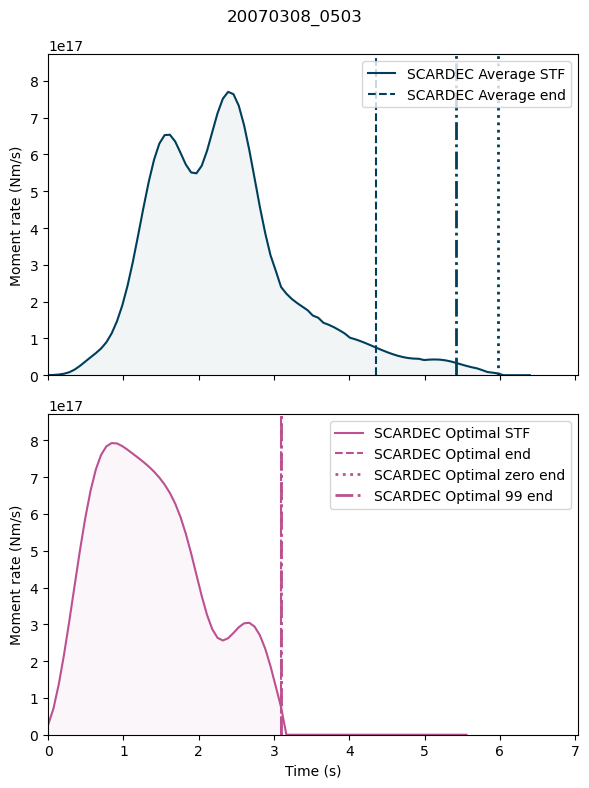

In [26]:
colors = ['#003f5c', '#bc5090', '#ef5675', 'g', 'c', 'm', 'k', 'y']
styles = ['--', '-.', ':', '--', '-.', ':', '--', '-.']
eventcount = 0
already_made = os.listdir('/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/both/')
for i, row in combined.iterrows():
    if row.event not in ['20070308_0503', '20080106_0514', '20120930_1631', '20161225_1422', '20100205_0659']:
        continue
    # if row.event != '20200623_1529':
    #     continue
    # if row.sigloch != '0706.2011.026.a':
    #     continue
    if i > 100:
        continue
    # if row.event + '.png' in already_made:
    #     continue
    lines_count = 0
    count = 0
    print(row)
    sources = 0
    for r in row[1:-1]:
        if r not in [0, '0']:
            sources += 1
    if row['scardec'] not in ['0', 0]:
        sources += 1

    max_end = 0
    y_max = 0
    max_end = 0

    fig, axs = plt.subplots(sources, 1, figsize=(6, 8), sharex = True)
    if sources == 1:
        axs = [axs]

    ends_different = False
    count_datasets = 0
    if row.scardec not in ['0', 0]:
        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctmoy')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Average', plot_bar = False)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Average 99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Average Zero end', linewidth = 2)
        max_end = max(max_end, max(time))
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1

        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctopt')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Optimal', plot_bar = False)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Optimal zero end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Optimal 99 end', linewidth = 2)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.ye not in ['0', 0]:
        momentrate, time = get_ye_stf(row['ye'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Ye 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Ye zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'Ye', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.usgs not in ['0', 0]:
        momentrate, time = get_usgs_stf(row['usgs'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'USGS 99 end', linewidth = 2)

        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'USGS zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'USGS', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.isc not in ['0', 0]:
        momentrate, time = load_isc(row['isc'])
        momentrate = momentrate[0]
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'ISC  99 end', linewidth = 2)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label =  'ISC zero end')
        axs[count] = plot_stf(axs[count], time, momentrate, detected_end_time, colors[lines_count], '--', label_str = 'ISC', plot_bar = False)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    if row.sigloch not in ['0', 0]:
        momentrate_list, time_list = get_sigloch_stf(row['sigloch'])
        for momentrate, time in zip(momentrate_list, time_list):
            momentrate = np.array(momentrate)
            y_max = max(y_max, 10**max(momentrate))
            time = np.arange(0, 25.6, 0.1)#np.array(time)
            detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(10**momentrate, time)
            time = time - detected_start_time # shift to start STF at zero
            detected_end_time = detected_end_time - detected_start_time
            #print(detected_end_time)
            max_end = max(detected_end_time, max_end)
            axs[count] = plot_stf(axs[count], time, 10**momentrate, detected_end_time, colors[lines_count], '--', label_str = 'Sigloch ', plot_bar = False)
            detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            #max_end = max(max_end, detected_zero_end_time)
            axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Sigloch zero end', linewidth = 2)
            detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            max_end = max(max_end, detected_99_end_time)
            axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Sigloch 99 end', linewidth = 2)
            count += 1
            if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
                ends_different = True
            lines_count += 1
        count_datasets += 1

    for ax in axs:
        ax.set_xlim(0, 1.1*max_end)
        ax.set_ylim(0, 1.1*y_max)
        ax.set_ylabel('Moment rate (Nm/s)')
    axs[-1].set_xlabel('Time (s)')
    if np.isnan(row.mag) is False:
        fig.suptitle(row.event + f' | Magnitude: {row.mag}')
    else:
        fig.suptitle(row.event)
    plt.legend()

    plt.tight_layout()

    plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/for_paper/{row.event}.png')
    # if count_datasets >= 2:
    #     if ends_different is True:
    #         plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/different/{row.event}.png')
    #     else:
    #         plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/same/{row.event}.png')
    #     # if row.isc not in ['0', 0]:
    # #     plt.show()
    #     break
    # else:
    #     plt.close()
    #     continue
    #axs[0].set_yscale('log')
    #plt.close()
    print(max_end)
    plt.show()






event                                       20111006_1112
scardec    FCTs_20111006_111230_SALTA_PROVINCE__ARGENTINA
ye                                                      0
isc                                                     0
sigloch                                   0129.2011.279.a
usgs                                                    0
mag                                                5.9175
Name: 15, dtype: object
sources 3
0
1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29 30 31 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75
 76 77]
1
17
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21]
17
2
2
2
2
0
[  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  50  51  52  53  54  55  56  57  58  59  60  61  75  76
  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94
  95  96  97  98  99 100

/tmp/ipykernel_438173/4235752371.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(sources, 1, figsize=(6, 2.5*sources), sharex = True)


event                           20101220_1841
scardec    FCTs_20101220_184159_SOUTHERN_IRAN
ye                                          0
isc                                         0
sigloch                       0353.2010.354.a
usgs                                        0
mag                                     6.729
Name: 496, dtype: object
sources 3
0
1
[  0   1   2   3   4   5   6   7   8 237 238 239 240 241 242 243 244 245
 246 247 248 290 291 292 293 294 295 296 297 298 299 300 301 302 303 304
 305 306 307 308 309 310 311 312 313 314 315 316 317 318 319 320 321 322
 323 324 325 326 327 328 329 330 331 332 333 334 335 336 337 338 339 340
 341 342 343 344 345 346 347 348 349 350 351 352 353 354 355 356 357 358
 359 360 361 362 363 364 365 366 367 368 369 370 371 372 373 374 375 376
 377 378 379 380 381 382 383 384 385 386 387 388 389 390 391 392 393 394
 395 396 397 398 399 400 401 402 403 404 525 526 527 528 529 530 531 532
 533 534 535 536 537 538 539 540 541 542 543 544 545 54

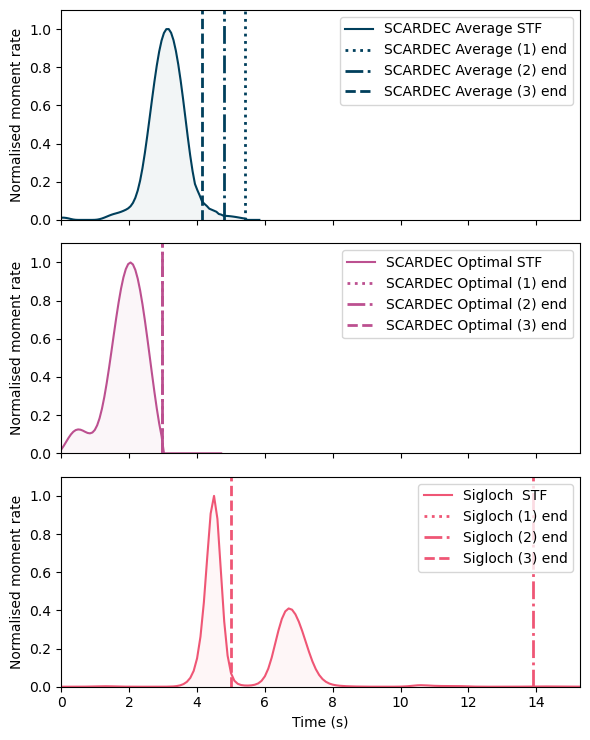

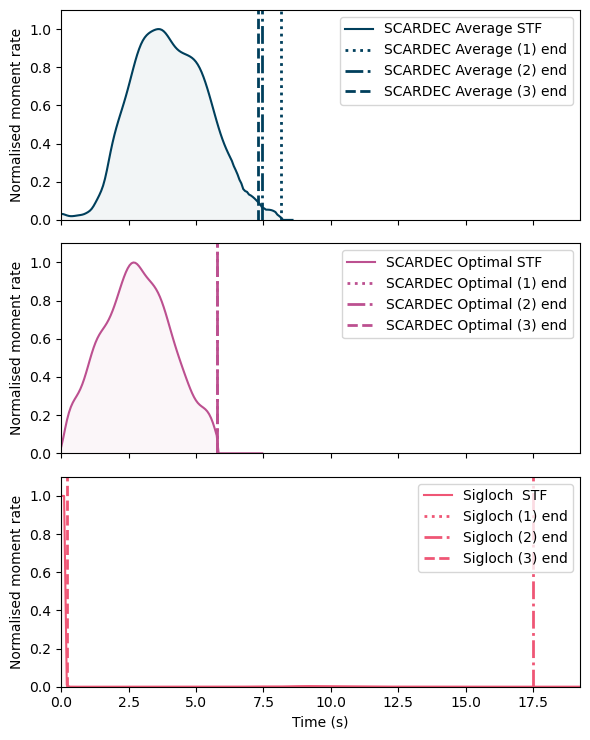

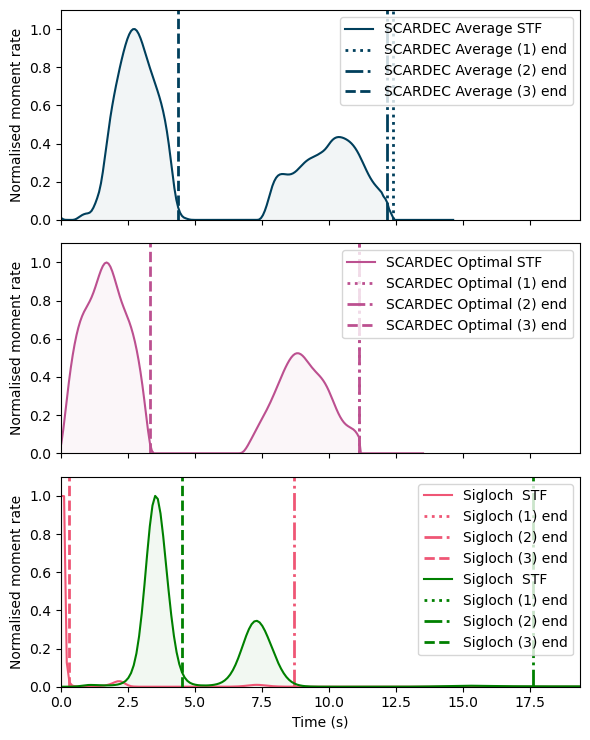

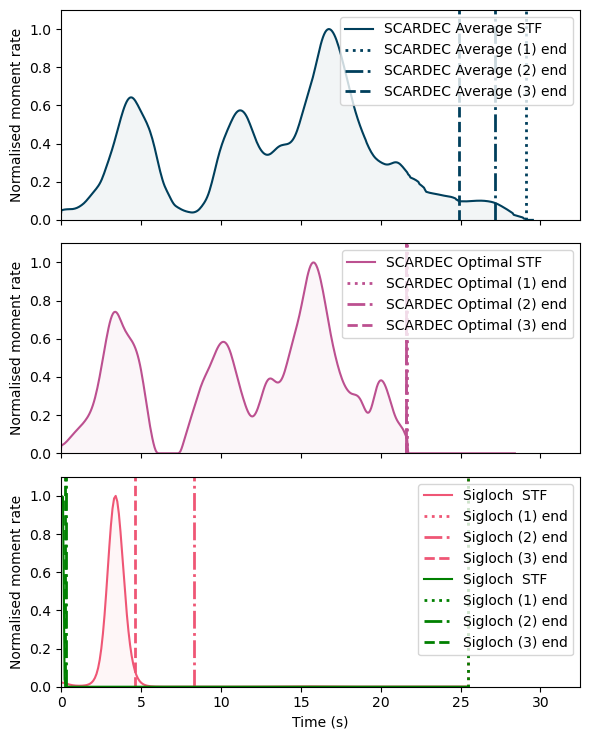

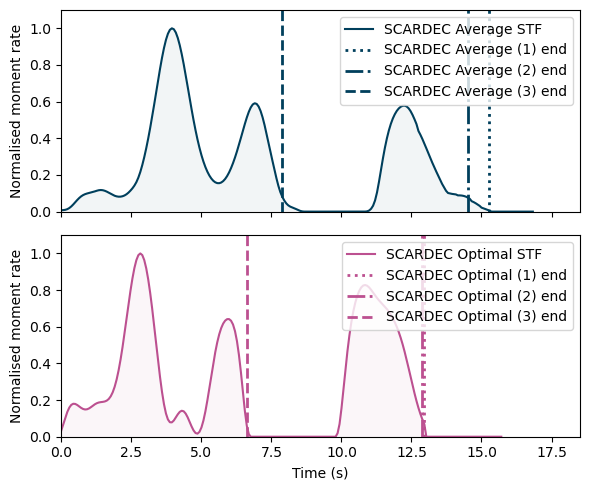

...

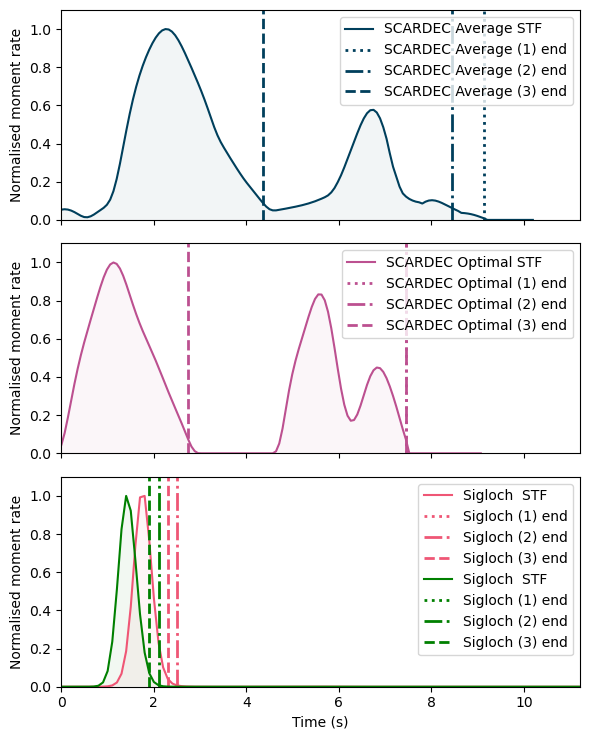

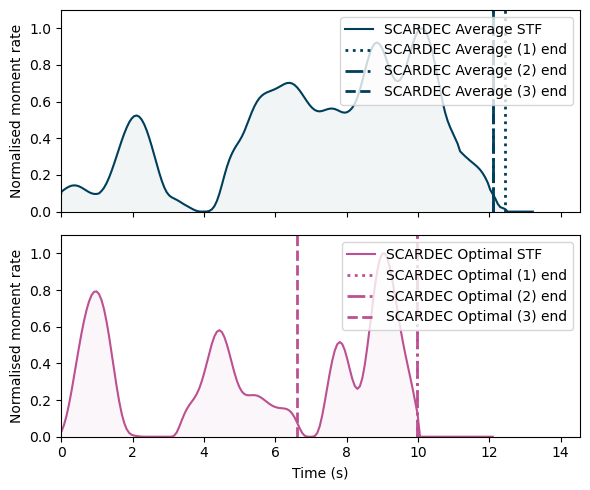

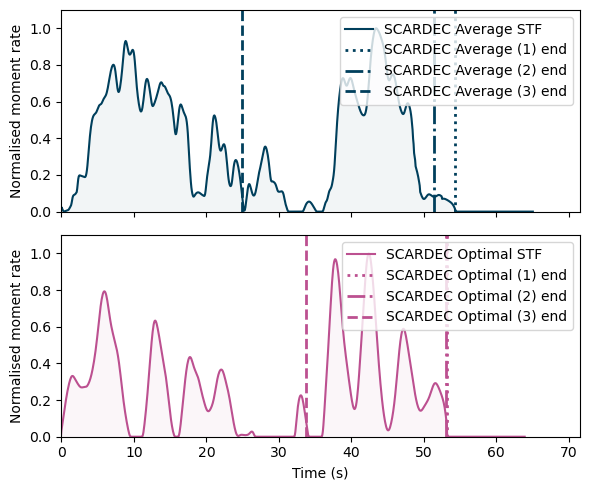

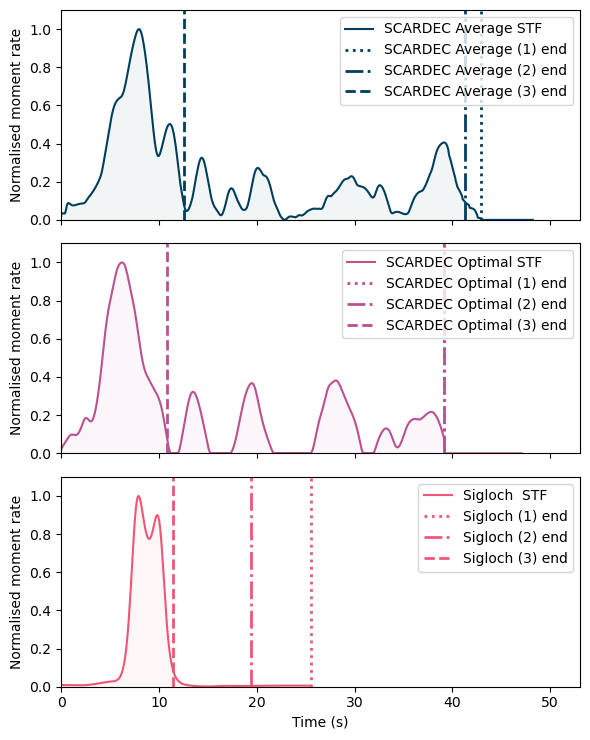

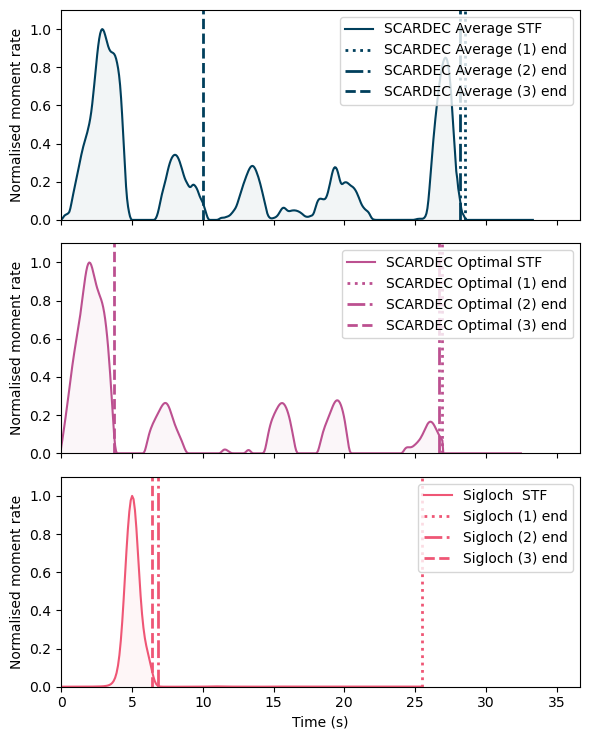

In [17]:
colors = ['#003f5c', '#bc5090', '#ef5675', 'g', 'c', 'm', 'k', 'y']
styles = ['--', '-.', ':', '--', '-.', ':', '--', '-.']
eventcount = 0
already_made = os.listdir('/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/both/')
for i, row in combined.iterrows():
    # if row.event not in ['20070308_0503', '20080106_0514', '20120930_1631', '20161225_1422', '20100205_0659']:
    #     continue
    if row.event not in ['20111006_1112', '20150918_1559', '20030106_2343', '20050119_0611', '20220926_0959', '20210218_1530', '20210218_1530', '19950625_0210', '19930712_1317', '20050124_0416', '20210616_0443', '20210616_0443', '20140401_2346', '20141113_1024', '20181021_0140', '20071226_2204', '19970706_2013', '19970706_2013', '20190714_0910', '20190714_0910', '19920626_1132', '20151108_1647', '20021010_1050', '20021010_1050', '20190126_0812', '19970808_2227', '19970808_2227', '20101220_1841', '19950529_0729', '20020326_0345', '20110319_0122', '20060815_0305', '20060815_0305', '20030628_1529', '20010614_2331', '20141028_0315', '20141028_0315', '19920720_0746', '19970728_0646', '20080419_0312', '20010704_1747', '20150524_1438', '20150524_1438', '19961209_1128', '19961209_1128', '19940603_2106', '19940603_2106', '20181205_0418', '20110113_1616', '20110113_1616', '20030127_1756', '20060506_1826', '20060506_1826', '20000828_1505', '20140310_0518', '20140310_0518', '20160607_1915', '20020219_0035', '20020219_0035', '20110716_0703', '20140513_0635', '20070902_0105', '20070902_0105', '19950210_0145', '20130915_1621', '20181115_2002', '20150919_0506', '20131004_1726', '20131004_1726', '20131004_1726', '20120605_1931', '20080416_0554', '20050516_0354', '20040909_1633', '19990401_2136', '19941008_2144', '19941008_2144', '19960905_0814', '19960905_0814', '20110331_0011', '20130726_2132', '20180829_0351', '20180829_0351', '19940121_0224', '20121030_0249', '20121030_0249', '20140121_0129', '20070706_0109', '20061112_1821', '20060519_1444', '20040103_1623', '20040103_1623', '20120604_0315', '20120604_0315', '20081107_1604', '20081107_1604', '19940818_0442', '19940818_0442', '19950708_1715', '19950708_1715', '20220330_2056', '20220330_2056', '20210803_2033', '19961009_1310', '20010823_2145', '20010823_2145', '20220110_0006', '20200107_0824', '19950807_1944', '20111129_0030', '20030811_2122', '20030811_2122', '20040818_0903', '20100218_0113', '20140903_2033', '20140903_2033', '20130715_1403', '20120417_1903', '20120417_1903', '20101229_0654', '20101229_0654', '19920406_1354', '20080822_0747', '20050411_1220', '20100720_1719', '20100413_2349', '20090912_2006', '20090912_2006', '20160415_1411', '20160415_1411', '20080728_2137', '20020115_0712', '20050512_1115', '19981105_1805', '20090818_1750', '20001121_1733', '20210816_1110', '20210816_1110', '19950417_0114', '19950417_0114', '20140321_1341', '20140321_1341', '20030930_1408', '20060331_0117', '20110510_0855', '20110510_0855', '20130210_1839', '20130210_1839', '20140418_1427', '20001220_1649', '20081023_1004', '20170827_0417', '20170827_0417', '20081114_0205', '20130209_2102', '20130209_2102', '20090715_2010', '20020305_2116', '19981019_0125', '19990213_1445', '20001107_0018', '20001107_0018', '20050521_0511', '20050521_0511', '20040111_0432', '20010217_2011', '20140424_0310', '20001005_1339', '20060331_1321', '19950219_0403', '19950219_0403', '20060507_1417', '20040719_0801', '20110731_2338', '20130817_1632', '20120830_1343', '20100127_1742', '20100127_1742', '20060719_1057', '19950514_1133', '19950514_1133', '20080828_1237', '20011019_0328', '20000606_2116', '20031001_0103', '20110914_1810', '20161221_1643', '20080303_1349', '20160623_2105', '20010228_1230', '20110922_2307', '20060306_1813', '19981028_1625', '20190905_1502', '20120818_1531', '19990222_0100', '19980810_0952', '20050519_0154', '19930630_2347', '20040513_0958', '20140524_0925', '20031210_0438', '19950308_0345', '19920802_0550', '19920802_0550', '20131024_1925', '20050101_1908', '20101126_1736', '20080409_1113', '20000506_1344', '20000506_1344', '20081122_1601', '20070317_1742', '19940604_0057', '20110317_0248', '20081213_0845', '20150601_2011', '20050407_1943', '20170719_1216', '20130422_0116', '20120903_0649', '19960723_0332', '19960723_0332', '20081002_2328', '20081002_2328', '20121012_0031', '20121012_0031', '20100718_0556', '20000504_2036', '20000504_2036', '20211125_1204', '20211125_1204', '20011203_1132', '19940901_1515', '19980624_1044', '19980624_1044', '20030508_2022', '20200417_1630', '19930120_1731', '20120827_0437', '19940314_0430', '20210123_2336', '20041102_1002', '20021115_1958', '19970421_1202', '20110214_0340', '20191016_1137', '20071220_0755', '20080419_0558', '20080419_0558', '20050116_2017', '20120421_0116', '20050615_1952', '19921108_0343', '20000521_1958', '20110411_0816', '20120316_0758', '19990829_0046', '20130430_0625', '19991130_1623', '20000809_2255', '20170711_0700', '19920628_1157', '19920628_1157', '20141009_0214', '20000108_0119', '20000108_0119', '20181206_2326', '20061230_0830', '20061230_0830', '20040729_0144', '20040729_0144', '19930525_2316', '20090528_0824', '20090528_0824', '20130207_1859', '20130207_1859', '20181224_1241', '20110312_1253', '19920710_0931', '20150716_1516', '20150716_1516', '20070624_0025', '19941013_0504', '20110505_1458', '20061226_1234', '20150507_0710', '19990329_0617', '19990329_0617', '20161209_1910', '20161209_1910', '20040507_0126', '20051213_0316', '20051213_0316', '20000602_1113', '20150417_1552', '20031226_2126', '20160621_1626', '20040529_2056', '20171110_1201', '19970228_1257', '20060522_1112', '20170210_1403', '19931126_2320', '19931126_2320', '20140806_1145', '19950421_0517', '20100824_0211', '20150530_1718', '20120326_1812', '20110820_1713', '20140624_0315', '20140410_2327', '20080302_0511', '20060324_1746', '20080830_0830', '20120204_0740', '20100112_2200', '20100616_0358', '20020215_0146', '20140518_2347', '20010915_1504', '20120121_1847', '20060426_0146', '20080312_1136', '20110709_1354', '20150901_1525', '20050704_1136', '20121014_0458', '20130228_1807', '20090101_0627', '20140205_2052', '20000407_1908', '20110317_0413', '20110916_2136', '19991208_1334', '20110317_0803', '20110510_1024', '20101020_0409', '20180201_1105', '20100405_1005', '20121207_0831', '20110624_0633', '20140506_2052', '20080407_2254', '20131006_2133', '20161017_0714', '20080719_1101', '20100911_1143', '20010218_1304', '20070221_1105', '20120226_0521', '20040928_1715', '20091126_1908', '20110311_2011', '20080729_2056', '20111107_1651', '19960818_0716', '20090923_0259', '20100414_0125', '20110721_2301', '20110721_2301', '20130206_1103', '20151224_1944', '20120420_2314', '20131117_0904', '20051113_1025', '20080821_1224', '20121129_1110', '20120816_1324', '20050410_1724', '20090404_0719', '20140709_1758', '20080101_1913', '20080101_1913', '20141224_0158', '20050124_2323', '20100127_1849', '20100505_0938', '20101103_1118', '20130402_1613', '20151219_0210', '20151219_0210', '20111214_0048', '20111214_0048', '20150810_0424']:
        continue
    # if row.event != '20200623_1529':
    #     continue
    # if row.sigloch != '0706.2011.026.a':
    #     continue
    if i > 1000:
        continue
    # if row.event + '.png' in already_made:
    #     continue
    lines_count = 0
    count = 0
    print(row)
    sources = 0
    for r in row[1:-1]:
        if r not in [0, '0']:
            sources += 1
    if row['scardec'] not in ['0', 0]:
        sources += 1

    max_end = 0
    y_max = 0
    max_end = 0
    if sources < 4:
        fig, axs = plt.subplots(sources, 1, figsize=(6, 2.5*sources), sharex = True)
    else:
        fig, axs = plt.subplots(sources, 1, figsize=(6, 8), sharex = True)
    if sources == 1:
        axs = [axs]
    print('sources', sources)

    ends_different = False
    count_datasets = 0
    print(count)
    if row.scardec not in ['0', 0]:
        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctmoy')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Average', plot_bar = False)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Average (1) end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Average (2) end', linewidth = 2)
        axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'SCARDEC Average (3) end', linewidth = 2)
        max_end = max(max_end, max(time))
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1

        momentrate, time = get_scardec_stf(row['scardec'], wanted_type = 'fctopt')
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'SCARDEC Optimal', plot_bar = False)
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'SCARDEC Optimal (1) end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'SCARDEC Optimal (2) end', linewidth = 2)
        axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'SCARDEC Optimal (3) end', linewidth = 2)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    print(count)
    if row.ye not in ['0', 0]:
        momentrate, time = get_ye_stf(row['ye'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'Ye', plot_bar = False)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Ye (1) end', linewidth = 2)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Ye (2) end', linewidth = 2)
        axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'Ye (3) end', linewidth = 2)

        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    print(count)
    if row.usgs not in ['0', 0]:
        momentrate, time = get_usgs_stf(row['usgs'])
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'USGS', plot_bar = False)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'USGS (1) end', linewidth = 2)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'USGS (2) end', linewidth = 2)
        axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'USGS (3) end', linewidth = 2)

        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    print(count)
    if row.isc not in ['0', 0]:
        momentrate, time = load_isc(row['isc'])
        momentrate = momentrate[0]
        detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(momentrate, time)
        time = time - detected_start_time # shift to start STF at zero
        detected_end_time = detected_end_time - detected_start_time
        detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(momentrate, time)
        axs[count] = plot_stf(axs[count], time, momentrate/max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'ISC', plot_bar = False)
        axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label =  'ISC (1) end', linewidth = 2)
        detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(momentrate, time)
        axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'ISC (2) end', linewidth = 2)
        axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'ISC (3) end', linewidth = 2)
        max_end = max(max_end, detected_end_time)
        #max_end = max(max_end, detected_zero_end_time)
        max_end = max(max_end, detected_99_end_time)
        y_max = max(y_max, max(momentrate))
        lines_count += 1
        count += 1
        if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
            ends_different = True
        count_datasets += 1
    print(count)
    if row.sigloch not in ['0', 0]:
        momentrate_list, time_list = get_sigloch_stf(row['sigloch'])
        for momentrate, time in zip(momentrate_list, time_list):
            momentrate = np.array(momentrate)
            y_max = max(y_max, 10**max(momentrate))
            time = np.arange(0, 25.6, 0.1)#np.array(time)
            detected_end_time, detected_end, detected_start_time, detected_start = find_end_stf(10**momentrate, time)
            time = time - detected_start_time # shift to start STF at zero
            detected_end_time = detected_end_time - detected_start_time
            #print(detected_end_time)
            max_end = max(detected_end_time, max_end)
            axs[count] = plot_stf(axs[count], time, 10**momentrate/10**max(momentrate), detected_end_time, colors[lines_count], '--', label_str = 'Sigloch ', plot_bar = False)
            detected_zero_end_time, detected_zero_end, detected_zero_start_time, detected_zero_start = find_zero_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            #max_end = max(max_end, detected_zero_end_time)
            axs[count].axvline(detected_zero_end_time, color=colors[lines_count], linestyle=':', label = 'Sigloch (1) end', linewidth = 2)
            detected_99_end_time, detected_99_end, detected_99_start_time, detected_99_start = find_99_end_stf(10**momentrate, time)
            #print(detected_zero_end_time)
            max_end = max(max_end, detected_99_end_time)
            axs[count].axvline(detected_99_end_time, color=colors[lines_count], linestyle='-.', label = 'Sigloch (2) end', linewidth = 2)
            axs[count].axvline(detected_end_time, color=colors[lines_count], linestyle='--', label = 'Sigloch (3) end', linewidth = 2)
            
            if 0.9 * detected_99_end_time < detected_end_time < 1.1 * detected_99_end_time:
                ends_different = True
            lines_count += 1
        count += 1
        count_datasets += 1

    for ax in axs:
        ax.set_xlim(0, 1.1*max_end)
        ax.set_ylim(0, 1.1)#*y_max)
        ax.legend(loc='upper right')
        ax.set_ylabel('Normalised moment rate')
    axs[-1].set_xlabel('Time (s)')
    # if np.isnan(row.mag) is False:
    #     fig.suptitle(row.event + f' | Magnitude: {row.mag}')
    # else:
    #     fig.suptitle(row.event)
    #plt.legend()

    plt.tight_layout()

    plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/for_paper/early_end/{row.event}_norm.png', bbox_inches='tight')
    # if count_datasets >= 2:
    #     if ends_different is True:
    #         plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/different/{row.event}.png')
    #     else:
    #         plt.savefig(f'/home/earthquakes1/homes/Rebecca/phd/stf/figures/ends/all_on_one/end_comparisons/same/{row.event}.png')
    #     # if row.isc not in ['0', 0]:
    # #     plt.show()
    #     break
    # else:
    #     plt.close()
    #     continue
    #axs[0].set_yscale('log')
    #plt.close()
    #print(max_end)
    #plt.show()




